# Assignment 1: Bandits and Exploration/Exploitation

Welcome to Assignment 1. This notebook will:
- Help you create your first bandit algorithm
- Help you understand the effect of epsilon on exploration and learn about the exploration/exploitation tradeoff
- Introduce you to some of the reinforcement learning software we are going to use for this specialization

This class uses RL-Glue to implement most of our experiments. It was originally designed by Adam White, Brian Tanner, and Rich Sutton. This library will give you a solid framework to understand how reinforcement learning experiments work and how to run your own. If it feels a little confusing at first, don't worry - we are going to walk you through it slowly and introduce you to more and more parts as you progress through the specialization.

We are assuming that you have used a Jupyter notebook before. But if not, it is quite simple. Simply press the run button, or shift+enter to run each of the cells. The places in the code that you need to fill in will be clearly marked for you.

## Section 0: Preliminaries

In [1]:
# Import necessary libraries
%matplotlib inline
import numpy as np
import matplotlib.pyplot as plt
from tqdm import tqdm
import time

from rlglue.rl_glue import RLGlue
import main_agent
import ten_arm_env
import test_env

In the above cell, we import the libraries we need for this assignment. We use numpy throughout the course and occasionally provide hints for which methods to use in numpy. Other than that we mostly use vanilla python and the occasional other library, such as matplotlib for making plots.

You might have noticed that we import ten_arm_env. This is the __10-armed Testbed__ introduced in [section 2.3](http://www.incompleteideas.net/book/RLbook2018.pdf) of the textbook. We use this throughout this notebook to test our bandit agents. It has 10 arms, which are the actions the agent can take. Pulling an arm generates a stochastic reward from a Gaussian distribution with unit-variance. For each action, the expected value of that action is randomly sampled from a normal distribution, at the start of each run. If you are unfamiliar with the 10-armed Testbed please review it in the textbook before continuing.

__DO NOT IMPORT OTHER LIBRARIES as this will break the autograder.__

__DO NOT SET A RANDOM SEED as this will break the autograder.__

## Section 1: Greedy Agent

We want to create an agent that will find the action with the highest expected reward. One way an agent could operate is to always choose the action with  the highest value based on the agent’s current estimates. This is called a greedy agent as it greedily chooses the action that it thinks has the highest value. Let's look at what happens in this case.

First we are going to implement the argmax function, which takes in a list of action values and returns an action with the highest value. Why are we implementing our own instead of using the argmax function that numpy uses? Numpy's argmax function returns the first instance of the highest value. We do not want that to happen as it biases the agent to choose a specific action in the case of ties. Instead we want to break ties between the highest values randomly. So we are going to implement our own argmax function. You may want to look at [np.random.choice](https://docs.scipy.org/doc/numpy/reference/generated/numpy.random.choice.html) to randomly select from a list of values.

In [229]:
# -----------
# Graded Cell
# -----------
def argmax(q_values):
    """
    Takes in a list of q_values and returns the index of the item 
    with the highest value. Breaks ties randomly.
    returns: int - the index of the highest value in q_values
    
    Because the argmax function returns the first instance of the 
    highest value, this is why we need to record all top value index
    and randomly choice one
    """
    top_value = float("-inf")
    ties = []
    for i in range(len(q_values)):
        # if a value in q_values is greater than the highest value update top and reset ties to zero
        # if a value is equal to top value add the index to ties
        # return a random selection from ties.
        if q_values[i] > top_value:
            top_value = q_values[i]
            ties=[]
        if q_values[i] == top_value:
            ties.append(i)
        #raise NotImplementedError()
    return np.random.choice(ties)

In [76]:
# --------------
# Debugging Cell
# --------------
# Feel free to make any changes to this cell to debug your code

test_array = [0, 0, 0, 0, 0, 0, 0, 0, 1, 0]
assert argmax(test_array) == 8, "Check your argmax implementation returns the index of the largest value"

# make sure np.random.choice is called correctly
np.random.seed(0)
test_array = [1, 0, 0, 1]

assert argmax(test_array) == 0

[8]
[0, 3]


In [72]:
# -----------
# Tested Cell
# -----------
# The contents of the cell will be tested by the autograder.
# If they do not pass here, they will not pass there.

test_array = [0, 0, 0, 0, 0, 0, 0, 0, 1, 0]
assert argmax(test_array) == 8, "Check your argmax implementation returns the index of the largest value"

# set random seed so results are deterministic
np.random.seed(0)
test_array = [1, 0, 0, 1]

counts = [0, 0, 0, 0]
for _ in range(100):
    a = argmax(test_array)
    counts[a] += 1

# make sure argmax does not always choose first entry
assert counts[0] != 100, "Make sure your argmax implementation randomly choooses among the largest values."

# make sure argmax does not always choose last entry
assert counts[3] != 100, "Make sure your argmax implementation randomly choooses among the largest values."

# make sure the random number generator is called exactly once whenver `argmax` is called
expected = [44, 0, 0, 56] # <-- notice not perfectly uniform due to randomness
assert counts == expected

Now we introduce the first part of an RL-Glue agent that you will implement. Here we are going to create a GreedyAgent and implement the agent_step method. This method gets called each time the agent takes a step. The method has to return the action selected by the agent. This method also ensures the agent’s estimates are updated based on the signals it gets from the environment.

Fill in the code below to implement a greedy agent.

In [218]:
# -----------
# Graded Cell
# -----------
class GreedyAgent(main_agent.Agent):
    def agent_step(self, reward, observation):
        """
        Takes one step for the agent. It takes in a reward and observation and 
        returns the action the agent chooses at that time step.
        
        Arguments:
        reward -- float, the reward the agent recieved from the environment after taking the last action.
        observation -- float, the observed state the agent is in. Do not worry about this as you will not use it
                              until future lessons
        Returns:
        current_action -- int, the action chosen by the agent at the current time step.
        """
        ### Useful Class Variables ###
        # self.q_values : An array with what the agent believes each of the values of the arm are.
        # self.arm_count : An array with a count of the number of times each arm has been pulled.
        # self.last_action : The action that the agent took on the previous time step
        #######################
        
        # Update Q values Hint: Look at the algorithm in section 2.4 of the textbook.
        # increment the counter in self.arm_count for the action from the previous time step
        # update the step size using self.arm_count
        # update self.q_values for the action from the previous time step
        
        # YOUR CODE HERE
        self.arm_count[self.last_action] += 1
        #raise NotImplementedError()
 
        # Use the argmax function you created above
        # YOUR CODE HERE
        current_action = argmax(self.q_values)
        #raise NotImplementedError()
        
        step_size = 1 / self.arm_count[self.last_action]
        
        self.q_values[self.last_action] = self.q_values[self.last_action] + step_size * (reward - self.q_values[self.last_action])
        
        self.last_action = current_action
        
        return current_action
        

In [128]:
# --------------
# Debugging Cell
# --------------
# Feel free to make any changes to this cell to debug your code

# build a fake agent for testing and set some initial conditions
np.random.seed(1)
greedy_agent = GreedyAgent()
greedy_agent.q_values = [0, 0, 0.5, 0, 0]
greedy_agent.arm_count = [0, 1, 0, 0, 0]
greedy_agent.last_action = 1

action = greedy_agent.agent_step(reward=1, observation=0)

# make sure the q_values were updated correctly
assert greedy_agent.q_values == [0, 0.5, 0.5, 0, 0]

# make sure the agent is using the argmax that breaks ties randomly
assert action == 2

[2]
[0, 0.5, 0.5, 0, 0]


In [129]:
# lock
# -----------
# Tested Cell
# -----------
# The contents of the cell will be tested by the autograder.
# If they do not pass here, they will not pass there.

# build a fake agent for testing and set some initial conditions
greedy_agent = GreedyAgent()
greedy_agent.q_values = [0, 0, 1.0, 0, 0]
greedy_agent.arm_count = [0, 1, 0, 0, 0]
greedy_agent.last_action = 1

# take a fake agent step
action = greedy_agent.agent_step(reward=1, observation=0)

# make sure agent took greedy action
assert action == 2

# make sure q_values were updated correctly
assert greedy_agent.q_values == [0, 0.5, 1.0, 0, 0]

[2]
[0, 0.5, 1.0, 0, 0]


Let's visualize the result. Here we run an experiment using RL-Glue to test our agent. For now, we will set up the experiment code; in future lessons, we will walk you through running experiments so that you can create your own.

  0%|          | 0/200 [00:00<?, ?it/s]

[0, 1, 2, 3, 4, 5, 6, 7, 8, 9]
[0.         0.         0.         0.         0.         0.
 0.86241535 0.         0.         0.        ]
[6]
[0.         0.88351829 0.         0.         0.         0.
 0.86241535 0.         0.         0.        ]
[1]
[0.         0.88351829 0.         0.         0.         0.
 1.05307709 0.         0.         0.        ]
[6]
[0.         0.90746314 0.         0.         0.         0.
 1.05307709 0.         0.         0.        ]
[6]
[0.         0.90746314 0.         0.         0.         0.
 0.99616284 0.         0.         0.        ]
[6]
[0.         0.90746314 0.         0.         0.         0.
 1.22351788 0.         0.         0.        ]
[6]
[0.         0.90746314 0.         0.         0.         0.
 1.13096057 0.         0.         0.        ]
[6]
[0.         0.90746314 0.         0.         0.         0.
 1.14275134 0.         0.         0.        ]
[6]
[0.         0.90746314 0.         0.         0.         0.
 1.01459384 0.         0.         0.  

  0%|          | 1/200 [00:00<01:30,  2.20it/s]


[6]
[0.         0.85803    0.         0.         0.         0.
 0.87668962 0.         0.         0.        ]
[6]
[0.         0.85803    0.         0.         0.         0.
 0.87455975 0.         0.         0.        ]
[6]
[0.        0.85803   0.        0.        0.        0.        0.8734596
 0.        0.        0.       ]
[6]
[0.         0.85803    0.         0.         0.         0.
 0.87329958 0.         0.         0.        ]
[6]
[0.         0.85803    0.         0.         0.         0.
 0.87195487 0.         0.         0.        ]
[6]
[0.         0.85803    0.         0.         0.         0.
 0.87223475 0.         0.         0.        ]
[6]
[0.         0.85803    0.         0.         0.         0.
 0.87030906 0.         0.         0.        ]
[6]
[0.         0.85803    0.         0.         0.         0.
 0.87065959 0.         0.         0.        ]
[6]
[0.         0.85803    0.         0.         0.         0.
 0.87229597 0.         0.         0.        ]
[6]
[0.       0.8580

  1%|          | 2/200 [00:00<01:33,  2.11it/s]

[ 0.          0.09521745 -0.61627584  0.          0.          0.
  0.          0.          0.2824211   0.        ]
[8]
[ 0.          0.09521745 -0.61627584  0.          0.          0.
  0.          0.          0.28017142  0.        ]
[8]
[ 0.          0.09521745 -0.61627584  0.          0.          0.
  0.          0.          0.28280159  0.        ]
[8]
[ 0.          0.09521745 -0.61627584  0.          0.          0.
  0.          0.          0.28151262  0.        ]
[8]
[ 0.          0.09521745 -0.61627584  0.          0.          0.
  0.          0.          0.27902545  0.        ]
[8]
[ 0.          0.09521745 -0.61627584  0.          0.          0.
  0.          0.          0.27985119  0.        ]
[8]
[ 0.          0.09521745 -0.61627584  0.          0.          0.
  0.          0.          0.28045909  0.        ]
[8]
[ 0.          0.09521745 -0.61627584  0.          0.          0.
  0.          0.          0.27789541  0.        ]
[8]
[ 0.          0.09521745 -0.61627584  0.        

  2%|▏         | 3/200 [00:01<01:34,  2.08it/s]


[3]
[ 0.          0.          0.          1.56967162 -2.30450943  0.
  0.          0.          0.          0.        ]
[3]
[ 0.          0.          0.          1.56912669 -2.30450943  0.
  0.          0.          0.          0.        ]
[3]
[ 0.          0.          0.          1.57177181 -2.30450943  0.
  0.          0.          0.          0.        ]
[3]
[ 0.          0.          0.          1.57021779 -2.30450943  0.
  0.          0.          0.          0.        ]
[3]
[ 0.          0.          0.          1.56985815 -2.30450943  0.
  0.          0.          0.          0.        ]
[3]
[ 0.          0.          0.          1.56676963 -2.30450943  0.
  0.          0.          0.          0.        ]
[3]
[ 0.          0.          0.          1.56416916 -2.30450943  0.
  0.          0.          0.          0.        ]
[3]
[ 0.          0.          0.          1.56583496 -2.30450943  0.
  0.          0.          0.          0.        ]
[3]
[ 0.          0.          0.          1.568

  2%|▏         | 4/200 [00:01<01:37,  2.02it/s]


[0]
[ 1.75712894 -0.01528595 -0.28469445 -0.41050783 -0.40599978 -0.08451409
 -0.02535002 -0.06813175 -0.65481819 -0.10851684]
[0]
[ 1.75997712 -0.01528595 -0.28469445 -0.41050783 -0.40599978 -0.08451409
 -0.02535002 -0.06813175 -0.65481819 -0.10851684]
[0]
[ 1.75945028 -0.01528595 -0.28469445 -0.41050783 -0.40599978 -0.08451409
 -0.02535002 -0.06813175 -0.65481819 -0.10851684]
[0]
[ 1.75993754 -0.01528595 -0.28469445 -0.41050783 -0.40599978 -0.08451409
 -0.02535002 -0.06813175 -0.65481819 -0.10851684]
[0]
[ 1.75924054 -0.01528595 -0.28469445 -0.41050783 -0.40599978 -0.08451409
 -0.02535002 -0.06813175 -0.65481819 -0.10851684]
[0]
[ 1.76156967 -0.01528595 -0.28469445 -0.41050783 -0.40599978 -0.08451409
 -0.02535002 -0.06813175 -0.65481819 -0.10851684]
[0]
[ 1.76045745 -0.01528595 -0.28469445 -0.41050783 -0.40599978 -0.08451409
 -0.02535002 -0.06813175 -0.65481819 -0.10851684]
[0]
[ 1.76072262 -0.01528595 -0.28469445 -0.41050783 -0.40599978 -0.08451409
 -0.02535002 -0.06813175 -0.65481

  2%|▎         | 5/200 [00:02<01:34,  2.06it/s]


[7]
[ 0.         -0.00234395  0.          0.          0.         -0.44045811
 -2.10802941  0.60804645  0.         -0.40887479]
[7]
[ 0.         -0.00234395  0.          0.          0.         -0.44045811
 -2.10802941  0.60998587  0.         -0.40887479]
[7]
[ 0.         -0.00234395  0.          0.          0.         -0.44045811
 -2.10802941  0.61066234  0.         -0.40887479]
[7]
[ 0.         -0.00234395  0.          0.          0.         -0.44045811
 -2.10802941  0.61069199  0.         -0.40887479]
[7]
[ 0.         -0.00234395  0.          0.          0.         -0.44045811
 -2.10802941  0.61088918  0.         -0.40887479]
[7]
[ 0.         -0.00234395  0.          0.          0.         -0.44045811
 -2.10802941  0.61239112  0.         -0.40887479]
[7]
[ 0.         -0.00234395  0.          0.          0.         -0.44045811
 -2.10802941  0.6097682   0.         -0.40887479]
[7]
[ 0.         -0.00234395  0.          0.          0.         -0.44045811
 -2.10802941  0.61080225  0.     

  3%|▎         | 6/200 [00:02<01:33,  2.07it/s]

[ 0.         -0.6896991   2.45822827  0.          0.          0.
  0.          0.          0.          0.        ]
[2]
[ 0.         -0.6896991   2.45874345  0.          0.          0.
  0.          0.          0.          0.        ]
[2]
[ 0.         -0.6896991   2.45978437  0.          0.          0.
  0.          0.          0.          0.        ]
[2]
[ 0.         -0.6896991   2.45971086  0.          0.          0.
  0.          0.          0.          0.        ]
[2]
[ 0.         -0.6896991   2.46086622  0.          0.          0.
  0.          0.          0.          0.        ]
[2]
[ 0.         -0.6896991   2.46195916  0.          0.          0.
  0.          0.          0.          0.        ]
[2]
[ 0.         -0.6896991   2.46194137  0.          0.          0.
  0.          0.          0.          0.        ]
[2]
[ 0.         -0.6896991   2.46162186  0.          0.          0.
  0.          0.          0.          0.        ]
[2]
[ 0.        -0.6896991  2.460506   0.         0.

  4%|▎         | 7/200 [00:03<01:34,  2.05it/s]


[5]
[ 0.          0.          0.         -0.08640827 -0.63764272  0.94100446
  0.         -0.16281003  0.         -0.22302449]
[5]
[ 0.          0.          0.         -0.08640827 -0.63764272  0.94014982
  0.         -0.16281003  0.         -0.22302449]
[5]
[ 0.          0.          0.         -0.08640827 -0.63764272  0.93961348
  0.         -0.16281003  0.         -0.22302449]
[5]
[ 0.          0.          0.         -0.08640827 -0.63764272  0.93871631
  0.         -0.16281003  0.         -0.22302449]
[5]
[ 0.          0.          0.         -0.08640827 -0.63764272  0.93897376
  0.         -0.16281003  0.         -0.22302449]
[5]
[ 0.          0.          0.         -0.08640827 -0.63764272  0.94140062
  0.         -0.16281003  0.         -0.22302449]
[5]
[ 0.          0.          0.         -0.08640827 -0.63764272  0.94042087
  0.         -0.16281003  0.         -0.22302449]
[5]
[ 0.          0.          0.         -0.08640827 -0.63764272  0.94018749
  0.         -0.16281003  0.     

  4%|▍         | 8/200 [00:03<01:32,  2.07it/s]


[0]
[1.67169984 0.         0.         0.03663935 0.         0.
 0.         0.         0.         0.        ]
[0]
[1.67424456 0.         0.         0.03663935 0.         0.
 0.         0.         0.         0.        ]
[0]
[1.67470515 0.         0.         0.03663935 0.         0.
 0.         0.         0.         0.        ]
[0]
[1.67392357 0.         0.         0.03663935 0.         0.
 0.         0.         0.         0.        ]
[0]
[1.67496544 0.         0.         0.03663935 0.         0.
 0.         0.         0.         0.        ]
[0]
[1.67423002 0.         0.         0.03663935 0.         0.
 0.         0.         0.         0.        ]
[0]
[1.67235625 0.         0.         0.03663935 0.         0.
 0.         0.         0.         0.        ]
[0]
[1.67277345 0.         0.         0.03663935 0.         0.
 0.         0.         0.         0.        ]
[0]
[1.67148669 0.         0.         0.03663935 0.         0.
 0.         0.         0.         0.        ]
[0]
[1.67322173 0.

  4%|▍         | 9/200 [00:04<01:31,  2.10it/s]


[6]
[0.         0.         0.         0.         0.         0.
 1.73419667 0.         0.         0.46268788]
[6]
[0.         0.         0.         0.         0.         0.
 1.73345431 0.         0.         0.46268788]
[6]
[0.         0.         0.         0.         0.         0.
 1.73008595 0.         0.         0.46268788]
[6]
[0.         0.         0.         0.         0.         0.
 1.72758404 0.         0.         0.46268788]
[6]
[0.         0.         0.         0.         0.         0.
 1.73042788 0.         0.         0.46268788]
[6]
[0.         0.         0.         0.         0.         0.
 1.72914087 0.         0.         0.46268788]
[6]
[0.         0.         0.         0.         0.         0.
 1.73193278 0.         0.         0.46268788]
[6]
[0.         0.         0.         0.         0.         0.
 1.73221018 0.         0.         0.46268788]
[6]
[0.         0.         0.         0.         0.         0.
 1.72851873 0.         0.         0.46268788]
[6]
[0.         0.

  5%|▌         | 10/200 [00:04<01:34,  2.02it/s]

[ 0.00824994 -0.00150946 -0.00191033 -0.00307982 -0.00260015 -0.00682617
 -0.00510775 -0.00234178 -0.49585706 -0.00276875]
[0]
[ 0.0071442  -0.00150946 -0.00191033 -0.00307982 -0.00260015 -0.00682617
 -0.00510775 -0.00234178 -0.49585706 -0.00276875]
[0]
[ 0.00606054 -0.00150946 -0.00191033 -0.00307982 -0.00260015 -0.00682617
 -0.00510775 -0.00234178 -0.49585706 -0.00276875]
[0]
[ 0.00837756 -0.00150946 -0.00191033 -0.00307982 -0.00260015 -0.00682617
 -0.00510775 -0.00234178 -0.49585706 -0.00276875]
[0]
[ 0.00718771 -0.00150946 -0.00191033 -0.00307982 -0.00260015 -0.00682617
 -0.00510775 -0.00234178 -0.49585706 -0.00276875]
[0]
[ 0.00340705 -0.00150946 -0.00191033 -0.00307982 -0.00260015 -0.00682617
 -0.00510775 -0.00234178 -0.49585706 -0.00276875]
[0]
[ 0.00406272 -0.00150946 -0.00191033 -0.00307982 -0.00260015 -0.00682617
 -0.00510775 -0.00234178 -0.49585706 -0.00276875]
[0]
[ 0.00516185 -0.00150946 -0.00191033 -0.00307982 -0.00260015 -0.00682617
 -0.00510775 -0.00234178 -0.49585706 -

  6%|▌         | 11/200 [00:05<01:31,  2.07it/s]


[7]
[ 0.         -0.2497867   0.          0.08386089  0.          0.
  0.          0.16326643  0.          0.        ]
[7]
[ 0.         -0.2497867   0.          0.08386089  0.          0.
  0.          0.16356341  0.          0.        ]
[7]
[ 0.         -0.2497867   0.          0.08386089  0.          0.
  0.          0.16430304  0.          0.        ]
[7]
[ 0.         -0.2497867   0.          0.08386089  0.          0.
  0.          0.16566817  0.          0.        ]
[7]
[ 0.         -0.2497867   0.          0.08386089  0.          0.
  0.          0.16446527  0.          0.        ]
[7]
[ 0.         -0.2497867   0.          0.08386089  0.          0.
  0.          0.16675366  0.          0.        ]
[7]
[ 0.         -0.2497867   0.          0.08386089  0.          0.
  0.          0.16645512  0.          0.        ]
[7]
[ 0.         -0.2497867   0.          0.08386089  0.          0.
  0.          0.1704296   0.          0.        ]
[7]
[ 0.         -0.2497867   0.          0.083

  6%|▌         | 12/200 [00:05<01:32,  2.03it/s]


[0]
[ 1.65305629 -0.03800591 -0.02562338 -0.66438987 -0.02931566 -0.05284229
 -0.14334782  0.         -0.12909874 -0.01273121]
[0]
[ 1.6506714  -0.03800591 -0.02562338 -0.66438987 -0.02931566 -0.05284229
 -0.14334782  0.         -0.12909874 -0.01273121]
[0]
[ 1.65075951 -0.03800591 -0.02562338 -0.66438987 -0.02931566 -0.05284229
 -0.14334782  0.         -0.12909874 -0.01273121]
[0]
[ 1.65312915 -0.03800591 -0.02562338 -0.66438987 -0.02931566 -0.05284229
 -0.14334782  0.         -0.12909874 -0.01273121]
[0]
[ 1.6527955  -0.03800591 -0.02562338 -0.66438987 -0.02931566 -0.05284229
 -0.14334782  0.         -0.12909874 -0.01273121]
[0]
[ 1.65532428 -0.03800591 -0.02562338 -0.66438987 -0.02931566 -0.05284229
 -0.14334782  0.         -0.12909874 -0.01273121]
[0]
[ 1.65141887 -0.03800591 -0.02562338 -0.66438987 -0.02931566 -0.05284229
 -0.14334782  0.         -0.12909874 -0.01273121]
[0]
[ 1.65167131 -0.03800591 -0.02562338 -0.66438987 -0.02931566 -0.05284229
 -0.14334782  0.         -0.12909

  6%|▋         | 13/200 [00:06<01:31,  2.03it/s]

[ 0.         -0.06217147 -0.00905065 -0.01322822  0.         -0.14084654
 -0.0326962   0.          0.          2.73814464]
[9]
[ 0.         -0.06217147 -0.00905065 -0.01322822  0.         -0.14084654
 -0.0326962   0.          0.          2.73630172]
[9]
[ 0.         -0.06217147 -0.00905065 -0.01322822  0.         -0.14084654
 -0.0326962   0.          0.          2.73463508]
[9]
[ 0.         -0.06217147 -0.00905065 -0.01322822  0.         -0.14084654
 -0.0326962   0.          0.          2.73559942]
[9]
[ 0.         -0.06217147 -0.00905065 -0.01322822  0.         -0.14084654
 -0.0326962   0.          0.          2.73196467]
[9]
[ 0.         -0.06217147 -0.00905065 -0.01322822  0.         -0.14084654
 -0.0326962   0.          0.          2.73022003]
[9]
[ 0.         -0.06217147 -0.00905065 -0.01322822  0.         -0.14084654
 -0.0326962   0.          0.          2.73029219]
[9]
[ 0.         -0.06217147 -0.00905065 -0.01322822  0.         -0.14084654
 -0.0326962   0.          0.          

  7%|▋         | 14/200 [00:06<01:34,  1.97it/s]


[8]
[0.         0.6367003  0.         0.         0.         0.
 0.         0.         1.41910064 0.        ]
[8]
[0.        0.6367003 0.        0.        0.        0.        0.
 0.        1.4165159 0.       ]
[8]
[0.         0.6367003  0.         0.         0.         0.
 0.         0.         1.41584499 0.        ]
[8]
[0.         0.6367003  0.         0.         0.         0.
 0.         0.         1.41557109 0.        ]
[8]
[0.        0.6367003 0.        0.        0.        0.        0.
 0.        1.4152112 0.       ]
[8]
[0.         0.6367003  0.         0.         0.         0.
 0.         0.         1.41564535 0.        ]
[8]
[0.         0.6367003  0.         0.         0.         0.
 0.         0.         1.41493161 0.        ]
[8]
[0.         0.6367003  0.         0.         0.         0.
 0.         0.         1.41530594 0.        ]
[8]
[0.         0.6367003  0.         0.         0.         0.
 0.         0.         1.41494227 0.        ]
[8]
[0.         0.6367003  0.       

  8%|▊         | 15/200 [00:07<01:33,  1.98it/s]


[0]
[ 1.4420777   0.          0.          0.          0.          0.
  0.          0.         -0.61655442  0.        ]
[0]
[ 1.44165615  0.          0.          0.          0.          0.
  0.          0.         -0.61655442  0.        ]
[0]
[ 1.44336419  0.          0.          0.          0.          0.
  0.          0.         -0.61655442  0.        ]
[0]
[ 1.44339731  0.          0.          0.          0.          0.
  0.          0.         -0.61655442  0.        ]
[0]
[ 1.44344781  0.          0.          0.          0.          0.
  0.          0.         -0.61655442  0.        ]
[0]
[ 1.44399404  0.          0.          0.          0.          0.
  0.          0.         -0.61655442  0.        ]
[0]
[ 1.4431252   0.          0.          0.          0.          0.
  0.          0.         -0.61655442  0.        ]
[0]
[ 1.44217933  0.          0.          0.          0.          0.
  0.          0.         -0.61655442  0.        ]
[0]
[ 1.44149955  0.          0.          0.   

  8%|▊         | 16/200 [00:07<01:32,  2.00it/s]


[4]
[ 0.          0.          0.          0.          0.28268622  0.
 -0.4880596   0.          0.          0.        ]
[4]
[ 0.          0.          0.          0.          0.28360454  0.
 -0.4880596   0.          0.          0.        ]
[4]
[ 0.          0.          0.          0.          0.28429467  0.
 -0.4880596   0.          0.          0.        ]
[4]
[ 0.          0.          0.          0.          0.28267795  0.
 -0.4880596   0.          0.          0.        ]
[4]
[ 0.          0.          0.          0.          0.28078681  0.
 -0.4880596   0.          0.          0.        ]
[4]
[ 0.          0.          0.          0.          0.27946938  0.
 -0.4880596   0.          0.          0.        ]
[4]
[ 0.          0.          0.          0.          0.27882357  0.
 -0.4880596   0.          0.          0.        ]
[4]
[ 0.         0.         0.         0.         0.2787786  0.
 -0.4880596  0.         0.         0.       ]
[4]
[ 0.          0.          0.          0.          0.

  8%|▊         | 17/200 [00:08<01:28,  2.06it/s]

[7]
[ 0.         -0.37266177  0.          0.         -0.87382764 -0.07557517
  0.          0.48206114  0.          0.        ]
[7]
[ 0.         -0.37266177  0.          0.         -0.87382764 -0.07557517
  0.          0.48163551  0.          0.        ]
[7]
[ 0.         -0.37266177  0.          0.         -0.87382764 -0.07557517
  0.          0.47928479  0.          0.        ]
[7]
[ 0.         -0.37266177  0.          0.         -0.87382764 -0.07557517
  0.          0.47997937  0.          0.        ]
[7]
[ 0.         -0.37266177  0.          0.         -0.87382764 -0.07557517
  0.          0.48003109  0.          0.        ]
[7]
[ 0.         -0.37266177  0.          0.         -0.87382764 -0.07557517
  0.          0.47917447  0.          0.        ]
[7]
[ 0.         -0.37266177  0.          0.         -0.87382764 -0.07557517
  0.          0.4790288   0.          0.        ]
[7]
[ 0.         -0.37266177  0.          0.         -0.87382764 -0.07557517
  0.          0.47822942  0.      

  9%|▉         | 18/200 [00:08<01:29,  2.04it/s]


[ 0.          0.          0.          0.          0.          1.90595682
 -0.79848415  0.          0.          0.        ]
[5]
[ 0.          0.          0.          0.          0.          1.90533523
 -0.79848415  0.          0.          0.        ]
[5]
[ 0.          0.          0.          0.          0.          1.90274003
 -0.79848415  0.          0.          0.        ]
[5]
[ 0.          0.          0.          0.          0.          1.90505114
 -0.79848415  0.          0.          0.        ]
[5]
[ 0.          0.          0.          0.          0.          1.9029826
 -0.79848415  0.          0.          0.        ]
[5]
[ 0.          0.          0.          0.          0.          1.90183896
 -0.79848415  0.          0.          0.        ]
[5]
[ 0.          0.          0.          0.          0.          1.90319251
 -0.79848415  0.          0.          0.        ]
[5]
[ 0.          0.          0.          0.          0.          1.90444033
 -0.79848415  0.          0.          

 10%|▉         | 19/200 [00:09<01:27,  2.06it/s]


[6]
[ 0.          0.         -0.79740347  0.          0.          0.
  1.07665477  0.          0.          0.        ]
[6]
[ 0.          0.         -0.79740347  0.          0.          0.
  1.07676205  0.          0.          0.        ]
[6]
[ 0.          0.         -0.79740347  0.          0.          0.
  1.07980886  0.          0.          0.        ]
[6]
[ 0.          0.         -0.79740347  0.          0.          0.
  1.078718    0.          0.          0.        ]
[6]
[ 0.          0.         -0.79740347  0.          0.          0.
  1.07964298  0.          0.          0.        ]
[6]
[ 0.          0.         -0.79740347  0.          0.          0.
  1.08126354  0.          0.          0.        ]
[6]
[ 0.          0.         -0.79740347  0.          0.          0.
  1.07912416  0.          0.          0.        ]
[6]
[ 0.          0.         -0.79740347  0.          0.          0.
  1.07942482  0.          0.          0.        ]
[6]
[ 0.          0.         -0.79740347  0.   

 10%|█         | 20/200 [00:09<01:27,  2.06it/s]


[ 0.          0.09908002  0.          0.          0.         -0.17932327
  0.          0.56587253  0.          0.        ]
[7]
[ 0.          0.09908002  0.          0.          0.         -0.17932327
  0.          0.56543629  0.          0.        ]
[7]
[ 0.          0.09908002  0.          0.          0.         -0.17932327
  0.          0.56472392  0.          0.        ]
[7]
[ 0.          0.09908002  0.          0.          0.         -0.17932327
  0.          0.56399484  0.          0.        ]
[7]
[ 0.          0.09908002  0.          0.          0.         -0.17932327
  0.          0.56537088  0.          0.        ]
[7]
[ 0.          0.09908002  0.          0.          0.         -0.17932327
  0.          0.56688852  0.          0.        ]
[7]
[ 0.          0.09908002  0.          0.          0.         -0.17932327
  0.          0.56780032  0.          0.        ]
[7]
[ 0.          0.09908002  0.          0.          0.         -0.17932327
  0.          0.56601341  0.         

 10%|█         | 21/200 [00:10<01:27,  2.05it/s]


[0]
[ 0.84832218  0.          0.07272946 -1.09298173 -0.40225394  0.
  0.         -0.36538453  0.         -0.0224236 ]
[0]
[ 0.84740257  0.          0.07272946 -1.09298173 -0.40225394  0.
  0.         -0.36538453  0.         -0.0224236 ]
[0]
[ 0.84884595  0.          0.07272946 -1.09298173 -0.40225394  0.
  0.         -0.36538453  0.         -0.0224236 ]
[0]
[ 0.84929256  0.          0.07272946 -1.09298173 -0.40225394  0.
  0.         -0.36538453  0.         -0.0224236 ]
[0]
[ 0.84801114  0.          0.07272946 -1.09298173 -0.40225394  0.
  0.         -0.36538453  0.         -0.0224236 ]
[0]
[ 0.84898045  0.          0.07272946 -1.09298173 -0.40225394  0.
  0.         -0.36538453  0.         -0.0224236 ]
[0]
[ 0.84993776  0.          0.07272946 -1.09298173 -0.40225394  0.
  0.         -0.36538453  0.         -0.0224236 ]
[0]
[ 0.84897642  0.          0.07272946 -1.09298173 -0.40225394  0.
  0.         -0.36538453  0.         -0.0224236 ]
[0]
[ 0.84868113  0.          0.07272946 -1.092

 11%|█         | 22/200 [00:10<01:25,  2.09it/s]


[8]
[ 0.          0.         -0.29692711  0.          0.          0.
  0.          0.          1.10013784  0.        ]
[8]
[ 0.          0.         -0.29692711  0.          0.          0.
  0.          0.          1.09935685  0.        ]
[8]
[ 0.          0.         -0.29692711  0.          0.          0.
  0.          0.          1.09796523  0.        ]
[8]
[ 0.          0.         -0.29692711  0.          0.          0.
  0.          0.          1.0999392   0.        ]
[8]
[ 0.          0.         -0.29692711  0.          0.          0.
  0.          0.          1.10030463  0.        ]
[8]
[ 0.          0.         -0.29692711  0.          0.          0.
  0.          0.          1.10000386  0.        ]
[8]
[ 0.          0.         -0.29692711  0.          0.          0.
  0.          0.          1.09903076  0.        ]
[8]
[ 0.          0.         -0.29692711  0.          0.          0.
  0.          0.          1.10069629  0.        ]
[8]
[ 0.          0.         -0.29692711  0.   

 12%|█▏        | 23/200 [00:11<01:26,  2.06it/s]


[ 0.         -0.81418337  0.          0.          0.          0.
  0.95129412 -2.16071869  0.         -0.16957654]
[6]
[ 0.         -0.81418337  0.          0.          0.          0.
  0.95080251 -2.16071869  0.         -0.16957654]
[6]
[ 0.         -0.81418337  0.          0.          0.          0.
  0.9490538  -2.16071869  0.         -0.16957654]
[6]
[ 0.         -0.81418337  0.          0.          0.          0.
  0.94779348 -2.16071869  0.         -0.16957654]
[6]
[ 0.         -0.81418337  0.          0.          0.          0.
  0.94943314 -2.16071869  0.         -0.16957654]
[6]
[ 0.         -0.81418337  0.          0.          0.          0.
  0.95138821 -2.16071869  0.         -0.16957654]
[6]
[ 0.         -0.81418337  0.          0.          0.          0.
  0.95390652 -2.16071869  0.         -0.16957654]
[6]
[ 0.         -0.81418337  0.          0.          0.          0.
  0.95459696 -2.16071869  0.         -0.16957654]
[6]
[ 0.         -0.81418337  0.          0.       

 12%|█▏        | 24/200 [00:11<01:26,  2.03it/s]

[ 0.          0.          0.          0.47466919  0.         -0.30652075
  0.          0.          0.          1.69630944]
[9]
[ 0.          0.          0.          0.47466919  0.         -0.30652075
  0.          0.          0.          1.69846073]
[9]
[ 0.          0.          0.          0.47466919  0.         -0.30652075
  0.          0.          0.          1.70138247]
[9]
[ 0.          0.          0.          0.47466919  0.         -0.30652075
  0.          0.          0.          1.70337383]
[9]
[ 0.          0.          0.          0.47466919  0.         -0.30652075
  0.          0.          0.          1.70351179]
[9]
[ 0.          0.          0.          0.47466919  0.         -0.30652075
  0.          0.          0.          1.7031569 ]
[9]
[ 0.          0.          0.          0.47466919  0.         -0.30652075
  0.          0.          0.          1.70381142]
[9]
[ 0.          0.          0.          0.47466919  0.         -0.30652075
  0.          0.          0.          

 12%|█▎        | 25/200 [00:12<01:25,  2.04it/s]


[0]
[ 1.30138312 -0.47684519  0.          0.          0.          0.
  0.          0.24472819  0.          0.        ]
[0]
[ 1.30159387 -0.47684519  0.          0.          0.          0.
  0.          0.24472819  0.          0.        ]
[0]
[ 1.30186168 -0.47684519  0.          0.          0.          0.
  0.          0.24472819  0.          0.        ]
[0]
[ 1.30281188 -0.47684519  0.          0.          0.          0.
  0.          0.24472819  0.          0.        ]
[0]
[ 1.30132951 -0.47684519  0.          0.          0.          0.
  0.          0.24472819  0.          0.        ]
[0]
[ 1.30069725 -0.47684519  0.          0.          0.          0.
  0.          0.24472819  0.          0.        ]
[0]
[ 1.29884465 -0.47684519  0.          0.          0.          0.
  0.          0.24472819  0.          0.        ]
[0]
[ 1.29865955 -0.47684519  0.          0.          0.          0.
  0.          0.24472819  0.          0.        ]
[0]
[ 1.29767174 -0.47684519  0.          0.   

 13%|█▎        | 26/200 [00:12<01:25,  2.04it/s]


[0]
[ 0.23487069  0.          0.          0.          0.          0.
 -0.34002124 -0.57344729  0.          0.        ]
[0]
[ 0.23658522  0.          0.          0.          0.          0.
 -0.34002124 -0.57344729  0.          0.        ]
[0]
[ 0.2357538   0.          0.          0.          0.          0.
 -0.34002124 -0.57344729  0.          0.        ]
[0]
[ 0.23634941  0.          0.          0.          0.          0.
 -0.34002124 -0.57344729  0.          0.        ]
[0]
[ 0.23602149  0.          0.          0.          0.          0.
 -0.34002124 -0.57344729  0.          0.        ]
[0]
[ 0.23716273  0.          0.          0.          0.          0.
 -0.34002124 -0.57344729  0.          0.        ]
[0]
[ 0.24128831  0.          0.          0.          0.          0.
 -0.34002124 -0.57344729  0.          0.        ]
[0]
[ 0.24053964  0.          0.          0.          0.          0.
 -0.34002124 -0.57344729  0.          0.        ]
[0]
[ 0.24028145  0.          0.          0.   

 14%|█▎        | 27/200 [00:13<01:26,  2.01it/s]


[5]
[-0.00316028 -0.01310003 -0.0154414  -0.00838537 -0.02629956  0.2121612
 -0.31809409 -0.59399628 -2.01659097 -0.10233867]
[5]
[-0.00316028 -0.01310003 -0.0154414  -0.00838537 -0.02629956  0.21200969
 -0.31809409 -0.59399628 -2.01659097 -0.10233867]
[5]
[-0.00316028 -0.01310003 -0.0154414  -0.00838537 -0.02629956  0.21413965
 -0.31809409 -0.59399628 -2.01659097 -0.10233867]
[5]
[-0.00316028 -0.01310003 -0.0154414  -0.00838537 -0.02629956  0.21352219
 -0.31809409 -0.59399628 -2.01659097 -0.10233867]
[5]
[-0.00316028 -0.01310003 -0.0154414  -0.00838537 -0.02629956  0.21385994
 -0.31809409 -0.59399628 -2.01659097 -0.10233867]
[5]
[-0.00316028 -0.01310003 -0.0154414  -0.00838537 -0.02629956  0.21557178
 -0.31809409 -0.59399628 -2.01659097 -0.10233867]
[5]
[-0.00316028 -0.01310003 -0.0154414  -0.00838537 -0.02629956  0.21409367
 -0.31809409 -0.59399628 -2.01659097 -0.10233867]
[5]
[-0.00316028 -0.01310003 -0.0154414  -0.00838537 -0.02629956  0.21285696
 -0.31809409 -0.59399628 -2.016590

 14%|█▍        | 28/200 [00:13<01:25,  2.01it/s]


[3]
[ 0.          0.          0.          0.43448014  0.          0.
 -0.34360718  0.          0.          0.        ]
[3]
[ 0.          0.          0.          0.43216483  0.          0.
 -0.34360718  0.          0.          0.        ]
[3]
[ 0.          0.          0.          0.43127248  0.          0.
 -0.34360718  0.          0.          0.        ]
[3]
[ 0.          0.          0.          0.43144272  0.          0.
 -0.34360718  0.          0.          0.        ]
[3]
[ 0.          0.          0.          0.43448365  0.          0.
 -0.34360718  0.          0.          0.        ]
[3]
[ 0.          0.          0.          0.43660923  0.          0.
 -0.34360718  0.          0.          0.        ]
[3]
[ 0.          0.          0.          0.43662493  0.          0.
 -0.34360718  0.          0.          0.        ]
[3]
[ 0.          0.          0.          0.4365111   0.          0.
 -0.34360718  0.          0.          0.        ]
[3]
[ 0.          0.          0.          0.433

 14%|█▍        | 29/200 [00:14<01:25,  2.00it/s]


[6]
[ 0.          0.          0.          0.         -0.57529322  0.
  0.30985019 -0.16037088 -0.63415681  0.        ]
[6]
[ 0.          0.          0.          0.         -0.57529322  0.
  0.30799533 -0.16037088 -0.63415681  0.        ]
[6]
[ 0.          0.          0.          0.         -0.57529322  0.
  0.3074223  -0.16037088 -0.63415681  0.        ]
[6]
[ 0.          0.          0.          0.         -0.57529322  0.
  0.30721509 -0.16037088 -0.63415681  0.        ]
[6]
[ 0.          0.          0.          0.         -0.57529322  0.
  0.30830948 -0.16037088 -0.63415681  0.        ]
[6]
[ 0.          0.          0.          0.         -0.57529322  0.
  0.3083365  -0.16037088 -0.63415681  0.        ]
[6]
[ 0.          0.          0.          0.         -0.57529322  0.
  0.30950773 -0.16037088 -0.63415681  0.        ]
[6]
[ 0.          0.          0.          0.         -0.57529322  0.
  0.30932344 -0.16037088 -0.63415681  0.        ]
[6]
[ 0.          0.          0.          0.   

 15%|█▌        | 30/200 [00:14<01:26,  1.96it/s]


[4]
[ 0.          0.          0.         -2.17667649  0.72518029  0.
  0.          0.          0.          0.        ]
[4]
[ 0.          0.          0.         -2.17667649  0.72462461  0.
  0.          0.          0.          0.        ]
[4]
[ 0.          0.          0.         -2.17667649  0.72321127  0.
  0.          0.          0.          0.        ]
[4]
[ 0.          0.          0.         -2.17667649  0.72495999  0.
  0.          0.          0.          0.        ]
[4]
[ 0.          0.          0.         -2.17667649  0.72706893  0.
  0.          0.          0.          0.        ]
[4]
[ 0.          0.          0.         -2.17667649  0.72685637  0.
  0.          0.          0.          0.        ]
[4]
[ 0.          0.          0.         -2.17667649  0.72632261  0.
  0.          0.          0.          0.        ]
[4]
[ 0.          0.          0.         -2.17667649  0.72630687  0.
  0.          0.          0.          0.        ]
[4]
[ 0.          0.          0.         -2.176

 16%|█▌        | 31/200 [00:15<01:26,  1.96it/s]

[-0.54865206 -0.0903828  -0.15387508  0.         -1.66135361 -0.04740162
 -0.39156955  1.51210361 -0.2518974  -0.60624129]
[7]
[-0.54865206 -0.0903828  -0.15387508  0.         -1.66135361 -0.04740162
 -0.39156955  1.51133418 -0.2518974  -0.60624129]
[7]
[-0.54865206 -0.0903828  -0.15387508  0.         -1.66135361 -0.04740162
 -0.39156955  1.51083627 -0.2518974  -0.60624129]
[7]
[-0.54865206 -0.0903828  -0.15387508  0.         -1.66135361 -0.04740162
 -0.39156955  1.50966671 -0.2518974  -0.60624129]
[7]
[-0.54865206 -0.0903828  -0.15387508  0.         -1.66135361 -0.04740162
 -0.39156955  1.51175566 -0.2518974  -0.60624129]
[7]
[-0.54865206 -0.0903828  -0.15387508  0.         -1.66135361 -0.04740162
 -0.39156955  1.51304042 -0.2518974  -0.60624129]
[7]
[-0.54865206 -0.0903828  -0.15387508  0.         -1.66135361 -0.04740162
 -0.39156955  1.51331953 -0.2518974  -0.60624129]
[7]
[-0.54865206 -0.0903828  -0.15387508  0.         -1.66135361 -0.04740162
 -0.39156955  1.51190079 -0.2518974  -

 16%|█▌        | 32/200 [00:15<01:22,  2.03it/s]

[7]
[ 0.         -0.0847501  -0.01766195  0.         -0.59534695 -0.18763575
 -0.03806805  1.73736029 -3.51251366 -0.05277801]
[7]
[ 0.         -0.0847501  -0.01766195  0.         -0.59534695 -0.18763575
 -0.03806805  1.737776   -3.51251366 -0.05277801]
[7]
[ 0.         -0.0847501  -0.01766195  0.         -0.59534695 -0.18763575
 -0.03806805  1.73974895 -3.51251366 -0.05277801]
[7]
[ 0.         -0.0847501  -0.01766195  0.         -0.59534695 -0.18763575
 -0.03806805  1.74114042 -3.51251366 -0.05277801]
[7]
[ 0.         -0.0847501  -0.01766195  0.         -0.59534695 -0.18763575
 -0.03806805  1.74080764 -3.51251366 -0.05277801]
[7]
[ 0.         -0.0847501  -0.01766195  0.         -0.59534695 -0.18763575
 -0.03806805  1.74129541 -3.51251366 -0.05277801]
[7]
[ 0.         -0.0847501  -0.01766195  0.         -0.59534695 -0.18763575
 -0.03806805  1.74111085 -3.51251366 -0.05277801]
[7]
[ 0.         -0.0847501  -0.01766195  0.         -0.59534695 -0.18763575
 -0.03806805  1.74153639 -3.512513

 16%|█▋        | 33/200 [00:16<01:22,  2.03it/s]


[ 0.          0.          0.52256664  0.         -0.63359801  0.
  0.          0.          0.          0.        ]
[2]
[ 0.          0.          0.52377118  0.         -0.63359801  0.
  0.          0.          0.          0.        ]
[2]
[ 0.          0.          0.52218395  0.         -0.63359801  0.
  0.          0.          0.          0.        ]
[2]
[ 0.          0.          0.52223157  0.         -0.63359801  0.
  0.          0.          0.          0.        ]
[2]
[ 0.          0.          0.52140107  0.         -0.63359801  0.
  0.          0.          0.          0.        ]
[2]
[ 0.          0.          0.52155755  0.         -0.63359801  0.
  0.          0.          0.          0.        ]
[2]
[ 0.          0.          0.52039017  0.         -0.63359801  0.
  0.          0.          0.          0.        ]
[2]
[ 0.          0.          0.52229665  0.         -0.63359801  0.
  0.          0.          0.          0.        ]
[2]
[ 0.          0.          0.52100756  0.       

 17%|█▋        | 34/200 [00:16<01:22,  2.01it/s]


[5]
[-0.26156269  0.          0.         -0.25139207  0.          0.25266903
 -0.67924724  0.         -0.29919863  0.        ]
[5]
[-0.26156269  0.          0.         -0.25139207  0.          0.25132655
 -0.67924724  0.         -0.29919863  0.        ]
[5]
[-0.26156269  0.          0.         -0.25139207  0.          0.24826331
 -0.67924724  0.         -0.29919863  0.        ]
[5]
[-0.26156269  0.          0.         -0.25139207  0.          0.25246694
 -0.67924724  0.         -0.29919863  0.        ]
[5]
[-0.26156269  0.          0.         -0.25139207  0.          0.25187352
 -0.67924724  0.         -0.29919863  0.        ]
[5]
[-0.26156269  0.          0.         -0.25139207  0.          0.25636756
 -0.67924724  0.         -0.29919863  0.        ]
[5]
[-0.26156269  0.          0.         -0.25139207  0.          0.25355389
 -0.67924724  0.         -0.29919863  0.        ]
[5]
[-0.26156269  0.          0.         -0.25139207  0.          0.25104384
 -0.67924724  0.         -0.29919

 18%|█▊        | 35/200 [00:17<01:21,  2.01it/s]


[ 0.          0.          0.          0.         -0.00112868  0.
  0.          0.          0.49372306  0.        ]
[8]
[ 0.          0.          0.          0.         -0.00112868  0.
  0.          0.          0.49111771  0.        ]
[8]
[ 0.          0.          0.          0.         -0.00112868  0.
  0.          0.          0.4931264   0.        ]
[8]
[ 0.          0.          0.          0.         -0.00112868  0.
  0.          0.          0.49336238  0.        ]
[8]
[ 0.          0.          0.          0.         -0.00112868  0.
  0.          0.          0.49405605  0.        ]
[8]
[ 0.          0.          0.          0.         -0.00112868  0.
  0.          0.          0.49085026  0.        ]
[8]
[ 0.          0.          0.          0.         -0.00112868  0.
  0.          0.          0.4892263   0.        ]
[8]
[ 0.          0.          0.          0.         -0.00112868  0.
  0.          0.          0.48685538  0.        ]
[8]
[ 0.          0.          0.          0.       

 18%|█▊        | 36/200 [00:17<01:24,  1.94it/s]


[-0.71214919 -0.07691566 -0.10807672  0.          0.          0.85715751
  0.          0.         -0.13158866  0.        ]
[5]
[-0.71214919 -0.07691566 -0.10807672  0.          0.          0.85793704
  0.          0.         -0.13158866  0.        ]
[5]
[-0.71214919 -0.07691566 -0.10807672  0.          0.          0.85904966
  0.          0.         -0.13158866  0.        ]
[5]
[-0.71214919 -0.07691566 -0.10807672  0.          0.          0.85923882
  0.          0.         -0.13158866  0.        ]
[5]
[-0.71214919 -0.07691566 -0.10807672  0.          0.          0.85817866
  0.          0.         -0.13158866  0.        ]
[5]
[-0.71214919 -0.07691566 -0.10807672  0.          0.          0.85669762
  0.          0.         -0.13158866  0.        ]
[5]
[-0.71214919 -0.07691566 -0.10807672  0.          0.          0.85572247
  0.          0.         -0.13158866  0.        ]
[5]
[-0.71214919 -0.07691566 -0.10807672  0.          0.          0.85628744
  0.          0.         -0.13158866 

 18%|█▊        | 37/200 [00:18<01:23,  1.95it/s]


[3]
[ 0.          0.          0.          1.10269201  0.         -0.4696713
  0.          0.          0.          0.        ]
[3]
[ 0.          0.          0.          1.10171373  0.         -0.4696713
  0.          0.          0.          0.        ]
[3]
[ 0.          0.          0.          1.10199396  0.         -0.4696713
  0.          0.          0.          0.        ]
[3]
[ 0.         0.         0.         1.1021908  0.        -0.4696713
  0.         0.         0.         0.       ]
[3]
[ 0.         0.         0.         1.1006713  0.        -0.4696713
  0.         0.         0.         0.       ]
[3]
[ 0.          0.          0.          1.10211931  0.         -0.4696713
  0.          0.          0.          0.        ]
[3]
[ 0.          0.          0.          1.10313675  0.         -0.4696713
  0.          0.          0.          0.        ]
[3]
[ 0.          0.          0.          1.10372372  0.         -0.4696713
  0.          0.          0.          0.        ]
[3]
[ 0. 

 19%|█▉        | 38/200 [00:18<01:22,  1.96it/s]


[ 0.          0.67568681  0.         -0.10852006  0.          0.
  0.          0.          0.          0.        ]
[1]
[ 0.          0.67662343  0.         -0.10852006  0.          0.
  0.          0.          0.          0.        ]
[1]
[ 0.          0.67835123  0.         -0.10852006  0.          0.
  0.          0.          0.          0.        ]
[1]
[ 0.          0.67614677  0.         -0.10852006  0.          0.
  0.          0.          0.          0.        ]
[1]
[ 0.          0.67609595  0.         -0.10852006  0.          0.
  0.          0.          0.          0.        ]
[1]
[ 0.          0.67637113  0.         -0.10852006  0.          0.
  0.          0.          0.          0.        ]
[1]
[ 0.          0.67525877  0.         -0.10852006  0.          0.
  0.          0.          0.          0.        ]
[1]
[ 0.          0.67571543  0.         -0.10852006  0.          0.
  0.          0.          0.          0.        ]
[1]
[ 0.          0.67507258  0.         -0.1085200

 20%|█▉        | 39/200 [00:19<01:22,  1.94it/s]


[4]
[ 0.         -0.00073265 -0.00095453 -0.006377    0.70727613  0.
 -0.00423127 -0.71922895  0.         -0.00647125]
[4]
[ 0.         -0.00073265 -0.00095453 -0.006377    0.70813267  0.
 -0.00423127 -0.71922895  0.         -0.00647125]
[4]
[ 0.         -0.00073265 -0.00095453 -0.006377    0.70914901  0.
 -0.00423127 -0.71922895  0.         -0.00647125]
[4]
[ 0.         -0.00073265 -0.00095453 -0.006377    0.70842174  0.
 -0.00423127 -0.71922895  0.         -0.00647125]
[4]
[ 0.         -0.00073265 -0.00095453 -0.006377    0.70966583  0.
 -0.00423127 -0.71922895  0.         -0.00647125]
[4]
[ 0.         -0.00073265 -0.00095453 -0.006377    0.70861329  0.
 -0.00423127 -0.71922895  0.         -0.00647125]
[4]
[ 0.         -0.00073265 -0.00095453 -0.006377    0.70885006  0.
 -0.00423127 -0.71922895  0.         -0.00647125]
[4]
[ 0.         -0.00073265 -0.00095453 -0.006377    0.71006279  0.
 -0.00423127 -0.71922895  0.         -0.00647125]
[4]
[ 0.         -0.00073265 -0.00095453 -0.006

 20%|██        | 40/200 [00:19<01:21,  1.96it/s]

[ 0.         -1.34696021  0.          0.          0.13565184  2.40194401
  0.          0.          0.          0.        ]
[5]
[ 0.         -1.34696021  0.          0.          0.13565184  2.40287044
  0.          0.          0.          0.        ]
[5]
[ 0.         -1.34696021  0.          0.          0.13565184  2.40419075
  0.          0.          0.          0.        ]
[5]
[ 0.         -1.34696021  0.          0.          0.13565184  2.4058402
  0.          0.          0.          0.        ]
[5]
[ 0.         -1.34696021  0.          0.          0.13565184  2.40496923
  0.          0.          0.          0.        ]
[5]
[ 0.         -1.34696021  0.          0.          0.13565184  2.40611197
  0.          0.          0.          0.        ]
[5]
[ 0.         -1.34696021  0.          0.          0.13565184  2.4069984
  0.          0.          0.          0.        ]
[5]
[ 0.         -1.34696021  0.          0.          0.13565184  2.40387156
  0.          0.          0.          0.

 20%|██        | 41/200 [00:20<01:21,  1.96it/s]


[8]
[ 0.         -0.02205716  0.          0.         -0.87955854  0.
  0.          0.00278984  0.72500066  0.        ]
[8]
[ 0.         -0.02205716  0.          0.         -0.87955854  0.
  0.          0.00278984  0.72468461  0.        ]
[8]
[ 0.         -0.02205716  0.          0.         -0.87955854  0.
  0.          0.00278984  0.72389571  0.        ]
[8]
[ 0.         -0.02205716  0.          0.         -0.87955854  0.
  0.          0.00278984  0.72482719  0.        ]
[8]
[ 0.         -0.02205716  0.          0.         -0.87955854  0.
  0.          0.00278984  0.72528552  0.        ]
[8]
[ 0.         -0.02205716  0.          0.         -0.87955854  0.
  0.          0.00278984  0.72577909  0.        ]
[8]
[ 0.         -0.02205716  0.          0.         -0.87955854  0.
  0.          0.00278984  0.72409888  0.        ]
[8]
[ 0.         -0.02205716  0.          0.         -0.87955854  0.
  0.          0.00278984  0.7237017   0.        ]
[8]
[ 0.         -0.02205716  0.          0.   

 21%|██        | 42/200 [00:20<01:22,  1.91it/s]


[7]
[ 0.         -0.30933706  0.          0.          0.19911261  0.
 -1.07180395  0.76166353 -1.4311104   0.        ]
[7]
[ 0.         -0.30933706  0.          0.          0.19911261  0.
 -1.07180395  0.76112507 -1.4311104   0.        ]
[7]
[ 0.         -0.30933706  0.          0.          0.19911261  0.
 -1.07180395  0.76069992 -1.4311104   0.        ]
[7]
[ 0.         -0.30933706  0.          0.          0.19911261  0.
 -1.07180395  0.75998247 -1.4311104   0.        ]
[7]
[ 0.         -0.30933706  0.          0.          0.19911261  0.
 -1.07180395  0.75914515 -1.4311104   0.        ]
[7]
[ 0.         -0.30933706  0.          0.          0.19911261  0.
 -1.07180395  0.7598353  -1.4311104   0.        ]
[7]
[ 0.         -0.30933706  0.          0.          0.19911261  0.
 -1.07180395  0.76031411 -1.4311104   0.        ]
[7]
[ 0.         -0.30933706  0.          0.          0.19911261  0.
 -1.07180395  0.75936551 -1.4311104   0.        ]
[7]
[ 0.         -0.30933706  0.          0.   

 22%|██▏       | 43/200 [00:21<01:21,  1.93it/s]


[3]
[ 0.02934119  0.          0.          1.47906398 -0.0236059  -0.02868133
  0.          0.         -0.29008662  0.        ]
[3]
[ 0.02934119  0.          0.          1.48063255 -0.0236059  -0.02868133
  0.          0.         -0.29008662  0.        ]
[3]
[ 0.02934119  0.          0.          1.48233049 -0.0236059  -0.02868133
  0.          0.         -0.29008662  0.        ]
[3]
[ 0.02934119  0.          0.          1.48146123 -0.0236059  -0.02868133
  0.          0.         -0.29008662  0.        ]
[3]
[ 0.02934119  0.          0.          1.48282852 -0.0236059  -0.02868133
  0.          0.         -0.29008662  0.        ]
[3]
[ 0.02934119  0.          0.          1.48238667 -0.0236059  -0.02868133
  0.          0.         -0.29008662  0.        ]
[3]
[ 0.02934119  0.          0.          1.48195422 -0.0236059  -0.02868133
  0.          0.         -0.29008662  0.        ]
[3]
[ 0.02934119  0.          0.          1.48236432 -0.0236059  -0.02868133
  0.          0.         -0.29008

 22%|██▏       | 44/200 [00:21<01:19,  1.95it/s]


[4]
[ 0.          0.         -0.1304057   0.          0.86883456  0.
  0.          0.          0.          0.        ]
[4]
[ 0.          0.         -0.1304057   0.          0.86859076  0.
  0.          0.          0.          0.        ]
[4]
[ 0.          0.         -0.1304057   0.          0.86789905  0.
  0.          0.          0.          0.        ]
[4]
[ 0.         0.        -0.1304057  0.         0.8655747  0.
  0.         0.         0.         0.       ]
[4]
[ 0.          0.         -0.1304057   0.          0.86373844  0.
  0.          0.          0.          0.        ]
[4]
[ 0.          0.         -0.1304057   0.          0.86333583  0.
  0.          0.          0.          0.        ]
[4]
[ 0.          0.         -0.1304057   0.          0.86017445  0.
  0.          0.          0.          0.        ]
[4]
[ 0.          0.         -0.1304057   0.          0.86054593  0.
  0.          0.          0.          0.        ]
[4]
[ 0.          0.         -0.1304057   0.          0.

 22%|██▎       | 45/200 [00:22<01:19,  1.96it/s]


[ 0.          0.          0.          0.         -0.70526883 -3.0126065
  0.          0.13677273  0.          0.        ]
[7]
[ 0.          0.          0.          0.         -0.70526883 -3.0126065
  0.          0.13679693  0.          0.        ]
[7]
[ 0.          0.          0.          0.         -0.70526883 -3.0126065
  0.          0.13803209  0.          0.        ]
[7]
[ 0.          0.          0.          0.         -0.70526883 -3.0126065
  0.          0.13776202  0.          0.        ]
[7]
[ 0.          0.          0.          0.         -0.70526883 -3.0126065
  0.          0.13790972  0.          0.        ]
[7]
[ 0.          0.          0.          0.         -0.70526883 -3.0126065
  0.          0.13839605  0.          0.        ]
[7]
[ 0.          0.          0.          0.         -0.70526883 -3.0126065
  0.          0.13711652  0.          0.        ]
[7]
[ 0.          0.          0.          0.         -0.70526883 -3.0126065
  0.          0.13405789  0.          0.     

 23%|██▎       | 46/200 [00:22<01:17,  1.99it/s]

[ 0.          0.         -0.04445997  0.          0.          0.
  0.22845712  0.          0.          0.        ]
[6]
[ 0.          0.         -0.04445997  0.          0.          0.
  0.22824629  0.          0.          0.        ]
[6]
[ 0.          0.         -0.04445997  0.          0.          0.
  0.22845881  0.          0.          0.        ]
[6]
[ 0.          0.         -0.04445997  0.          0.          0.
  0.22724927  0.          0.          0.        ]
[6]
[ 0.          0.         -0.04445997  0.          0.          0.
  0.22657926  0.          0.          0.        ]
[6]
[ 0.          0.         -0.04445997  0.          0.          0.
  0.22620122  0.          0.          0.        ]
[6]
[ 0.          0.         -0.04445997  0.          0.          0.
  0.225254    0.          0.          0.        ]
[6]
[ 0.          0.         -0.04445997  0.          0.          0.
  0.22485001  0.          0.          0.        ]
[6]
[ 0.          0.         -0.04445997  0.        

 24%|██▎       | 47/200 [00:23<01:16,  2.00it/s]


[2]
[ 0.          0.          0.86250507  0.          0.          0.
  0.          0.         -0.28129266  0.        ]
[2]
[ 0.          0.          0.86209245  0.          0.          0.
  0.          0.         -0.28129266  0.        ]
[2]
[ 0.          0.          0.86075917  0.          0.          0.
  0.          0.         -0.28129266  0.        ]
[2]
[ 0.          0.          0.86253819  0.          0.          0.
  0.          0.         -0.28129266  0.        ]
[2]
[ 0.          0.          0.86460925  0.          0.          0.
  0.          0.         -0.28129266  0.        ]
[2]
[ 0.          0.          0.86562552  0.          0.          0.
  0.          0.         -0.28129266  0.        ]
[2]
[ 0.          0.          0.86657074  0.          0.          0.
  0.          0.         -0.28129266  0.        ]
[2]
[ 0.          0.          0.86528168  0.          0.          0.
  0.          0.         -0.28129266  0.        ]
[2]
[ 0.          0.          0.86312117  0.   

 24%|██▍       | 48/200 [00:23<01:15,  2.01it/s]


[5]
[0.         1.03921434 0.         0.         0.         1.80681995
 0.         0.         0.         0.        ]
[5]
[0.         1.03921434 0.         0.         0.         1.8058298
 0.         0.         0.         0.        ]
[5]
[0.         1.03921434 0.         0.         0.         1.80485872
 0.         0.         0.         0.        ]
[5]
[0.         1.03921434 0.         0.         0.         1.80347853
 0.         0.         0.         0.        ]
[5]
[0.         1.03921434 0.         0.         0.         1.80502728
 0.         0.         0.         0.        ]
[5]
[0.         1.03921434 0.         0.         0.         1.80452491
 0.         0.         0.         0.        ]
[5]
[0.         1.03921434 0.         0.         0.         1.80512111
 0.         0.         0.         0.        ]
[0, 1, 2, 3, 4, 5, 6, 7, 8, 9]
[0.         0.         0.         0.         0.         2.25269623
 0.         0.         0.         0.        ]
[5]
[ 0.          0.         -0.32144

 24%|██▍       | 49/200 [00:24<01:13,  2.05it/s]


[5]
[ 0.          0.         -0.32144894  0.          0.          1.09334234
  0.          0.          0.          0.        ]
[5]
[ 0.          0.         -0.32144894  0.          0.          1.09123616
  0.          0.          0.          0.        ]
[5]
[ 0.          0.         -0.32144894  0.          0.          1.09154072
  0.          0.          0.          0.        ]
[5]
[ 0.          0.         -0.32144894  0.          0.          1.09244787
  0.          0.          0.          0.        ]
[5]
[ 0.          0.         -0.32144894  0.          0.          1.09163468
  0.          0.          0.          0.        ]
[5]
[ 0.          0.         -0.32144894  0.          0.          1.09094413
  0.          0.          0.          0.        ]
[5]
[ 0.          0.         -0.32144894  0.          0.          1.09289495
  0.          0.          0.          0.        ]
[5]
[ 0.          0.         -0.32144894  0.          0.          1.0932195
  0.          0.          0.      

 25%|██▌       | 50/200 [00:24<01:13,  2.04it/s]


[9]
[ 0.          0.          0.          0.         -2.70325452 -0.258404
  0.          0.          0.          1.80128967]
[9]
[ 0.          0.          0.          0.         -2.70325452 -0.258404
  0.          0.          0.          1.80131346]
[9]
[ 0.          0.          0.          0.         -2.70325452 -0.258404
  0.          0.          0.          1.79872845]
[9]
[ 0.          0.          0.          0.         -2.70325452 -0.258404
  0.          0.          0.          1.79835392]
[9]
[ 0.          0.          0.          0.         -2.70325452 -0.258404
  0.          0.          0.          1.80097564]
[9]
[ 0.          0.          0.          0.         -2.70325452 -0.258404
  0.          0.          0.          1.80276764]
[9]
[ 0.          0.          0.          0.         -2.70325452 -0.258404
  0.          0.          0.          1.80269896]
[9]
[ 0.          0.          0.          0.         -2.70325452 -0.258404
  0.          0.          0.          1.80227235]

 26%|██▌       | 51/200 [00:25<01:13,  2.03it/s]

[ 0.          0.          0.         -1.30717866  1.44067283  0.04434221
 -1.40571915  0.          0.          0.        ]
[4]
[ 0.          0.          0.         -1.30717866  1.44243781  0.04434221
 -1.40571915  0.          0.          0.        ]
[4]
[ 0.          0.          0.         -1.30717866  1.44235941  0.04434221
 -1.40571915  0.          0.          0.        ]
[4]
[ 0.          0.          0.         -1.30717866  1.44357624  0.04434221
 -1.40571915  0.          0.          0.        ]
[4]
[ 0.          0.          0.         -1.30717866  1.44155321  0.04434221
 -1.40571915  0.          0.          0.        ]
[4]
[ 0.          0.          0.         -1.30717866  1.44310636  0.04434221
 -1.40571915  0.          0.          0.        ]
[4]
[ 0.          0.          0.         -1.30717866  1.44288221  0.04434221
 -1.40571915  0.          0.          0.        ]
[4]
[ 0.          0.          0.         -1.30717866  1.44424841  0.04434221
 -1.40571915  0.          0.          

 26%|██▌       | 52/200 [00:25<01:12,  2.03it/s]


[9]
[-0.1515077   0.          0.         -0.90740111 -0.45382824  0.
  0.         -0.5489684   0.          2.60598268]
[9]
[-0.1515077   0.          0.         -0.90740111 -0.45382824  0.
  0.         -0.5489684   0.          2.60689197]
[9]
[-0.1515077   0.          0.         -0.90740111 -0.45382824  0.
  0.         -0.5489684   0.          2.60666316]
[9]
[-0.1515077   0.          0.         -0.90740111 -0.45382824  0.
  0.         -0.5489684   0.          2.60607112]
[9]
[-0.1515077   0.          0.         -0.90740111 -0.45382824  0.
  0.         -0.5489684   0.          2.60739565]
[9]
[-0.1515077   0.          0.         -0.90740111 -0.45382824  0.
  0.         -0.5489684   0.          2.60634495]
[9]
[-0.1515077   0.          0.         -0.90740111 -0.45382824  0.
  0.         -0.5489684   0.          2.60680953]
[9]
[-0.1515077   0.          0.         -0.90740111 -0.45382824  0.
  0.         -0.5489684   0.          2.60773526]
[9]
[-0.1515077   0.          0.         -0.907

 26%|██▋       | 53/200 [00:26<01:11,  2.05it/s]

[ 0.50756866  0.          0.20174486  0.         -0.2409361  -0.22100118
 -0.31799761 -0.19118796  0.          0.        ]
[0]
[ 0.50695571  0.          0.20174486  0.         -0.2409361  -0.22100118
 -0.31799761 -0.19118796  0.          0.        ]
[0]
[ 0.50870747  0.          0.20174486  0.         -0.2409361  -0.22100118
 -0.31799761 -0.19118796  0.          0.        ]
[0]
[ 0.50834954  0.          0.20174486  0.         -0.2409361  -0.22100118
 -0.31799761 -0.19118796  0.          0.        ]
[0]
[ 0.50797434  0.          0.20174486  0.         -0.2409361  -0.22100118
 -0.31799761 -0.19118796  0.          0.        ]
[0]
[ 0.50801276  0.          0.20174486  0.         -0.2409361  -0.22100118
 -0.31799761 -0.19118796  0.          0.        ]
[0]
[ 0.50593769  0.          0.20174486  0.         -0.2409361  -0.22100118
 -0.31799761 -0.19118796  0.          0.        ]
[0]
[ 0.50601769  0.          0.20174486  0.         -0.2409361  -0.22100118
 -0.31799761 -0.19118796  0.          

 27%|██▋       | 54/200 [00:26<01:13,  1.99it/s]

[-0.2415027   1.16571565 -0.24135107 -0.3198603  -0.62281031  0.
  0.         -0.29054666 -0.05182105 -0.01823573]
[1]
[-0.2415027   1.16560968 -0.24135107 -0.3198603  -0.62281031  0.
  0.         -0.29054666 -0.05182105 -0.01823573]
[1]
[-0.2415027   1.16694574 -0.24135107 -0.3198603  -0.62281031  0.
  0.         -0.29054666 -0.05182105 -0.01823573]
[1]
[-0.2415027   1.16694597 -0.24135107 -0.3198603  -0.62281031  0.
  0.         -0.29054666 -0.05182105 -0.01823573]
[1]
[-0.2415027   1.16692832 -0.24135107 -0.3198603  -0.62281031  0.
  0.         -0.29054666 -0.05182105 -0.01823573]
[1]
[-0.2415027   1.16723355 -0.24135107 -0.3198603  -0.62281031  0.
  0.         -0.29054666 -0.05182105 -0.01823573]
[1]
[-0.2415027   1.16457864 -0.24135107 -0.3198603  -0.62281031  0.
  0.         -0.29054666 -0.05182105 -0.01823573]
[1]
[-0.2415027   1.164195   -0.24135107 -0.3198603  -0.62281031  0.
  0.         -0.29054666 -0.05182105 -0.01823573]
[1]
[-0.2415027   1.16295908 -0.24135107 -0.3198603 

 28%|██▊       | 55/200 [00:27<01:12,  2.00it/s]

[5]
[ 0.         -0.27979142 -0.29793209  0.          0.10307893  0.77913667
  0.          0.          0.         -0.40675514]
[5]
[ 0.         -0.27979142 -0.29793209  0.          0.10307893  0.77844649
  0.          0.          0.         -0.40675514]
[5]
[ 0.         -0.27979142 -0.29793209  0.          0.10307893  0.78025823
  0.          0.          0.         -0.40675514]
[5]
[ 0.         -0.27979142 -0.29793209  0.          0.10307893  0.78015304
  0.          0.          0.         -0.40675514]
[5]
[ 0.         -0.27979142 -0.29793209  0.          0.10307893  0.78196977
  0.          0.          0.         -0.40675514]
[5]
[ 0.         -0.27979142 -0.29793209  0.          0.10307893  0.78428747
  0.          0.          0.         -0.40675514]
[5]
[ 0.         -0.27979142 -0.29793209  0.          0.10307893  0.78335375
  0.          0.          0.         -0.40675514]
[5]
[ 0.         -0.27979142 -0.29793209  0.          0.10307893  0.7817879
  0.          0.          0.       

 28%|██▊       | 56/200 [00:27<01:11,  2.01it/s]


[3]
[-0.33398154 -0.05845045 -2.11151595  0.18357627 -0.0733502  -0.09834081
 -0.05146171 -0.04116021 -0.09184965 -0.07032558]
[3]
[-0.33398154 -0.05845045 -2.11151595  0.18094788 -0.0733502  -0.09834081
 -0.05146171 -0.04116021 -0.09184965 -0.07032558]
[3]
[-0.33398154 -0.05845045 -2.11151595  0.1823189  -0.0733502  -0.09834081
 -0.05146171 -0.04116021 -0.09184965 -0.07032558]
[3]
[-0.33398154 -0.05845045 -2.11151595  0.18255101 -0.0733502  -0.09834081
 -0.05146171 -0.04116021 -0.09184965 -0.07032558]
[3]
[-0.33398154 -0.05845045 -2.11151595  0.18280862 -0.0733502  -0.09834081
 -0.05146171 -0.04116021 -0.09184965 -0.07032558]
[3]
[-0.33398154 -0.05845045 -2.11151595  0.18484812 -0.0733502  -0.09834081
 -0.05146171 -0.04116021 -0.09184965 -0.07032558]
[3]
[-0.33398154 -0.05845045 -2.11151595  0.18537713 -0.0733502  -0.09834081
 -0.05146171 -0.04116021 -0.09184965 -0.07032558]
[3]
[-0.33398154 -0.05845045 -2.11151595  0.18529824 -0.0733502  -0.09834081
 -0.05146171 -0.04116021 -0.09184

 28%|██▊       | 57/200 [00:28<01:10,  2.04it/s]

[1]
[-0.77086368  0.58501611  0.          0.         -0.13246486 -1.17355232
 -0.47669853  0.         -0.03041009 -0.05087448]
[1]
[-0.77086368  0.58485803  0.          0.         -0.13246486 -1.17355232
 -0.47669853  0.         -0.03041009 -0.05087448]
[1]
[-0.77086368  0.58698592  0.          0.         -0.13246486 -1.17355232
 -0.47669853  0.         -0.03041009 -0.05087448]
[1]
[-0.77086368  0.58587497  0.          0.         -0.13246486 -1.17355232
 -0.47669853  0.         -0.03041009 -0.05087448]
[1]
[-0.77086368  0.58658352  0.          0.         -0.13246486 -1.17355232
 -0.47669853  0.         -0.03041009 -0.05087448]
[1]
[-0.77086368  0.58773663  0.          0.         -0.13246486 -1.17355232
 -0.47669853  0.         -0.03041009 -0.05087448]
[1]
[-0.77086368  0.58841411  0.          0.         -0.13246486 -1.17355232
 -0.47669853  0.         -0.03041009 -0.05087448]
[1]
[-0.77086368  0.58774638  0.          0.         -0.13246486 -1.17355232
 -0.47669853  0.         -0.030410

 29%|██▉       | 58/200 [00:28<01:09,  2.06it/s]


[8]
[ 0.          0.25742262 -1.48762846  0.          0.          0.
  0.          0.          1.76211627  0.        ]
[8]
[ 0.          0.25742262 -1.48762846  0.          0.          0.
  0.          0.          1.76246912  0.        ]
[8]
[ 0.          0.25742262 -1.48762846  0.          0.          0.
  0.          0.          1.76390186  0.        ]
[8]
[ 0.          0.25742262 -1.48762846  0.          0.          0.
  0.          0.          1.76268507  0.        ]
[8]
[ 0.          0.25742262 -1.48762846  0.          0.          0.
  0.          0.          1.76119507  0.        ]
[8]
[ 0.          0.25742262 -1.48762846  0.          0.          0.
  0.          0.          1.76232813  0.        ]
[8]
[ 0.          0.25742262 -1.48762846  0.          0.          0.
  0.          0.          1.76217319  0.        ]
[8]
[ 0.          0.25742262 -1.48762846  0.          0.          0.
  0.          0.          1.76129264  0.        ]
[8]
[ 0.          0.25742262 -1.48762846  0.   

 30%|██▉       | 59/200 [00:29<01:08,  2.04it/s]


[9]
[-0.25453748 -0.41531675 -0.17027646 -0.14435607 -0.22093209 -0.07628499
 -0.28548428 -0.17220892 -0.09305169  1.28032742]
[9]
[-0.25453748 -0.41531675 -0.17027646 -0.14435607 -0.22093209 -0.07628499
 -0.28548428 -0.17220892 -0.09305169  1.28075352]
[9]
[-0.25453748 -0.41531675 -0.17027646 -0.14435607 -0.22093209 -0.07628499
 -0.28548428 -0.17220892 -0.09305169  1.27944077]
[9]
[-0.25453748 -0.41531675 -0.17027646 -0.14435607 -0.22093209 -0.07628499
 -0.28548428 -0.17220892 -0.09305169  1.27861546]
[9]
[-0.25453748 -0.41531675 -0.17027646 -0.14435607 -0.22093209 -0.07628499
 -0.28548428 -0.17220892 -0.09305169  1.27831094]
[9]
[-0.25453748 -0.41531675 -0.17027646 -0.14435607 -0.22093209 -0.07628499
 -0.28548428 -0.17220892 -0.09305169  1.27826938]
[9]
[-0.25453748 -0.41531675 -0.17027646 -0.14435607 -0.22093209 -0.07628499
 -0.28548428 -0.17220892 -0.09305169  1.27842136]
[9]
[-0.25453748 -0.41531675 -0.17027646 -0.14435607 -0.22093209 -0.07628499
 -0.28548428 -0.17220892 -0.09305

 30%|███       | 60/200 [00:29<01:07,  2.09it/s]


[4]
[0.         0.         0.36424658 0.         0.6805568  0.
 0.         0.         0.         0.        ]
[4]
[0.         0.         0.36424658 0.         0.68026075 0.
 0.         0.         0.         0.        ]
[4]
[0.         0.         0.36424658 0.         0.68045896 0.
 0.         0.         0.         0.        ]
[4]
[0.         0.         0.36424658 0.         0.68041417 0.
 0.         0.         0.         0.        ]
[4]
[0.         0.         0.36424658 0.         0.67880224 0.
 0.         0.         0.         0.        ]
[4]
[0.         0.         0.36424658 0.         0.678647   0.
 0.         0.         0.         0.        ]
[4]
[0.         0.         0.36424658 0.         0.67641593 0.
 0.         0.         0.         0.        ]
[4]
[0.         0.         0.36424658 0.         0.67715635 0.
 0.         0.         0.         0.        ]
[4]
[0.         0.         0.36424658 0.         0.67721871 0.
 0.         0.         0.         0.        ]
[4]
[0.         0.

 30%|███       | 61/200 [00:30<01:08,  2.04it/s]

[ 0.          0.          0.          0.          0.          0.
  0.75011523  0.          0.         -0.70454003]
[6]
[ 0.          0.          0.          0.          0.          0.
  0.75075525  0.          0.         -0.70454003]
[6]
[ 0.          0.          0.          0.          0.          0.
  0.75147091  0.          0.         -0.70454003]
[6]
[ 0.          0.          0.          0.          0.          0.
  0.751658    0.          0.         -0.70454003]
[6]
[ 0.          0.          0.          0.          0.          0.
  0.75478088  0.          0.         -0.70454003]
[6]
[ 0.          0.          0.          0.          0.          0.
  0.7529705   0.          0.         -0.70454003]
[6]
[ 0.          0.          0.          0.          0.          0.
  0.75105827  0.          0.         -0.70454003]
[6]
[ 0.          0.          0.          0.          0.          0.
  0.74834601  0.          0.         -0.70454003]
[6]
[ 0.          0.          0.          0.        

 31%|███       | 62/200 [00:30<01:07,  2.04it/s]

[ 0.          0.         -1.40686388  1.11196005  0.          0.
  0.          0.         -1.34207623 -0.2269495 ]
[3]
[ 0.          0.         -1.40686388  1.11347737  0.          0.
  0.          0.         -1.34207623 -0.2269495 ]
[3]
[ 0.          0.         -1.40686388  1.11350723  0.          0.
  0.          0.         -1.34207623 -0.2269495 ]
[3]
[ 0.          0.         -1.40686388  1.11393004  0.          0.
  0.          0.         -1.34207623 -0.2269495 ]
[3]
[ 0.          0.         -1.40686388  1.11374606  0.          0.
  0.          0.         -1.34207623 -0.2269495 ]
[3]
[ 0.          0.         -1.40686388  1.11383305  0.          0.
  0.          0.         -1.34207623 -0.2269495 ]
[3]
[ 0.          0.         -1.40686388  1.11365841  0.          0.
  0.          0.         -1.34207623 -0.2269495 ]
[3]
[ 0.          0.         -1.40686388  1.11223028  0.          0.
  0.          0.         -1.34207623 -0.2269495 ]
[3]
[ 0.          0.         -1.40686388  1.11170023

 32%|███▏      | 63/200 [00:31<01:07,  2.04it/s]


[9]
[ 0.         -0.10460685  0.          0.          0.          0.
  0.          0.         -0.48968138  1.60841023]
[9]
[ 0.         -0.10460685  0.          0.          0.          0.
  0.          0.         -0.48968138  1.60695424]
[9]
[ 0.         -0.10460685  0.          0.          0.          0.
  0.          0.         -0.48968138  1.60724033]
[9]
[ 0.         -0.10460685  0.          0.          0.          0.
  0.          0.         -0.48968138  1.60559863]
[9]
[ 0.         -0.10460685  0.          0.          0.          0.
  0.          0.         -0.48968138  1.60328734]
[9]
[ 0.         -0.10460685  0.          0.          0.          0.
  0.          0.         -0.48968138  1.60241577]
[9]
[ 0.         -0.10460685  0.          0.          0.          0.
  0.          0.         -0.48968138  1.60333446]
[9]
[ 0.         -0.10460685  0.          0.          0.          0.
  0.          0.         -0.48968138  1.60068557]
[9]
[ 0.         -0.10460685  0.          0.   

 32%|███▏      | 64/200 [00:31<01:06,  2.04it/s]

[-1.49987469  0.          0.          0.          0.          0.
  0.33827611  0.          0.          0.        ]
[6]
[-1.49987469  0.          0.          0.          0.          0.
  0.33667344  0.          0.          0.        ]
[6]
[-1.49987469  0.          0.          0.          0.          0.
  0.33815464  0.          0.          0.        ]
[6]
[-1.49987469  0.          0.          0.          0.          0.
  0.34058834  0.          0.          0.        ]
[6]
[-1.49987469  0.          0.          0.          0.          0.
  0.3404915   0.          0.          0.        ]
[6]
[-1.49987469  0.          0.          0.          0.          0.
  0.33820041  0.          0.          0.        ]
[6]
[-1.49987469  0.          0.          0.          0.          0.
  0.33766965  0.          0.          0.        ]
[6]
[-1.49987469  0.          0.          0.          0.          0.
  0.33666547  0.          0.          0.        ]
[6]
[-1.49987469  0.          0.          0.        

 32%|███▎      | 65/200 [00:32<01:06,  2.04it/s]


[-0.0780813  -0.17388212  0.          2.15548082 -1.81725211 -0.12180513
  0.          0.         -0.3076484   0.22539067]
[3]
[-0.0780813  -0.17388212  0.          2.15659629 -1.81725211 -0.12180513
  0.          0.         -0.3076484   0.22539067]
[3]
[-0.0780813  -0.17388212  0.          2.15632619 -1.81725211 -0.12180513
  0.          0.         -0.3076484   0.22539067]
[3]
[-0.0780813  -0.17388212  0.          2.15724248 -1.81725211 -0.12180513
  0.          0.         -0.3076484   0.22539067]
[3]
[-0.0780813  -0.17388212  0.          2.15681252 -1.81725211 -0.12180513
  0.          0.         -0.3076484   0.22539067]
[3]
[-0.0780813  -0.17388212  0.          2.1583087  -1.81725211 -0.12180513
  0.          0.         -0.3076484   0.22539067]
[3]
[-0.0780813  -0.17388212  0.          2.15723877 -1.81725211 -0.12180513
  0.          0.         -0.3076484   0.22539067]
[3]
[-0.0780813  -0.17388212  0.          2.156087   -1.81725211 -0.12180513
  0.          0.         -0.3076484  

 33%|███▎      | 66/200 [00:32<01:07,  2.00it/s]


[4]
[-0.58879057  0.         -0.27115702  0.          0.97243969 -0.14356559
  0.         -0.01261955 -0.29162909 -0.17481729]
[4]
[-0.58879057  0.         -0.27115702  0.          0.97361245 -0.14356559
  0.         -0.01261955 -0.29162909 -0.17481729]
[4]
[-0.58879057  0.         -0.27115702  0.          0.97091771 -0.14356559
  0.         -0.01261955 -0.29162909 -0.17481729]
[4]
[-0.58879057  0.         -0.27115702  0.          0.9716836  -0.14356559
  0.         -0.01261955 -0.29162909 -0.17481729]
[4]
[-0.58879057  0.         -0.27115702  0.          0.97118741 -0.14356559
  0.         -0.01261955 -0.29162909 -0.17481729]
[4]
[-0.58879057  0.         -0.27115702  0.          0.96927063 -0.14356559
  0.         -0.01261955 -0.29162909 -0.17481729]
[4]
[-0.58879057  0.         -0.27115702  0.          0.97054754 -0.14356559
  0.         -0.01261955 -0.29162909 -0.17481729]
[4]
[-0.58879057  0.         -0.27115702  0.          0.97162958 -0.14356559
  0.         -0.01261955 -0.29162

 34%|███▎      | 67/200 [00:33<01:05,  2.04it/s]

[ 0.          0.         -0.60718369  0.          0.          0.
  0.          0.          0.65730133  0.        ]
[8]
[ 0.          0.         -0.60718369  0.          0.          0.
  0.          0.          0.65745315  0.        ]
[8]
[ 0.          0.         -0.60718369  0.          0.          0.
  0.          0.          0.65874816  0.        ]
[8]
[ 0.          0.         -0.60718369  0.          0.          0.
  0.          0.          0.65704731  0.        ]
[8]
[ 0.          0.         -0.60718369  0.          0.          0.
  0.          0.          0.65767316  0.        ]
[8]
[ 0.          0.         -0.60718369  0.          0.          0.
  0.          0.          0.65667588  0.        ]
[8]
[ 0.          0.         -0.60718369  0.          0.          0.
  0.          0.          0.65873658  0.        ]
[8]
[ 0.          0.         -0.60718369  0.          0.          0.
  0.          0.          0.66069977  0.        ]
[8]
[ 0.          0.         -0.60718369  0.        

 34%|███▍      | 68/200 [00:33<01:05,  2.02it/s]

[0.         0.         0.         1.22653669 0.         0.
 0.         0.         0.         0.        ]
[3]
[0.         0.         0.         1.22757223 0.         0.
 0.         0.         0.         0.        ]
[3]
[0.         0.         0.         1.22636165 0.         0.
 0.         0.         0.         0.        ]
[3]
[0.         0.         0.         1.22463048 0.         0.
 0.         0.         0.         0.        ]
[3]
[0.         0.         0.         1.22392208 0.         0.
 0.         0.         0.         0.        ]
[3]
[0.         0.         0.         1.22604295 0.         0.
 0.         0.         0.         0.        ]
[3]
[0.         0.         0.         1.22487994 0.         0.
 0.         0.         0.         0.        ]
[3]
[0.         0.         0.         1.22503311 0.         0.
 0.         0.         0.         0.        ]
[3]
[0.         0.         0.         1.22664574 0.         0.
 0.         0.         0.         0.        ]
[3]
[0.         0.     

 34%|███▍      | 69/200 [00:34<01:04,  2.04it/s]


[3]
[ 0.          0.          0.          0.85287639 -0.78824165  0.
  0.52319888  0.          0.          0.        ]
[3]
[ 0.          0.          0.          0.8531493  -0.78824165  0.
  0.52319888  0.          0.          0.        ]
[3]
[ 0.          0.          0.          0.85446534 -0.78824165  0.
  0.52319888  0.          0.          0.        ]
[3]
[ 0.          0.          0.          0.85414971 -0.78824165  0.
  0.52319888  0.          0.          0.        ]
[3]
[ 0.          0.          0.          0.85603028 -0.78824165  0.
  0.52319888  0.          0.          0.        ]
[3]
[ 0.          0.          0.          0.85869016 -0.78824165  0.
  0.52319888  0.          0.          0.        ]
[3]
[ 0.          0.          0.          0.86018396 -0.78824165  0.
  0.52319888  0.          0.          0.        ]
[3]
[ 0.          0.          0.          0.85993277 -0.78824165  0.
  0.52319888  0.          0.          0.        ]
[3]
[ 0.          0.          0.          0.858

 35%|███▌      | 70/200 [00:34<01:02,  2.09it/s]


[7]
[0.         0.         0.         0.         0.         0.
 0.         1.01316415 0.24123581 0.        ]
[7]
[0.         0.         0.         0.         0.         0.
 0.         1.01426674 0.24123581 0.        ]
[7]
[0.         0.         0.         0.         0.         0.
 0.         1.01481341 0.24123581 0.        ]
[7]
[0.         0.         0.         0.         0.         0.
 0.         1.01575054 0.24123581 0.        ]
[7]
[0.         0.         0.         0.         0.         0.
 0.         1.01897017 0.24123581 0.        ]
[7]
[0.         0.         0.         0.         0.         0.
 0.         1.01881588 0.24123581 0.        ]
[7]
[0.         0.         0.         0.         0.         0.
 0.         1.01850379 0.24123581 0.        ]
[7]
[0.         0.         0.         0.         0.         0.
 0.         1.01730789 0.24123581 0.        ]
[7]
[0.         0.         0.         0.         0.         0.
 0.         1.01938574 0.24123581 0.        ]
[7]
[0.         0.

 36%|███▌      | 71/200 [00:35<01:01,  2.09it/s]


[0]
[ 0.84529728 -0.03128221 -0.94700805 -0.29587584 -0.18626419  0.
 -0.63644004 -0.13106393 -0.35317763 -1.16432569]
[0]
[ 0.84689675 -0.03128221 -0.94700805 -0.29587584 -0.18626419  0.
 -0.63644004 -0.13106393 -0.35317763 -1.16432569]
[0]
[ 0.84675158 -0.03128221 -0.94700805 -0.29587584 -0.18626419  0.
 -0.63644004 -0.13106393 -0.35317763 -1.16432569]
[0]
[ 0.84566682 -0.03128221 -0.94700805 -0.29587584 -0.18626419  0.
 -0.63644004 -0.13106393 -0.35317763 -1.16432569]
[0]
[ 0.84861614 -0.03128221 -0.94700805 -0.29587584 -0.18626419  0.
 -0.63644004 -0.13106393 -0.35317763 -1.16432569]
[0]
[ 0.84740908 -0.03128221 -0.94700805 -0.29587584 -0.18626419  0.
 -0.63644004 -0.13106393 -0.35317763 -1.16432569]
[0]
[ 0.8463908  -0.03128221 -0.94700805 -0.29587584 -0.18626419  0.
 -0.63644004 -0.13106393 -0.35317763 -1.16432569]
[0]
[ 0.84580371 -0.03128221 -0.94700805 -0.29587584 -0.18626419  0.
 -0.63644004 -0.13106393 -0.35317763 -1.16432569]
[0]
[ 0.84679819 -0.03128221 -0.94700805 -0.295

 36%|███▌      | 72/200 [00:35<01:01,  2.09it/s]

[ 0.          0.         -0.67797002  0.          0.          0.57497236
  0.          0.          0.          0.        ]
[5]
[ 0.          0.         -0.67797002  0.          0.          0.57660547
  0.          0.          0.          0.        ]
[5]
[ 0.          0.         -0.67797002  0.          0.          0.57647201
  0.          0.          0.          0.        ]
[5]
[ 0.          0.         -0.67797002  0.          0.          0.57513232
  0.          0.          0.          0.        ]
[5]
[ 0.          0.         -0.67797002  0.          0.          0.57645491
  0.          0.          0.          0.        ]
[5]
[ 0.          0.         -0.67797002  0.          0.          0.57634619
  0.          0.          0.          0.        ]
[5]
[ 0.          0.         -0.67797002  0.          0.          0.57597512
  0.          0.          0.          0.        ]
[5]
[ 0.          0.         -0.67797002  0.          0.          0.57621876
  0.          0.          0.          

 36%|███▋      | 73/200 [00:36<01:00,  2.11it/s]


[3]
[ 0.57684878 -1.54893379  0.          0.59657628  0.          0.
  0.          0.          0.          0.        ]
[3]
[ 0.57684878 -1.54893379  0.          0.59692521  0.          0.
  0.          0.          0.          0.        ]
[3]
[ 0.57684878 -1.54893379  0.          0.59741016  0.          0.
  0.          0.          0.          0.        ]
[3]
[ 0.57684878 -1.54893379  0.          0.59686054  0.          0.
  0.          0.          0.          0.        ]
[3]
[ 0.57684878 -1.54893379  0.          0.59387565  0.          0.
  0.          0.          0.          0.        ]
[3]
[ 0.57684878 -1.54893379  0.          0.59383262  0.          0.
  0.          0.          0.          0.        ]
[3]
[ 0.57684878 -1.54893379  0.          0.59279518  0.          0.
  0.          0.          0.          0.        ]
[3]
[ 0.57684878 -1.54893379  0.          0.5941586   0.          0.
  0.          0.          0.          0.        ]
[3]
[ 0.57684878 -1.54893379  0.          0.595

 37%|███▋      | 74/200 [00:36<01:00,  2.08it/s]


[1]
[ 0.          2.11509715  0.          0.10708819 -0.62994476 -0.28909261
  0.          0.          0.          0.        ]
[1]
[ 0.          2.11553967  0.          0.10708819 -0.62994476 -0.28909261
  0.          0.          0.          0.        ]
[1]
[ 0.          2.11586269  0.          0.10708819 -0.62994476 -0.28909261
  0.          0.          0.          0.        ]
[1]
[ 0.          2.11597745  0.          0.10708819 -0.62994476 -0.28909261
  0.          0.          0.          0.        ]
[1]
[ 0.          2.11767274  0.          0.10708819 -0.62994476 -0.28909261
  0.          0.          0.          0.        ]
[1]
[ 0.          2.11676094  0.          0.10708819 -0.62994476 -0.28909261
  0.          0.          0.          0.        ]
[1]
[ 0.          2.11882273  0.          0.10708819 -0.62994476 -0.28909261
  0.          0.          0.          0.        ]
[1]
[ 0.          2.11906921  0.          0.10708819 -0.62994476 -0.28909261
  0.          0.          0.     

 38%|███▊      | 75/200 [00:37<01:00,  2.07it/s]


[3]
[ 0.          0.          0.          0.89101409  0.         -1.45163789
  0.          0.         -0.56444251  0.        ]
[3]
[ 0.          0.          0.          0.88905449  0.         -1.45163789
  0.          0.         -0.56444251  0.        ]
[3]
[ 0.          0.          0.          0.89277782  0.         -1.45163789
  0.          0.         -0.56444251  0.        ]
[3]
[ 0.          0.          0.          0.89106767  0.         -1.45163789
  0.          0.         -0.56444251  0.        ]
[3]
[ 0.          0.          0.          0.8915631   0.         -1.45163789
  0.          0.         -0.56444251  0.        ]
[3]
[ 0.          0.          0.          0.89178772  0.         -1.45163789
  0.          0.         -0.56444251  0.        ]
[3]
[ 0.          0.          0.          0.89051898  0.         -1.45163789
  0.          0.         -0.56444251  0.        ]
[3]
[ 0.          0.          0.          0.89055155  0.         -1.45163789
  0.          0.         -0.56444

 38%|███▊      | 76/200 [00:37<01:00,  2.06it/s]

[0.         0.         0.         0.         0.45406401 0.
 0.         0.         0.         0.        ]
[4]
[0.         0.         0.         0.         0.45458511 0.
 0.         0.         0.         0.        ]
[4]
[0.        0.        0.        0.        0.4536767 0.        0.
 0.        0.        0.       ]
[4]
[0.         0.         0.         0.         0.45500812 0.
 0.         0.         0.         0.        ]
[4]
[0.         0.         0.         0.         0.45617136 0.
 0.         0.         0.         0.        ]
[4]
[0.         0.         0.         0.         0.45478251 0.
 0.         0.         0.         0.        ]
[4]
[0.         0.         0.         0.         0.45312179 0.
 0.         0.         0.         0.        ]
[4]
[0.         0.         0.         0.         0.45173788 0.
 0.         0.         0.         0.        ]
[4]
[0.         0.         0.         0.         0.45363364 0.
 0.         0.         0.         0.        ]
[4]
[0.         0.         0.   

 38%|███▊      | 77/200 [00:38<00:59,  2.05it/s]


[7]
[ 0.          0.         -0.03140948  0.          0.          0.
 -0.01875842  0.1473424   0.          0.        ]
[7]
[ 0.          0.         -0.03140948  0.          0.          0.
 -0.01875842  0.14906368  0.          0.        ]
[7]
[ 0.          0.         -0.03140948  0.          0.          0.
 -0.01875842  0.15126066  0.          0.        ]
[7]
[ 0.          0.         -0.03140948  0.          0.          0.
 -0.01875842  0.15008631  0.          0.        ]
[7]
[ 0.          0.         -0.03140948  0.          0.          0.
 -0.01875842  0.14919246  0.          0.        ]
[7]
[ 0.          0.         -0.03140948  0.          0.          0.
 -0.01875842  0.15104592  0.          0.        ]
[7]
[ 0.          0.         -0.03140948  0.          0.          0.
 -0.01875842  0.15058408  0.          0.        ]
[7]
[ 0.          0.         -0.03140948  0.          0.          0.
 -0.01875842  0.15181815  0.          0.        ]
[7]
[ 0.          0.         -0.03140948  0.   

 39%|███▉      | 78/200 [00:38<00:59,  2.06it/s]


[1]
[ 0.          0.61152193  0.          0.          0.          0.
 -0.12265717 -3.22792379  0.          0.        ]
[1]
[ 0.          0.61024007  0.          0.          0.          0.
 -0.12265717 -3.22792379  0.          0.        ]
[1]
[ 0.          0.61131846  0.          0.          0.          0.
 -0.12265717 -3.22792379  0.          0.        ]
[1]
[ 0.          0.6089354   0.          0.          0.          0.
 -0.12265717 -3.22792379  0.          0.        ]
[1]
[ 0.          0.60751274  0.          0.          0.          0.
 -0.12265717 -3.22792379  0.          0.        ]
[1]
[ 0.          0.60601357  0.          0.          0.          0.
 -0.12265717 -3.22792379  0.          0.        ]
[1]
[ 0.          0.6060882   0.          0.          0.          0.
 -0.12265717 -3.22792379  0.          0.        ]
[1]
[ 0.          0.60504747  0.          0.          0.          0.
 -0.12265717 -3.22792379  0.          0.        ]
[1]
[ 0.          0.60540446  0.          0.   

 40%|███▉      | 79/200 [00:38<00:56,  2.12it/s]


[7]
[-0.14846826  0.          0.          0.         -0.51300461  0.
  0.          0.68578536  0.          0.        ]
[7]
[-0.14846826  0.          0.          0.         -0.51300461  0.
  0.          0.68441065  0.          0.        ]
[7]
[-0.14846826  0.          0.          0.         -0.51300461  0.
  0.          0.68460598  0.          0.        ]
[7]
[-0.14846826  0.          0.          0.         -0.51300461  0.
  0.          0.68336005  0.          0.        ]
[7]
[-0.14846826  0.          0.          0.         -0.51300461  0.
  0.          0.68445108  0.          0.        ]
[7]
[-0.14846826  0.          0.          0.         -0.51300461  0.
  0.          0.68714359  0.          0.        ]
[7]
[-0.14846826  0.          0.          0.         -0.51300461  0.
  0.          0.68431242  0.          0.        ]
[7]
[-0.14846826  0.          0.          0.         -0.51300461  0.
  0.          0.68451534  0.          0.        ]
[7]
[-0.14846826  0.          0.          0.   

 40%|████      | 80/200 [00:39<00:58,  2.04it/s]


[5]
[ 0.          0.         -1.28767441  0.          0.          0.98693496
  0.11401648  0.          0.          0.        ]
[5]
[ 0.          0.         -1.28767441  0.          0.          0.9877662
  0.11401648  0.          0.          0.        ]
[5]
[ 0.          0.         -1.28767441  0.          0.          0.98951807
  0.11401648  0.          0.          0.        ]
[5]
[ 0.          0.         -1.28767441  0.          0.          0.99003482
  0.11401648  0.          0.          0.        ]
[5]
[ 0.          0.         -1.28767441  0.          0.          0.99180498
  0.11401648  0.          0.          0.        ]
[5]
[ 0.          0.         -1.28767441  0.          0.          0.99197952
  0.11401648  0.          0.          0.        ]
[5]
[ 0.          0.         -1.28767441  0.          0.          0.99109476
  0.11401648  0.          0.          0.        ]
[5]
[ 0.          0.         -1.28767441  0.          0.          0.99243338
  0.11401648  0.          0.      

 40%|████      | 81/200 [00:39<00:57,  2.08it/s]


[ 0.          0.          0.         -0.88701375  0.28998633  0.
  0.          0.          0.          0.        ]
[4]
[ 0.          0.          0.         -0.88701375  0.289236    0.
  0.          0.          0.          0.        ]
[4]
[ 0.          0.          0.         -0.88701375  0.28959566  0.
  0.          0.          0.          0.        ]
[4]
[ 0.          0.          0.         -0.88701375  0.28800246  0.
  0.          0.          0.          0.        ]
[4]
[ 0.          0.          0.         -0.88701375  0.28716655  0.
  0.          0.          0.          0.        ]
[4]
[ 0.          0.          0.         -0.88701375  0.28874897  0.
  0.          0.          0.          0.        ]
[4]
[ 0.          0.          0.         -0.88701375  0.28882275  0.
  0.          0.          0.          0.        ]
[4]
[ 0.          0.          0.         -0.88701375  0.28896998  0.
  0.          0.          0.          0.        ]
[4]
[ 0.          0.          0.         -0.8870137

 41%|████      | 82/200 [00:40<00:57,  2.04it/s]


[-0.49925239 -0.41698044  0.         -0.14938187 -0.47657335 -0.09427658
 -0.12702336 -0.02148968 -0.00488453  1.47165965]
[9]
[-0.49925239 -0.41698044  0.         -0.14938187 -0.47657335 -0.09427658
 -0.12702336 -0.02148968 -0.00488453  1.47240765]
[9]
[-0.49925239 -0.41698044  0.         -0.14938187 -0.47657335 -0.09427658
 -0.12702336 -0.02148968 -0.00488453  1.47272594]
[9]
[-0.49925239 -0.41698044  0.         -0.14938187 -0.47657335 -0.09427658
 -0.12702336 -0.02148968 -0.00488453  1.47449957]
[9]
[-0.49925239 -0.41698044  0.         -0.14938187 -0.47657335 -0.09427658
 -0.12702336 -0.02148968 -0.00488453  1.47373669]
[9]
[-0.49925239 -0.41698044  0.         -0.14938187 -0.47657335 -0.09427658
 -0.12702336 -0.02148968 -0.00488453  1.47319816]
[9]
[-0.49925239 -0.41698044  0.         -0.14938187 -0.47657335 -0.09427658
 -0.12702336 -0.02148968 -0.00488453  1.47175816]
[9]
[-0.49925239 -0.41698044  0.         -0.14938187 -0.47657335 -0.09427658
 -0.12702336 -0.02148968 -0.00488453 

 42%|████▏     | 83/200 [00:40<00:56,  2.07it/s]


[0]
[ 0.81633254 -0.25433343  0.          0.          0.          0.
  0.          0.          0.          0.        ]
[0]
[ 0.81729493 -0.25433343  0.          0.          0.          0.
  0.          0.          0.          0.        ]
[0]
[ 0.81641842 -0.25433343  0.          0.          0.          0.
  0.          0.          0.          0.        ]
[0]
[ 0.81484771 -0.25433343  0.          0.          0.          0.
  0.          0.          0.          0.        ]
[0]
[ 0.81501858 -0.25433343  0.          0.          0.          0.
  0.          0.          0.          0.        ]
[0]
[ 0.81523986 -0.25433343  0.          0.          0.          0.
  0.          0.          0.          0.        ]
[0]
[ 0.81482203 -0.25433343  0.          0.          0.          0.
  0.          0.          0.          0.        ]
[0]
[ 0.81472634 -0.25433343  0.          0.          0.          0.
  0.          0.          0.          0.        ]
[0]
[ 0.81485445 -0.25433343  0.          0.   

 42%|████▏     | 84/200 [00:41<00:56,  2.07it/s]

[0.36136875 0.         1.07605971 0.         0.         0.
 0.         0.         0.         0.        ]
[2]
[0.36136875 0.         1.07538945 0.         0.         0.
 0.         0.         0.         0.        ]
[2]
[0.36136875 0.         1.07483104 0.         0.         0.
 0.         0.         0.         0.        ]
[2]
[0.36136875 0.         1.07475066 0.         0.         0.
 0.         0.         0.         0.        ]
[2]
[0.36136875 0.         1.07235198 0.         0.         0.
 0.         0.         0.         0.        ]
[2]
[0.36136875 0.         1.07506772 0.         0.         0.
 0.         0.         0.         0.        ]
[2]
[0.36136875 0.         1.07542899 0.         0.         0.
 0.         0.         0.         0.        ]
[2]
[0.36136875 0.         1.07592401 0.         0.         0.
 0.         0.         0.         0.        ]
[2]
[0.36136875 0.         1.07576201 0.         0.         0.
 0.         0.         0.         0.        ]
[2]
[0.36136875 0.     

 42%|████▎     | 85/200 [00:41<00:54,  2.10it/s]

[-2.83577632  0.          0.66439471 -0.0522588  -0.11249863 -0.63363709
 -0.17150205 -0.14768307 -0.05041853  0.        ]
[2]
[-2.83577632  0.          0.66586895 -0.0522588  -0.11249863 -0.63363709
 -0.17150205 -0.14768307 -0.05041853  0.        ]
[2]
[-2.83577632  0.          0.66501119 -0.0522588  -0.11249863 -0.63363709
 -0.17150205 -0.14768307 -0.05041853  0.        ]
[2]
[-2.83577632  0.          0.66443882 -0.0522588  -0.11249863 -0.63363709
 -0.17150205 -0.14768307 -0.05041853  0.        ]
[2]
[-2.83577632  0.          0.66498322 -0.0522588  -0.11249863 -0.63363709
 -0.17150205 -0.14768307 -0.05041853  0.        ]
[2]
[-2.83577632  0.          0.66414201 -0.0522588  -0.11249863 -0.63363709
 -0.17150205 -0.14768307 -0.05041853  0.        ]
[2]
[-2.83577632  0.          0.6666047  -0.0522588  -0.11249863 -0.63363709
 -0.17150205 -0.14768307 -0.05041853  0.        ]
[2]
[-2.83577632  0.          0.67007443 -0.0522588  -0.11249863 -0.63363709
 -0.17150205 -0.14768307 -0.05041853  

 43%|████▎     | 86/200 [00:42<00:54,  2.07it/s]

[ 0.          0.          0.          0.          0.          0.
 -1.92790345  0.          0.85351375 -0.05259555]
[8]
[ 0.          0.          0.          0.          0.          0.
 -1.92790345  0.          0.854106   -0.05259555]
[8]
[ 0.          0.          0.          0.          0.          0.
 -1.92790345  0.          0.85391941 -0.05259555]
[8]
[ 0.          0.          0.          0.          0.          0.
 -1.92790345  0.          0.85458095 -0.05259555]
[8]
[ 0.          0.          0.          0.          0.          0.
 -1.92790345  0.          0.85442434 -0.05259555]
[8]
[ 0.          0.          0.          0.          0.          0.
 -1.92790345  0.          0.85479944 -0.05259555]
[8]
[ 0.          0.          0.          0.          0.          0.
 -1.92790345  0.          0.85429963 -0.05259555]
[8]
[ 0.          0.          0.          0.          0.          0.
 -1.92790345  0.          0.85549883 -0.05259555]
[8]
[ 0.          0.          0.          0.        

 44%|████▎     | 87/200 [00:42<00:56,  2.01it/s]

[0.04135747 0.         0.         0.         0.70867862 0.
 0.         0.         0.         0.        ]
[4]
[0.04135747 0.         0.         0.         0.71023754 0.
 0.         0.         0.         0.        ]
[4]
[0.04135747 0.         0.         0.         0.70935029 0.
 0.         0.         0.         0.        ]
[4]
[0.04135747 0.         0.         0.         0.70691948 0.
 0.         0.         0.         0.        ]
[4]
[0.04135747 0.         0.         0.         0.70555612 0.
 0.         0.         0.         0.        ]
[4]
[0.04135747 0.         0.         0.         0.70495318 0.
 0.         0.         0.         0.        ]
[4]
[0.04135747 0.         0.         0.         0.70302795 0.
 0.         0.         0.         0.        ]
[4]
[0.04135747 0.         0.         0.         0.70553694 0.
 0.         0.         0.         0.        ]
[4]
[0.04135747 0.         0.         0.         0.70645008 0.
 0.         0.         0.         0.        ]
[4]
[0.04135747 0.     

 44%|████▍     | 88/200 [00:43<00:54,  2.05it/s]


[6]
[ 0.          0.0414835  -0.22847415  0.          0.         -0.16460658
  0.20032436  0.         -0.95291148  0.        ]
[6]
[ 0.          0.0414835  -0.22847415  0.          0.         -0.16460658
  0.20041294  0.         -0.95291148  0.        ]
[6]
[ 0.          0.0414835  -0.22847415  0.          0.         -0.16460658
  0.19978819  0.         -0.95291148  0.        ]
[6]
[ 0.          0.0414835  -0.22847415  0.          0.         -0.16460658
  0.20082041  0.         -0.95291148  0.        ]
[6]
[ 0.          0.0414835  -0.22847415  0.          0.         -0.16460658
  0.200638    0.         -0.95291148  0.        ]
[6]
[ 0.          0.0414835  -0.22847415  0.          0.         -0.16460658
  0.20177257  0.         -0.95291148  0.        ]
[6]
[ 0.          0.0414835  -0.22847415  0.          0.         -0.16460658
  0.20078384  0.         -0.95291148  0.        ]
[6]
[ 0.          0.0414835  -0.22847415  0.          0.         -0.16460658
  0.2008585   0.         -0.95291

 44%|████▍     | 89/200 [00:43<00:54,  2.05it/s]

[ 0.          0.          0.         -0.22330792  0.          1.08641893
 -0.92180985  0.09068134  0.         -1.87853113]
[5]
[ 0.          0.          0.         -0.22330792  0.          1.0858386
 -0.92180985  0.09068134  0.         -1.87853113]
[5]
[ 0.          0.          0.         -0.22330792  0.          1.08513899
 -0.92180985  0.09068134  0.         -1.87853113]
[5]
[ 0.          0.          0.         -0.22330792  0.          1.08447862
 -0.92180985  0.09068134  0.         -1.87853113]
[5]
[ 0.          0.          0.         -0.22330792  0.          1.0866787
 -0.92180985  0.09068134  0.         -1.87853113]
[5]
[ 0.          0.          0.         -0.22330792  0.          1.08674089
 -0.92180985  0.09068134  0.         -1.87853113]
[5]
[ 0.          0.          0.         -0.22330792  0.          1.08731142
 -0.92180985  0.09068134  0.         -1.87853113]
[5]
[ 0.          0.          0.         -0.22330792  0.          1.08678716
 -0.92180985  0.09068134  0.         -1.

 45%|████▌     | 90/200 [00:44<00:53,  2.06it/s]


[1]
[-0.04986773  0.03863451 -0.099939   -0.04801318 -0.1222566  -0.03384895
 -0.11213219 -0.09941559 -0.29627604 -0.05427927]
[1]
[-0.04986773  0.03893613 -0.099939   -0.04801318 -0.1222566  -0.03384895
 -0.11213219 -0.09941559 -0.29627604 -0.05427927]
[1]
[-0.04986773  0.03818977 -0.099939   -0.04801318 -0.1222566  -0.03384895
 -0.11213219 -0.09941559 -0.29627604 -0.05427927]
[1]
[-0.04986773  0.03855145 -0.099939   -0.04801318 -0.1222566  -0.03384895
 -0.11213219 -0.09941559 -0.29627604 -0.05427927]
[1]
[-0.04986773  0.03997615 -0.099939   -0.04801318 -0.1222566  -0.03384895
 -0.11213219 -0.09941559 -0.29627604 -0.05427927]
[1]
[-0.04986773  0.03784272 -0.099939   -0.04801318 -0.1222566  -0.03384895
 -0.11213219 -0.09941559 -0.29627604 -0.05427927]
[1]
[-0.04986773  0.03898794 -0.099939   -0.04801318 -0.1222566  -0.03384895
 -0.11213219 -0.09941559 -0.29627604 -0.05427927]
[1]
[-0.04986773  0.0385921  -0.099939   -0.04801318 -0.1222566  -0.03384895
 -0.11213219 -0.09941559 -0.29627

 46%|████▌     | 91/200 [00:44<00:53,  2.04it/s]


[8]
[0.         0.         0.         0.         0.         0.
 0.         0.         1.92585275 0.01567046]
[8]
[0.         0.         0.         0.         0.         0.
 0.         0.         1.92501634 0.01567046]
[8]
[0.         0.         0.         0.         0.         0.
 0.         0.         1.92218956 0.01567046]
[8]
[0.         0.         0.         0.         0.         0.
 0.         0.         1.92544953 0.01567046]
[8]
[0.         0.         0.         0.         0.         0.
 0.         0.         1.92469567 0.01567046]
[8]
[0.         0.         0.         0.         0.         0.
 0.         0.         1.92640739 0.01567046]
[8]
[0.         0.         0.         0.         0.         0.
 0.         0.         1.92675399 0.01567046]
[8]
[0.         0.         0.         0.         0.         0.
 0.         0.         1.92828636 0.01567046]
[8]
[0.         0.         0.         0.         0.         0.
 0.         0.         1.92589277 0.01567046]
[8]
[0.         0.

 46%|████▌     | 92/200 [00:45<00:53,  2.02it/s]


[9]
[-0.14013566 -1.84603594 -0.0559168  -0.0637706   0.0168353  -0.56793416
 -0.0805556  -0.08685906 -0.07920085  0.54541635]
[9]
[-0.14013566 -1.84603594 -0.0559168  -0.0637706   0.0168353  -0.56793416
 -0.0805556  -0.08685906 -0.07920085  0.54516667]
[9]
[-0.14013566 -1.84603594 -0.0559168  -0.0637706   0.0168353  -0.56793416
 -0.0805556  -0.08685906 -0.07920085  0.54525028]
[9]
[-0.14013566 -1.84603594 -0.0559168  -0.0637706   0.0168353  -0.56793416
 -0.0805556  -0.08685906 -0.07920085  0.54319361]
[9]
[-0.14013566 -1.84603594 -0.0559168  -0.0637706   0.0168353  -0.56793416
 -0.0805556  -0.08685906 -0.07920085  0.54241803]
[9]
[-0.14013566 -1.84603594 -0.0559168  -0.0637706   0.0168353  -0.56793416
 -0.0805556  -0.08685906 -0.07920085  0.54396787]
[9]
[-0.14013566 -1.84603594 -0.0559168  -0.0637706   0.0168353  -0.56793416
 -0.0805556  -0.08685906 -0.07920085  0.54394653]
[9]
[-0.14013566 -1.84603594 -0.0559168  -0.0637706   0.0168353  -0.56793416
 -0.0805556  -0.08685906 -0.07920

 46%|████▋     | 93/200 [00:45<00:53,  2.02it/s]

[0.         0.32433751 0.05775532 0.         0.         0.
 0.         0.         0.         0.        ]
[1]
[0.         0.32515459 0.05775532 0.         0.         0.
 0.         0.         0.         0.        ]
[1]
[0.         0.32402829 0.05775532 0.         0.         0.
 0.         0.         0.         0.        ]
[1]
[0.         0.32540637 0.05775532 0.         0.         0.
 0.         0.         0.         0.        ]
[1]
[0.         0.32589418 0.05775532 0.         0.         0.
 0.         0.         0.         0.        ]
[1]
[0.         0.32842357 0.05775532 0.         0.         0.
 0.         0.         0.         0.        ]
[1]
[0.         0.32566497 0.05775532 0.         0.         0.
 0.         0.         0.         0.        ]
[1]
[0.         0.32392819 0.05775532 0.         0.         0.
 0.         0.         0.         0.        ]
[1]
[0.         0.32584071 0.05775532 0.         0.         0.
 0.         0.         0.         0.        ]
[1]
[0.         0.32556

 47%|████▋     | 94/200 [00:46<00:52,  2.03it/s]


[2]
[0.         0.         2.02119537 0.         0.         0.
 0.         0.         0.         1.13962252]
[2]
[0.         0.         2.01909285 0.         0.         0.
 0.         0.         0.         1.13962252]
[2]
[0.         0.         2.02137508 0.         0.         0.
 0.         0.         0.         1.13962252]
[2]
[0.         0.         2.02247585 0.         0.         0.
 0.         0.         0.         1.13962252]
[2]
[0.         0.         2.02019046 0.         0.         0.
 0.         0.         0.         1.13962252]
[2]
[0.         0.         2.02246858 0.         0.         0.
 0.         0.         0.         1.13962252]
[2]
[0.         0.         2.02381191 0.         0.         0.
 0.         0.         0.         1.13962252]
[2]
[0.         0.         2.02400085 0.         0.         0.
 0.         0.         0.         1.13962252]
[2]
[0.         0.         2.0236631  0.         0.         0.
 0.         0.         0.         1.13962252]
[2]
[0.         0.

 48%|████▊     | 95/200 [00:46<00:51,  2.03it/s]


[1]
[0.         1.56482256 0.         0.         0.         0.
 0.         0.         0.52741304 0.        ]
[1]
[0.         1.56430343 0.         0.         0.         0.
 0.         0.         0.52741304 0.        ]
[1]
[0.         1.56502714 0.         0.         0.         0.
 0.         0.         0.52741304 0.        ]
[1]
[0.         1.56421023 0.         0.         0.         0.
 0.         0.         0.52741304 0.        ]
[1]
[0.         1.56224737 0.         0.         0.         0.
 0.         0.         0.52741304 0.        ]
[1]
[0.         1.56311064 0.         0.         0.         0.
 0.         0.         0.52741304 0.        ]
[1]
[0.         1.56221962 0.         0.         0.         0.
 0.         0.         0.52741304 0.        ]
[1]
[0.         1.56388705 0.         0.         0.         0.
 0.         0.         0.52741304 0.        ]
[1]
[0.         1.5655812  0.         0.         0.         0.
 0.         0.         0.52741304 0.        ]
[1]
[0.         1.

 48%|████▊     | 96/200 [00:47<00:49,  2.12it/s]


[3]
[0.         0.         0.13806712 0.59782927 0.         0.
 0.         0.         0.         0.        ]
[3]
[0.         0.         0.13806712 0.5998588  0.         0.
 0.         0.         0.         0.        ]
[3]
[0.         0.         0.13806712 0.60022321 0.         0.
 0.         0.         0.         0.        ]
[3]
[0.         0.         0.13806712 0.60171686 0.         0.
 0.         0.         0.         0.        ]
[3]
[0.         0.         0.13806712 0.60194559 0.         0.
 0.         0.         0.         0.        ]
[3]
[0.         0.         0.13806712 0.60022606 0.         0.
 0.         0.         0.         0.        ]
[3]
[0.         0.         0.13806712 0.60031782 0.         0.
 0.         0.         0.         0.        ]
[3]
[0.         0.         0.13806712 0.60104573 0.         0.
 0.         0.         0.         0.        ]
[3]
[0.         0.         0.13806712 0.60138057 0.         0.
 0.         0.         0.         0.        ]
[3]
[0.         0.

 48%|████▊     | 97/200 [00:47<00:50,  2.06it/s]

[-6.66401812e-03 -2.25362948e-02 -4.12090746e-02  3.51596168e-01
 -9.16057539e-01  0.00000000e+00  0.00000000e+00  0.00000000e+00
 -8.16989834e-04  0.00000000e+00]
[3]
[-6.66401812e-03 -2.25362948e-02 -4.12090746e-02  3.52087769e-01
 -9.16057539e-01  0.00000000e+00  0.00000000e+00  0.00000000e+00
 -8.16989834e-04  0.00000000e+00]
[3]
[-6.66401812e-03 -2.25362948e-02 -4.12090746e-02  3.52647394e-01
 -9.16057539e-01  0.00000000e+00  0.00000000e+00  0.00000000e+00
 -8.16989834e-04  0.00000000e+00]
[3]
[-6.66401812e-03 -2.25362948e-02 -4.12090746e-02  3.53784468e-01
 -9.16057539e-01  0.00000000e+00  0.00000000e+00  0.00000000e+00
 -8.16989834e-04  0.00000000e+00]
[3]
[-6.66401812e-03 -2.25362948e-02 -4.12090746e-02  3.52349635e-01
 -9.16057539e-01  0.00000000e+00  0.00000000e+00  0.00000000e+00
 -8.16989834e-04  0.00000000e+00]
[3]
[-6.66401812e-03 -2.25362948e-02 -4.12090746e-02  3.51949822e-01
 -9.16057539e-01  0.00000000e+00  0.00000000e+00  0.00000000e+00
 -8.16989834e-04  0.00000000e+

 49%|████▉     | 98/200 [00:48<00:49,  2.05it/s]

[ 0.          0.          0.          1.02197775  0.          0.
  0.          0.          0.         -0.33112908]
[3]
[ 0.          0.          0.          1.02281218  0.          0.
  0.          0.          0.         -0.33112908]
[3]
[ 0.          0.          0.          1.02419553  0.          0.
  0.          0.          0.         -0.33112908]
[3]
[ 0.          0.          0.          1.02350107  0.          0.
  0.          0.          0.         -0.33112908]
[3]
[ 0.          0.          0.          1.0221544   0.          0.
  0.          0.          0.         -0.33112908]
[3]
[ 0.          0.          0.          1.02066728  0.          0.
  0.          0.          0.         -0.33112908]
[3]
[ 0.          0.          0.          1.01772534  0.          0.
  0.          0.          0.         -0.33112908]
[3]
[ 0.          0.          0.          1.01917095  0.          0.
  0.          0.          0.         -0.33112908]
[3]
[ 0.          0.          0.          1.01687262

 50%|████▉     | 99/200 [00:48<00:49,  2.04it/s]


[2]
[ 0.          0.          0.98941472 -0.6919015   0.         -0.79287697
 -0.66511963 -0.51294536  0.20814314  0.        ]
[2]
[ 0.          0.          0.9880287  -0.6919015   0.         -0.79287697
 -0.66511963 -0.51294536  0.20814314  0.        ]
[2]
[ 0.          0.          0.99097327 -0.6919015   0.         -0.79287697
 -0.66511963 -0.51294536  0.20814314  0.        ]
[2]
[ 0.          0.          0.99017826 -0.6919015   0.         -0.79287697
 -0.66511963 -0.51294536  0.20814314  0.        ]
[2]
[ 0.          0.          0.99185056 -0.6919015   0.         -0.79287697
 -0.66511963 -0.51294536  0.20814314  0.        ]
[2]
[ 0.          0.          0.99223506 -0.6919015   0.         -0.79287697
 -0.66511963 -0.51294536  0.20814314  0.        ]
[2]
[ 0.          0.          0.98875596 -0.6919015   0.         -0.79287697
 -0.66511963 -0.51294536  0.20814314  0.        ]
[2]
[ 0.          0.          0.98903644 -0.6919015   0.         -0.79287697
 -0.66511963 -0.51294536  0.20814

 50%|█████     | 100/200 [00:49<00:48,  2.07it/s]

[ 0.          2.07230044  0.          0.         -0.0539343   0.00270353
  0.          0.         -1.65876995  0.        ]
[1]
[ 0.          2.07271346  0.          0.         -0.0539343   0.00270353
  0.          0.         -1.65876995  0.        ]
[1]
[ 0.          2.07229132  0.          0.         -0.0539343   0.00270353
  0.          0.         -1.65876995  0.        ]
[1]
[ 0.          2.0742983   0.          0.         -0.0539343   0.00270353
  0.          0.         -1.65876995  0.        ]
[1]
[ 0.          2.07261012  0.          0.         -0.0539343   0.00270353
  0.          0.         -1.65876995  0.        ]
[1]
[ 0.          2.0748987   0.          0.         -0.0539343   0.00270353
  0.          0.         -1.65876995  0.        ]
[1]
[ 0.          2.07453201  0.          0.         -0.0539343   0.00270353
  0.          0.         -1.65876995  0.        ]
[1]
[ 0.          2.07649541  0.          0.         -0.0539343   0.00270353
  0.          0.         -1.65876995  

 50%|█████     | 101/200 [00:49<00:48,  2.02it/s]


[2]
[-1.87240085  0.          1.10699201  0.          0.          0.47931591
  0.          0.          0.          0.        ]
[2]
[-1.87240085  0.          1.10801867  0.          0.          0.47931591
  0.          0.          0.          0.        ]
[2]
[-1.87240085  0.          1.10590201  0.          0.          0.47931591
  0.          0.          0.          0.        ]
[2]
[-1.87240085  0.          1.10591677  0.          0.          0.47931591
  0.          0.          0.          0.        ]
[2]
[-1.87240085  0.          1.10476018  0.          0.          0.47931591
  0.          0.          0.          0.        ]
[2]
[-1.87240085  0.          1.10385211  0.          0.          0.47931591
  0.          0.          0.          0.        ]
[2]
[-1.87240085  0.          1.10463891  0.          0.          0.47931591
  0.          0.          0.          0.        ]
[2]
[-1.87240085  0.          1.10432438  0.          0.          0.47931591
  0.          0.          0.     

 51%|█████     | 102/200 [00:50<00:48,  2.01it/s]


[1]
[0.         0.58802392 0.         0.06923248 0.         0.
 0.         0.         0.         0.        ]
[1]
[0.         0.58720296 0.         0.06923248 0.         0.
 0.         0.         0.         0.        ]
[1]
[0.         0.58825502 0.         0.06923248 0.         0.
 0.         0.         0.         0.        ]
[1]
[0.         0.5895273  0.         0.06923248 0.         0.
 0.         0.         0.         0.        ]
[1]
[0.         0.58848011 0.         0.06923248 0.         0.
 0.         0.         0.         0.        ]
[1]
[0.         0.58808179 0.         0.06923248 0.         0.
 0.         0.         0.         0.        ]
[1]
[0.         0.58818038 0.         0.06923248 0.         0.
 0.         0.         0.         0.        ]
[1]
[0.         0.5888463  0.         0.06923248 0.         0.
 0.         0.         0.         0.        ]
[1]
[0.         0.58744079 0.         0.06923248 0.         0.
 0.         0.         0.         0.        ]
[1]
[0.         0.

 52%|█████▏    | 103/200 [00:50<00:48,  2.01it/s]

[ 0.          0.          0.          0.          1.30770642  0.48156277
  0.         -1.78129426  0.          0.        ]
[4]
[ 0.          0.          0.          0.          1.30918845  0.48156277
  0.         -1.78129426  0.          0.        ]
[4]
[ 0.          0.          0.          0.          1.30889992  0.48156277
  0.         -1.78129426  0.          0.        ]
[4]
[ 0.          0.          0.          0.          1.30914422  0.48156277
  0.         -1.78129426  0.          0.        ]
[4]
[ 0.          0.          0.          0.          1.3083114   0.48156277
  0.         -1.78129426  0.          0.        ]
[4]
[ 0.          0.          0.          0.          1.3081512   0.48156277
  0.         -1.78129426  0.          0.        ]
[4]
[ 0.          0.          0.          0.          1.31013438  0.48156277
  0.         -1.78129426  0.          0.        ]
[4]
[ 0.          0.          0.          0.          1.30893652  0.48156277
  0.         -1.78129426  0.          

 52%|█████▏    | 104/200 [00:51<00:47,  2.00it/s]

[5]
[ 0.         -0.01033276  0.          0.          0.          2.33311297
  0.          0.16097926  0.          0.        ]
[5]
[ 0.         -0.01033276  0.          0.          0.          2.33414436
  0.          0.16097926  0.          0.        ]
[5]
[ 0.         -0.01033276  0.          0.          0.          2.33441075
  0.          0.16097926  0.          0.        ]
[5]
[ 0.         -0.01033276  0.          0.          0.          2.33243202
  0.          0.16097926  0.          0.        ]
[5]
[ 0.         -0.01033276  0.          0.          0.          2.33281062
  0.          0.16097926  0.          0.        ]
[5]
[ 0.         -0.01033276  0.          0.          0.          2.33133062
  0.          0.16097926  0.          0.        ]
[5]
[ 0.         -0.01033276  0.          0.          0.          2.32903652
  0.          0.16097926  0.          0.        ]
[5]
[ 0.         -0.01033276  0.          0.          0.          2.32726207
  0.          0.16097926  0.      

 52%|█████▎    | 105/200 [00:51<00:48,  1.97it/s]

[-6.91822267e-01 -2.69801011e-01 -2.60342331e-01  1.68438072e-01
  0.00000000e+00  0.00000000e+00  2.15111710e+00  0.00000000e+00
  0.00000000e+00 -1.86247916e-03]
[6]
[-6.91822267e-01 -2.69801011e-01 -2.60342331e-01  1.68438072e-01
  0.00000000e+00  0.00000000e+00  2.15035222e+00  0.00000000e+00
  0.00000000e+00 -1.86247916e-03]
[6]
[-6.91822267e-01 -2.69801011e-01 -2.60342331e-01  1.68438072e-01
  0.00000000e+00  0.00000000e+00  2.14858074e+00  0.00000000e+00
  0.00000000e+00 -1.86247916e-03]
[6]
[-6.91822267e-01 -2.69801011e-01 -2.60342331e-01  1.68438072e-01
  0.00000000e+00  0.00000000e+00  2.14689415e+00  0.00000000e+00
  0.00000000e+00 -1.86247916e-03]
[6]
[-6.91822267e-01 -2.69801011e-01 -2.60342331e-01  1.68438072e-01
  0.00000000e+00  0.00000000e+00  2.14666011e+00  0.00000000e+00
  0.00000000e+00 -1.86247916e-03]
[6]
[-6.91822267e-01 -2.69801011e-01 -2.60342331e-01  1.68438072e-01
  0.00000000e+00  0.00000000e+00  2.14684953e+00  0.00000000e+00
  0.00000000e+00 -1.86247916e-

 53%|█████▎    | 106/200 [00:52<00:48,  1.95it/s]


[4]
[ 0.          0.         -0.31011714  0.          1.0052935   0.07177856
 -0.20127717  0.          0.          0.        ]
[4]
[ 0.          0.         -0.31011714  0.          1.00603088  0.07177856
 -0.20127717  0.          0.          0.        ]
[4]
[ 0.          0.         -0.31011714  0.          1.00619043  0.07177856
 -0.20127717  0.          0.          0.        ]
[4]
[ 0.          0.         -0.31011714  0.          1.00821844  0.07177856
 -0.20127717  0.          0.          0.        ]
[4]
[ 0.          0.         -0.31011714  0.          1.00820915  0.07177856
 -0.20127717  0.          0.          0.        ]
[4]
[ 0.          0.         -0.31011714  0.          1.00895189  0.07177856
 -0.20127717  0.          0.          0.        ]
[4]
[ 0.          0.         -0.31011714  0.          1.00962931  0.07177856
 -0.20127717  0.          0.          0.        ]
[4]
[ 0.          0.         -0.31011714  0.          1.00929536  0.07177856
 -0.20127717  0.          0.     

 54%|█████▎    | 107/200 [00:52<00:47,  1.96it/s]


[2]
[0.         0.         0.46794587 0.         0.18579402 0.
 0.         0.         0.         0.        ]
[2]
[0.         0.         0.46945843 0.         0.18579402 0.
 0.         0.         0.         0.        ]
[2]
[0.         0.         0.46943762 0.         0.18579402 0.
 0.         0.         0.         0.        ]
[2]
[0.         0.         0.46967072 0.         0.18579402 0.
 0.         0.         0.         0.        ]
[2]
[0.         0.         0.46840018 0.         0.18579402 0.
 0.         0.         0.         0.        ]
[0, 1, 2, 3, 4, 5, 6, 7, 8, 9]
[ 0.          0.          0.          0.          0.          0.
  0.          0.          0.         -1.99151908]
[0, 1, 2, 3, 4, 5, 6, 7, 8]
[ 0.17075567  0.          0.          0.          0.          0.
  0.          0.          0.         -1.99151908]
[0]
[ 0.17075567  0.          0.          0.          0.         -0.23777096
  0.          0.          0.         -1.99151908]
[0]
[ 0.16330731  0.          0.      

 54%|█████▍    | 108/200 [00:53<00:45,  2.04it/s]


[0]
[ 0.45184211  0.          0.          0.          0.         -0.23777096
  0.          0.          0.         -1.99151908]
[0]
[ 0.45055346  0.          0.          0.          0.         -0.23777096
  0.          0.          0.         -1.99151908]
[0]
[ 0.45089632  0.          0.          0.          0.         -0.23777096
  0.          0.          0.         -1.99151908]
[0]
[ 0.44948153  0.          0.          0.          0.         -0.23777096
  0.          0.          0.         -1.99151908]
[0]
[ 0.44944864  0.          0.          0.          0.         -0.23777096
  0.          0.          0.         -1.99151908]
[0]
[ 0.450764    0.          0.          0.          0.         -0.23777096
  0.          0.          0.         -1.99151908]
[0]
[ 0.44994865  0.          0.          0.          0.         -0.23777096
  0.          0.          0.         -1.99151908]
[0]
[ 0.45009619  0.          0.          0.          0.         -0.23777096
  0.          0.          0.     

 55%|█████▍    | 109/200 [00:53<00:44,  2.03it/s]


[0.         0.         1.12690249 0.         0.         0.
 0.28047226 0.         0.         0.        ]
[2]
[0.         0.         1.12614001 0.         0.         0.
 0.28047226 0.         0.         0.        ]
[2]
[0.         0.         1.12692767 0.         0.         0.
 0.28047226 0.         0.         0.        ]
[2]
[0.         0.         1.12590139 0.         0.         0.
 0.28047226 0.         0.         0.        ]
[2]
[0.         0.         1.12618842 0.         0.         0.
 0.28047226 0.         0.         0.        ]
[2]
[0.         0.         1.12719248 0.         0.         0.
 0.28047226 0.         0.         0.        ]
[2]
[0.         0.         1.12730401 0.         0.         0.
 0.28047226 0.         0.         0.        ]
[2]
[0.         0.         1.1288203  0.         0.         0.
 0.28047226 0.         0.         0.        ]
[2]
[0.         0.         1.12838463 0.         0.         0.
 0.28047226 0.         0.         0.        ]
[2]
[0.         0.    

 55%|█████▌    | 110/200 [00:54<00:43,  2.08it/s]


[5]
[ 0.          0.          0.          0.          0.          0.9557782
  0.         -0.00882576  0.          0.        ]
[5]
[ 0.          0.          0.          0.          0.          0.95557939
  0.         -0.00882576  0.          0.        ]
[0, 1, 2, 3, 4, 5, 6, 7, 8, 9]
[-0.39281532  0.          0.          0.          0.          0.
  0.          0.          0.          0.        ]
[1, 2, 3, 4, 5, 6, 7, 8, 9]
[-0.39281532  0.          0.          0.          0.          0.
  0.          0.          0.         -0.19373929]
[1, 2, 3, 4, 5, 6, 7, 8]
[-0.39281532  0.          0.          0.          0.          0.
  0.          0.         -0.42865613 -0.19373929]
[1, 2, 3, 4, 5, 6, 7]
[-0.39281532  0.          0.         -0.38856456  0.          0.
  0.          0.         -0.42865613 -0.19373929]
[1, 2, 4, 5, 6, 7]
[-0.39281532  0.          0.24805673 -0.38856456  0.          0.
  0.          0.         -0.42865613 -0.19373929]
[2]
[-0.39281532  0.          0.24805673 -0.38

 56%|█████▌    | 111/200 [00:54<00:43,  2.03it/s]


[2]
[-0.39281532  0.          1.4009767  -0.38856456  0.07030207  0.
  0.          0.         -0.42865613 -0.19373929]
[2]
[-0.39281532  0.          1.39962415 -0.38856456  0.07030207  0.
  0.          0.         -0.42865613 -0.19373929]
[2]
[-0.39281532  0.          1.39863743 -0.38856456  0.07030207  0.
  0.          0.         -0.42865613 -0.19373929]
[2]
[-0.39281532  0.          1.39998192 -0.38856456  0.07030207  0.
  0.          0.         -0.42865613 -0.19373929]
[2]
[-0.39281532  0.          1.40195035 -0.38856456  0.07030207  0.
  0.          0.         -0.42865613 -0.19373929]
[2]
[-0.39281532  0.          1.4019406  -0.38856456  0.07030207  0.
  0.          0.         -0.42865613 -0.19373929]
[2]
[-0.39281532  0.          1.40197169 -0.38856456  0.07030207  0.
  0.          0.         -0.42865613 -0.19373929]
[2]
[-0.39281532  0.          1.40110253 -0.38856456  0.07030207  0.
  0.          0.         -0.42865613 -0.19373929]
[2]
[-0.39281532  0.          1.40012456 -0.388

 56%|█████▌    | 112/200 [00:55<00:43,  2.04it/s]


[2]
[ 0.          0.          1.46984038  0.          0.          0.
 -0.08714928  0.          0.          0.        ]
[2]
[ 0.          0.          1.46789288  0.          0.          0.
 -0.08714928  0.          0.          0.        ]
[2]
[ 0.          0.          1.46724437  0.          0.          0.
 -0.08714928  0.          0.          0.        ]
[2]
[ 0.          0.          1.46668686  0.          0.          0.
 -0.08714928  0.          0.          0.        ]
[2]
[ 0.          0.          1.4646905   0.          0.          0.
 -0.08714928  0.          0.          0.        ]
[2]
[ 0.          0.          1.46504481  0.          0.          0.
 -0.08714928  0.          0.          0.        ]
[2]
[ 0.          0.          1.46289998  0.          0.          0.
 -0.08714928  0.          0.          0.        ]
[2]
[ 0.          0.          1.4642784   0.          0.          0.
 -0.08714928  0.          0.          0.        ]
[2]
[ 0.          0.          1.46489122  0.   

 56%|█████▋    | 113/200 [00:55<00:43,  2.02it/s]

[1.46475853 0.         0.         0.         0.         0.
 0.         0.         0.         0.        ]
[0]
[1.46321504 0.         0.         0.         0.         0.
 0.         0.         0.         0.        ]
[0]
[1.4653278 0.        0.        0.        0.        0.        0.
 0.        0.        0.       ]
[0]
[1.4644718 0.        0.        0.        0.        0.        0.
 0.        0.        0.       ]
[0]
[1.46592329 0.         0.         0.         0.         0.
 0.         0.         0.         0.        ]
[0]
[1.46695179 0.         0.         0.         0.         0.
 0.         0.         0.         0.        ]
[0]
[1.46562484 0.         0.         0.         0.         0.
 0.         0.         0.         0.        ]
[0]
[1.46670687 0.         0.         0.         0.         0.
 0.         0.         0.         0.        ]
[0]
[1.46756834 0.         0.         0.         0.         0.
 0.         0.         0.         0.        ]
[0]
[1.46963918 0.         0.         0. 

 57%|█████▋    | 114/200 [00:56<00:41,  2.08it/s]


[0.         0.         0.         0.         0.         0.66229656
 1.10273089 0.         0.         0.        ]
[6]
[0.         0.         0.         0.         0.         0.66229656
 1.10187942 0.         0.         0.        ]
[6]
[0.         0.         0.         0.         0.         0.66229656
 1.10168041 0.         0.         0.        ]
[6]
[0.         0.         0.         0.         0.         0.66229656
 1.10128229 0.         0.         0.        ]
[6]
[0.         0.         0.         0.         0.         0.66229656
 1.10076109 0.         0.         0.        ]
[6]
[0.         0.         0.         0.         0.         0.66229656
 1.10037424 0.         0.         0.        ]
[6]
[0.         0.         0.         0.         0.         0.66229656
 1.10236721 0.         0.         0.        ]
[6]
[0.         0.         0.         0.         0.         0.66229656
 1.1061458  0.         0.         0.        ]
[6]
[0.         0.         0.         0.         0.         0.66229

 57%|█████▊    | 115/200 [00:56<00:41,  2.07it/s]


[3]
[-0.75027272  0.          0.          1.24133985  0.         -0.42982524
 -0.03240764  0.          0.         -0.25025753]
[3]
[-0.75027272  0.          0.          1.24076296  0.         -0.42982524
 -0.03240764  0.          0.         -0.25025753]
[3]
[-0.75027272  0.          0.          1.24099278  0.         -0.42982524
 -0.03240764  0.          0.         -0.25025753]
[3]
[-0.75027272  0.          0.          1.24046547  0.         -0.42982524
 -0.03240764  0.          0.         -0.25025753]
[3]
[-0.75027272  0.          0.          1.24161782  0.         -0.42982524
 -0.03240764  0.          0.         -0.25025753]
[3]
[-0.75027272  0.          0.          1.24509578  0.         -0.42982524
 -0.03240764  0.          0.         -0.25025753]
[3]
[-0.75027272  0.          0.          1.24443067  0.         -0.42982524
 -0.03240764  0.          0.         -0.25025753]
[3]
[-0.75027272  0.          0.          1.24367854  0.         -0.42982524
 -0.03240764  0.          0.     

 58%|█████▊    | 116/200 [00:57<00:40,  2.06it/s]


[6]
[ 0.         -0.61940904  0.          0.         -1.58425358  0.
  1.90205855  0.          0.          0.        ]
[6]
[ 0.         -0.61940904  0.          0.         -1.58425358  0.
  1.90268466  0.          0.          0.        ]
[6]
[ 0.         -0.61940904  0.          0.         -1.58425358  0.
  1.90030746  0.          0.          0.        ]
[6]
[ 0.         -0.61940904  0.          0.         -1.58425358  0.
  1.90016586  0.          0.          0.        ]
[6]
[ 0.         -0.61940904  0.          0.         -1.58425358  0.
  1.90313367  0.          0.          0.        ]
[6]
[ 0.         -0.61940904  0.          0.         -1.58425358  0.
  1.9027997   0.          0.          0.        ]
[6]
[ 0.         -0.61940904  0.          0.         -1.58425358  0.
  1.90291614  0.          0.          0.        ]
[6]
[ 0.         -0.61940904  0.          0.         -1.58425358  0.
  1.90360811  0.          0.          0.        ]
[6]
[ 0.         -0.61940904  0.          0.   

 58%|█████▊    | 117/200 [00:57<00:41,  2.02it/s]


[6]
[ 0.          0.         -0.11432662 -0.83389101 -0.09489158 -1.25624754
  1.48402269 -0.09017184 -0.00892895  0.        ]
[6]
[ 0.          0.         -0.11432662 -0.83389101 -0.09489158 -1.25624754
  1.48128962 -0.09017184 -0.00892895  0.        ]
[6]
[ 0.          0.         -0.11432662 -0.83389101 -0.09489158 -1.25624754
  1.48072641 -0.09017184 -0.00892895  0.        ]
[6]
[ 0.          0.         -0.11432662 -0.83389101 -0.09489158 -1.25624754
  1.48127699 -0.09017184 -0.00892895  0.        ]
[6]
[ 0.          0.         -0.11432662 -0.83389101 -0.09489158 -1.25624754
  1.47967858 -0.09017184 -0.00892895  0.        ]
[6]
[ 0.          0.         -0.11432662 -0.83389101 -0.09489158 -1.25624754
  1.47889137 -0.09017184 -0.00892895  0.        ]
[6]
[ 0.          0.         -0.11432662 -0.83389101 -0.09489158 -1.25624754
  1.47966804 -0.09017184 -0.00892895  0.        ]
[6]
[ 0.          0.         -0.11432662 -0.83389101 -0.09489158 -1.25624754
  1.48107614 -0.09017184 -0.00892

 59%|█████▉    | 118/200 [00:58<00:40,  2.01it/s]

[0.         0.         0.         0.         0.         0.50244733
 0.         0.         0.50092443 0.        ]
[5]
[0.         0.         0.         0.         0.         0.50134772
 0.         0.         0.50092443 0.        ]
[5]
[0.         0.         0.         0.         0.         0.50236215
 0.         0.         0.50092443 0.        ]
[5]
[0.         0.         0.         0.         0.         0.50189224
 0.         0.         0.50092443 0.        ]
[5]
[0.         0.         0.         0.         0.         0.50311802
 0.         0.         0.50092443 0.        ]
[5]
[0.         0.         0.         0.         0.         0.50192229
 0.         0.         0.50092443 0.        ]
[5]
[0.         0.         0.         0.         0.         0.50062938
 0.         0.         0.50092443 0.        ]
[8]
[0.         0.         0.         0.         0.         0.501413
 0.         0.         0.50092443 0.        ]
[5]
[0.         0.         0.         0.         0.         0.501413
 

 60%|█████▉    | 119/200 [00:58<00:40,  2.00it/s]


[6]
[0.         0.         0.         0.         0.         0.
 1.95226418 0.         0.4782585  0.        ]
[6]
[0.         0.         0.         0.         0.         0.
 1.95327488 0.         0.4782585  0.        ]
[6]
[0.         0.         0.         0.         0.         0.
 1.95512757 0.         0.4782585  0.        ]
[6]
[0.         0.         0.         0.         0.         0.
 1.95256022 0.         0.4782585  0.        ]
[6]
[0.        0.        0.        0.        0.        0.        1.9547835
 0.        0.4782585 0.       ]
[6]
[0.         0.         0.         0.         0.         0.
 1.95344963 0.         0.4782585  0.        ]
[6]
[0.         0.         0.         0.         0.         0.
 1.95421824 0.         0.4782585  0.        ]
[6]
[0.         0.         0.         0.         0.         0.
 1.95359153 0.         0.4782585  0.        ]
[6]
[0.         0.         0.         0.         0.         0.
 1.95432309 0.         0.4782585  0.        ]
[6]
[0.         0.  

 60%|██████    | 120/200 [00:59<00:39,  2.00it/s]


[5]
[ 0.10425537  0.          0.          0.          0.          0.16451184
  0.         -0.17877026 -1.0880795   0.        ]
[5]
[ 0.10425537  0.          0.          0.          0.          0.16461106
  0.         -0.17877026 -1.0880795   0.        ]
[5]
[ 0.10425537  0.          0.          0.          0.          0.16632417
  0.         -0.17877026 -1.0880795   0.        ]
[5]
[ 0.10425537  0.          0.          0.          0.          0.16525804
  0.         -0.17877026 -1.0880795   0.        ]
[5]
[ 0.10425537  0.          0.          0.          0.          0.16699366
  0.         -0.17877026 -1.0880795   0.        ]
[5]
[ 0.10425537  0.          0.          0.          0.          0.16708448
  0.         -0.17877026 -1.0880795   0.        ]
[5]
[ 0.10425537  0.          0.          0.          0.          0.16656129
  0.         -0.17877026 -1.0880795   0.        ]
[5]
[ 0.10425537  0.          0.          0.          0.          0.16737978
  0.         -0.17877026 -1.08807

 60%|██████    | 121/200 [00:59<00:40,  1.95it/s]

[ 0.24714726  0.         -0.73285813  0.          0.          0.
  0.          0.1132649  -0.05881695 -2.35176604]
[0]
[ 0.24907659  0.         -0.73285813  0.          0.          0.
  0.          0.1132649  -0.05881695 -2.35176604]
[0]
[ 0.24900016  0.         -0.73285813  0.          0.          0.
  0.          0.1132649  -0.05881695 -2.35176604]
[0]
[ 0.25166567  0.         -0.73285813  0.          0.          0.
  0.          0.1132649  -0.05881695 -2.35176604]
[0]
[ 0.25038921  0.         -0.73285813  0.          0.          0.
  0.          0.1132649  -0.05881695 -2.35176604]
[0]
[ 0.24751336  0.         -0.73285813  0.          0.          0.
  0.          0.1132649  -0.05881695 -2.35176604]
[0]
[ 0.24663523  0.         -0.73285813  0.          0.          0.
  0.          0.1132649  -0.05881695 -2.35176604]
[0]
[ 0.24733999  0.         -0.73285813  0.          0.          0.
  0.          0.1132649  -0.05881695 -2.35176604]
[0]
[ 0.24861547  0.         -0.73285813  0.        

 61%|██████    | 122/200 [01:00<00:39,  2.00it/s]


[6]
[ 0.          0.          0.          0.          0.          0.
  1.63757245 -0.51021818  0.          0.        ]
[6]
[ 0.          0.          0.          0.          0.          0.
  1.63652416 -0.51021818  0.          0.        ]
[6]
[ 0.          0.          0.          0.          0.          0.
  1.63793658 -0.51021818  0.          0.        ]
[6]
[ 0.          0.          0.          0.          0.          0.
  1.63828677 -0.51021818  0.          0.        ]
[6]
[ 0.          0.          0.          0.          0.          0.
  1.63918796 -0.51021818  0.          0.        ]
[6]
[ 0.          0.          0.          0.          0.          0.
  1.63805451 -0.51021818  0.          0.        ]
[6]
[ 0.          0.          0.          0.          0.          0.
  1.63704565 -0.51021818  0.          0.        ]
[0, 1, 2, 3, 4, 5, 6, 7, 8, 9]
[ 0.          0.          0.         -0.85297606  0.          0.
  0.          0.          0.          0.        ]
[0, 1, 2, 4, 5, 6, 7

 62%|██████▏   | 123/200 [01:00<00:38,  1.97it/s]

[ 0.17138308 -0.93036177  0.         -0.85297606  0.          0.
  0.          0.34537187  0.          0.        ]
[7]
[ 0.17138308 -0.93036177  0.         -0.85297606  0.          0.
  0.          0.34397759  0.          0.        ]
[7]
[ 0.17138308 -0.93036177  0.         -0.85297606  0.          0.
  0.          0.34300444  0.          0.        ]
[7]
[ 0.17138308 -0.93036177  0.         -0.85297606  0.          0.
  0.          0.34298575  0.          0.        ]
[7]
[ 0.17138308 -0.93036177  0.         -0.85297606  0.          0.
  0.          0.34194527  0.          0.        ]
[7]
[ 0.17138308 -0.93036177  0.         -0.85297606  0.          0.
  0.          0.34221098  0.          0.        ]
[7]
[ 0.17138308 -0.93036177  0.         -0.85297606  0.          0.
  0.          0.34172021  0.          0.        ]
[7]
[ 0.17138308 -0.93036177  0.         -0.85297606  0.          0.
  0.          0.34112433  0.          0.        ]
[7]
[ 0.17138308 -0.93036177  0.         -0.85297606

 62%|██████▏   | 124/200 [01:01<00:37,  2.03it/s]

[-1.07194892  0.          0.         -0.69880983  0.          1.62535904
 -0.0995761   0.          0.          0.        ]
[5]
[-1.07194892  0.          0.         -0.69880983  0.          1.62488308
 -0.0995761   0.          0.          0.        ]
[5]
[-1.07194892  0.          0.         -0.69880983  0.          1.62426735
 -0.0995761   0.          0.          0.        ]
[5]
[-1.07194892  0.          0.         -0.69880983  0.          1.62457618
 -0.0995761   0.          0.          0.        ]
[5]
[-1.07194892  0.          0.         -0.69880983  0.          1.62378145
 -0.0995761   0.          0.          0.        ]
[5]
[-1.07194892  0.          0.         -0.69880983  0.          1.62397551
 -0.0995761   0.          0.          0.        ]
[5]
[-1.07194892  0.          0.         -0.69880983  0.          1.62730574
 -0.0995761   0.          0.          0.        ]
[5]
[-1.07194892  0.          0.         -0.69880983  0.          1.62727065
 -0.0995761   0.          0.          

 62%|██████▎   | 125/200 [01:01<00:37,  2.01it/s]

[0.30443303 0.         0.         0.         0.         0.
 0.         0.         0.         0.        ]
[0]
[0.30820111 0.         0.         0.         0.         0.
 0.         0.         0.         0.        ]
[0]
[0.30854869 0.         0.         0.         0.         0.
 0.         0.         0.         0.        ]
[0]
[0.30958127 0.         0.         0.         0.         0.
 0.         0.         0.         0.        ]
[0]
[0.3083588 0.        0.        0.        0.        0.        0.
 0.        0.        0.       ]
[0]
[0.30904664 0.         0.         0.         0.         0.
 0.         0.         0.         0.        ]
[0]
[0.30881068 0.         0.         0.         0.         0.
 0.         0.         0.         0.        ]
[0]
[0.30927417 0.         0.         0.         0.         0.
 0.         0.         0.         0.        ]
[0]
[0.31053412 0.         0.         0.         0.         0.
 0.         0.         0.         0.        ]
[0]
[0.31261642 0.         0.   

 63%|██████▎   | 126/200 [01:02<00:36,  2.02it/s]

[-0.4400409   0.30674728  0.          0.          0.          0.
  0.          0.          0.          2.71905445]
[9]
[-0.4400409   0.30674728  0.          0.          0.          0.
  0.          0.          0.          2.71751348]
[9]
[-0.4400409   0.30674728  0.          0.          0.          0.
  0.          0.          0.          2.71762796]
[9]
[-0.4400409   0.30674728  0.          0.          0.          0.
  0.          0.          0.          2.71667627]
[9]
[-0.4400409   0.30674728  0.          0.          0.          0.
  0.          0.          0.          2.71775394]
[9]
[-0.4400409   0.30674728  0.          0.          0.          0.
  0.          0.          0.          2.71537976]
[9]
[-0.4400409   0.30674728  0.          0.          0.          0.
  0.          0.          0.          2.71317938]
[9]
[-0.4400409   0.30674728  0.          0.          0.          0.
  0.          0.          0.          2.71311291]
[9]
[-0.4400409   0.30674728  0.          0.        

 64%|██████▎   | 127/200 [01:02<00:35,  2.03it/s]

[ 0.          0.          0.          0.          0.         -1.58166068
  0.56607413  0.          0.          0.        ]
[6]
[ 0.          0.          0.          0.          0.         -1.58166068
  0.56588007  0.          0.          0.        ]
[6]
[ 0.          0.          0.          0.          0.         -1.58166068
  0.56674973  0.          0.          0.        ]
[6]
[ 0.          0.          0.          0.          0.         -1.58166068
  0.56930066  0.          0.          0.        ]
[6]
[ 0.          0.          0.          0.          0.         -1.58166068
  0.56849829  0.          0.          0.        ]
[6]
[ 0.          0.          0.          0.          0.         -1.58166068
  0.56884043  0.          0.          0.        ]
[6]
[ 0.          0.          0.          0.          0.         -1.58166068
  0.56857795  0.          0.          0.        ]
[6]
[ 0.          0.          0.          0.          0.         -1.58166068
  0.56749603  0.          0.          

 64%|██████▍   | 128/200 [01:03<00:35,  2.00it/s]

[ 0.          0.          0.         -1.10085304  0.          0.
  0.          0.          0.          1.95163027]
[9]
[ 0.          0.          0.         -1.10085304  0.          0.
  0.          0.          0.          1.95298615]
[9]
[ 0.          0.          0.         -1.10085304  0.          0.
  0.          0.          0.          1.95375392]
[9]
[ 0.          0.          0.         -1.10085304  0.          0.
  0.          0.          0.          1.95470379]
[9]
[ 0.          0.          0.         -1.10085304  0.          0.
  0.          0.          0.          1.9535985 ]
[9]
[ 0.          0.          0.         -1.10085304  0.          0.
  0.          0.          0.          1.95446261]
[9]
[ 0.          0.          0.         -1.10085304  0.          0.
  0.          0.          0.          1.95341171]
[9]
[ 0.          0.          0.         -1.10085304  0.          0.
  0.          0.          0.          1.95511322]
[9]
[ 0.          0.          0.         -1.10085304

 64%|██████▍   | 129/200 [01:03<00:35,  2.01it/s]

[-0.21064503 -0.10326143  0.74609664 -0.11440314  0.          0.
 -2.05156809 -0.34974129 -0.35156581 -0.13847549]
[2]
[-0.21064503 -0.10326143  0.74820538 -0.11440314  0.          0.
 -2.05156809 -0.34974129 -0.35156581 -0.13847549]
[2]
[-0.21064503 -0.10326143  0.74557729 -0.11440314  0.          0.
 -2.05156809 -0.34974129 -0.35156581 -0.13847549]
[2]
[-0.21064503 -0.10326143  0.74501081 -0.11440314  0.          0.
 -2.05156809 -0.34974129 -0.35156581 -0.13847549]
[2]
[-0.21064503 -0.10326143  0.74490225 -0.11440314  0.          0.
 -2.05156809 -0.34974129 -0.35156581 -0.13847549]
[2]
[-0.21064503 -0.10326143  0.7449394  -0.11440314  0.          0.
 -2.05156809 -0.34974129 -0.35156581 -0.13847549]
[2]
[-0.21064503 -0.10326143  0.74384567 -0.11440314  0.          0.
 -2.05156809 -0.34974129 -0.35156581 -0.13847549]
[2]
[-0.21064503 -0.10326143  0.74399493 -0.11440314  0.          0.
 -2.05156809 -0.34974129 -0.35156581 -0.13847549]
[2]
[-0.21064503 -0.10326143  0.74598408 -0.11440314

 65%|██████▌   | 130/200 [01:04<00:36,  1.93it/s]

[5]
[-0.01856741  0.          0.          0.         -0.01488772  0.40171223
 -0.03262081  0.         -0.60601178 -0.0044374 ]
[5]
[-0.01856741  0.          0.          0.         -0.01488772  0.40170274
 -0.03262081  0.         -0.60601178 -0.0044374 ]
[5]
[-0.01856741  0.          0.          0.         -0.01488772  0.39947667
 -0.03262081  0.         -0.60601178 -0.0044374 ]
[5]
[-0.01856741  0.          0.          0.         -0.01488772  0.4010519
 -0.03262081  0.         -0.60601178 -0.0044374 ]
[5]
[-0.01856741  0.          0.          0.         -0.01488772  0.40054865
 -0.03262081  0.         -0.60601178 -0.0044374 ]
[5]
[-0.01856741  0.          0.          0.         -0.01488772  0.40277979
 -0.03262081  0.         -0.60601178 -0.0044374 ]
[5]
[-0.01856741  0.          0.          0.         -0.01488772  0.40224463
 -0.03262081  0.         -0.60601178 -0.0044374 ]
[5]
[-0.01856741  0.          0.          0.         -0.01488772  0.40240438
 -0.03262081  0.         -0.6060117

 66%|██████▌   | 131/200 [01:04<00:35,  1.93it/s]

[4]
[ 0.          0.         -0.8060642   0.          0.80379104  0.
  0.          0.          0.          0.        ]
[4]
[ 0.          0.         -0.8060642   0.          0.80292461  0.
  0.          0.          0.          0.        ]
[4]
[ 0.          0.         -0.8060642   0.          0.80259924  0.
  0.          0.          0.          0.        ]
[4]
[ 0.         0.        -0.8060642  0.         0.8011603  0.
  0.         0.         0.         0.       ]
[4]
[ 0.          0.         -0.8060642   0.          0.80291322  0.
  0.          0.          0.          0.        ]
[4]
[ 0.          0.         -0.8060642   0.          0.80484502  0.
  0.          0.          0.          0.        ]
[4]
[ 0.          0.         -0.8060642   0.          0.80577828  0.
  0.          0.          0.          0.        ]
[4]
[ 0.          0.         -0.8060642   0.          0.80475664  0.
  0.          0.          0.          0.        ]
[4]
[ 0.          0.         -0.8060642   0.          0.8

 66%|██████▌   | 132/200 [01:05<00:35,  1.93it/s]


[8]
[ 0.         -0.60520915  0.         -0.25396649  0.         -1.03689937
  0.         -0.2862803   1.17590454  0.        ]
[8]
[ 0.         -0.60520915  0.         -0.25396649  0.         -1.03689937
  0.         -0.2862803   1.1759689   0.        ]
[8]
[ 0.         -0.60520915  0.         -0.25396649  0.         -1.03689937
  0.         -0.2862803   1.17499846  0.        ]
[8]
[ 0.         -0.60520915  0.         -0.25396649  0.         -1.03689937
  0.         -0.2862803   1.17466937  0.        ]
[8]
[ 0.         -0.60520915  0.         -0.25396649  0.         -1.03689937
  0.         -0.2862803   1.17529949  0.        ]
[8]
[ 0.         -0.60520915  0.         -0.25396649  0.         -1.03689937
  0.         -0.2862803   1.17582523  0.        ]
[8]
[ 0.         -0.60520915  0.         -0.25396649  0.         -1.03689937
  0.         -0.2862803   1.1761707   0.        ]
[0, 1, 2, 3, 4, 5, 6, 7, 8, 9]
[ 0.          0.          0.          0.         -3.52367703  0.
  0.          

 66%|██████▋   | 133/200 [01:05<00:35,  1.89it/s]


[1]
[-0.28089271  1.29425136  0.          0.29444663 -3.52367703  0.
  0.          0.         -0.58088083 -0.17518411]
[1]
[-0.28089271  1.29653398  0.          0.29444663 -3.52367703  0.
  0.          0.         -0.58088083 -0.17518411]
[1]
[-0.28089271  1.2959868   0.          0.29444663 -3.52367703  0.
  0.          0.         -0.58088083 -0.17518411]
[1]
[-0.28089271  1.29604682  0.          0.29444663 -3.52367703  0.
  0.          0.         -0.58088083 -0.17518411]
[1]
[-0.28089271  1.29603606  0.          0.29444663 -3.52367703  0.
  0.          0.         -0.58088083 -0.17518411]
[1]
[-0.28089271  1.29702852  0.          0.29444663 -3.52367703  0.
  0.          0.         -0.58088083 -0.17518411]
[1]
[-0.28089271  1.29849317  0.          0.29444663 -3.52367703  0.
  0.          0.         -0.58088083 -0.17518411]
[1]
[-0.28089271  1.30001534  0.          0.29444663 -3.52367703  0.
  0.          0.         -0.58088083 -0.17518411]
[1]
[-0.28089271  1.30125067  0.          0.294

 67%|██████▋   | 134/200 [01:06<00:34,  1.91it/s]


[2]
[ 0.          0.          1.64433605 -0.07109862  0.          0.
  0.          0.          0.         -0.0671236 ]
[2]
[ 0.          0.          1.64314956 -0.07109862  0.          0.
  0.          0.          0.         -0.0671236 ]
[2]
[ 0.          0.          1.63873418 -0.07109862  0.          0.
  0.          0.          0.         -0.0671236 ]
[2]
[ 0.          0.          1.63800383 -0.07109862  0.          0.
  0.          0.          0.         -0.0671236 ]
[2]
[ 0.          0.          1.63831771 -0.07109862  0.          0.
  0.          0.          0.         -0.0671236 ]
[2]
[ 0.          0.          1.63650135 -0.07109862  0.          0.
  0.          0.          0.         -0.0671236 ]
[2]
[ 0.          0.          1.6362145  -0.07109862  0.          0.
  0.          0.          0.         -0.0671236 ]
[2]
[ 0.          0.          1.63792471 -0.07109862  0.          0.
  0.          0.          0.         -0.0671236 ]
[2]
[ 0.          0.          1.63706025 -0.071

 68%|██████▊   | 135/200 [01:06<00:33,  1.93it/s]

[0.         1.34918649 0.         0.         0.         0.
 0.         0.85910981 0.         0.        ]
[1]
[0.         1.34874419 0.         0.         0.         0.
 0.         0.85910981 0.         0.        ]
[1]
[0.         1.34719258 0.         0.         0.         0.
 0.         0.85910981 0.         0.        ]
[1]
[0.         1.34763699 0.         0.         0.         0.
 0.         0.85910981 0.         0.        ]
[1]
[0.         1.34833571 0.         0.         0.         0.
 0.         0.85910981 0.         0.        ]
[1]
[0.         1.34602495 0.         0.         0.         0.
 0.         0.85910981 0.         0.        ]
[1]
[0.         1.34569068 0.         0.         0.         0.
 0.         0.85910981 0.         0.        ]
[1]
[0.         1.34540167 0.         0.         0.         0.
 0.         0.85910981 0.         0.        ]
[1]
[0.         1.34352116 0.         0.         0.         0.
 0.         0.85910981 0.         0.        ]
[1]
[0.         1.34330

 68%|██████▊   | 136/200 [01:07<00:33,  1.91it/s]

[ 0.          0.          0.         -0.46731897  0.         -0.23030647
  0.52971054  0.         -0.35895632  0.        ]
[6]
[ 0.          0.          0.         -0.46731897  0.         -0.23030647
  0.53242232  0.         -0.35895632  0.        ]
[6]
[ 0.          0.          0.         -0.46731897  0.         -0.23030647
  0.53258143  0.         -0.35895632  0.        ]
[6]
[ 0.          0.          0.         -0.46731897  0.         -0.23030647
  0.53161258  0.         -0.35895632  0.        ]
[6]
[ 0.          0.          0.         -0.46731897  0.         -0.23030647
  0.53026463  0.         -0.35895632  0.        ]
[6]
[ 0.          0.          0.         -0.46731897  0.         -0.23030647
  0.52777899  0.         -0.35895632  0.        ]
[6]
[ 0.          0.          0.         -0.46731897  0.         -0.23030647
  0.52899944  0.         -0.35895632  0.        ]
[6]
[ 0.          0.          0.         -0.46731897  0.         -0.23030647
  0.52744398  0.         -0.35895632  

 68%|██████▊   | 137/200 [01:07<00:33,  1.88it/s]

[9]
[-0.04449031 -0.04132208 -0.04084401 -0.05874511 -0.03859253 -0.04128865
 -0.04654458 -0.04482163 -0.9290673   0.32312401]
[9]
[-0.04449031 -0.04132208 -0.04084401 -0.05874511 -0.03859253 -0.04128865
 -0.04654458 -0.04482163 -0.9290673   0.32454301]
[9]
[-0.04449031 -0.04132208 -0.04084401 -0.05874511 -0.03859253 -0.04128865
 -0.04654458 -0.04482163 -0.9290673   0.32640882]
[9]
[-0.04449031 -0.04132208 -0.04084401 -0.05874511 -0.03859253 -0.04128865
 -0.04654458 -0.04482163 -0.9290673   0.32605759]
[9]
[-0.04449031 -0.04132208 -0.04084401 -0.05874511 -0.03859253 -0.04128865
 -0.04654458 -0.04482163 -0.9290673   0.32599139]
[9]
[-0.04449031 -0.04132208 -0.04084401 -0.05874511 -0.03859253 -0.04128865
 -0.04654458 -0.04482163 -0.9290673   0.32548994]
[9]
[-0.04449031 -0.04132208 -0.04084401 -0.05874511 -0.03859253 -0.04128865
 -0.04654458 -0.04482163 -0.9290673   0.32747262]
[9]
[-0.04449031 -0.04132208 -0.04084401 -0.05874511 -0.03859253 -0.04128865
 -0.04654458 -0.04482163 -0.929067

 69%|██████▉   | 138/200 [01:08<00:32,  1.91it/s]


[6]
[ 0.         0.         0.         0.        -0.3524916  0.
  0.7715574  0.         0.         0.       ]
[6]
[ 0.          0.          0.          0.         -0.3524916   0.
  0.77328704  0.          0.          0.        ]
[6]
[ 0.          0.          0.          0.         -0.3524916   0.
  0.77430483  0.          0.          0.        ]
[6]
[ 0.          0.          0.          0.         -0.3524916   0.
  0.77412985  0.          0.          0.        ]
[6]
[ 0.          0.          0.          0.         -0.3524916   0.
  0.77449969  0.          0.          0.        ]
[6]
[ 0.         0.         0.         0.        -0.3524916  0.
  0.7753344  0.         0.         0.       ]
[6]
[ 0.          0.          0.          0.         -0.3524916   0.
  0.77613054  0.          0.          0.        ]
[6]
[ 0.          0.          0.          0.         -0.3524916   0.
  0.77494453  0.          0.          0.        ]
[6]
[ 0.          0.          0.          0.         -0.3524916  

 70%|██████▉   | 139/200 [01:08<00:31,  1.93it/s]


[1]
[0.         1.05592847 0.         0.         0.         0.
 0.29604478 0.         0.         0.        ]
[1]
[0.         1.05707411 0.         0.         0.         0.
 0.29604478 0.         0.         0.        ]
[1]
[0.         1.05841162 0.         0.         0.         0.
 0.29604478 0.         0.         0.        ]
[1]
[0.         1.06036913 0.         0.         0.         0.
 0.29604478 0.         0.         0.        ]
[1]
[0.         1.05984983 0.         0.         0.         0.
 0.29604478 0.         0.         0.        ]
[1]
[0.         1.06353769 0.         0.         0.         0.
 0.29604478 0.         0.         0.        ]
[1]
[0.         1.06126091 0.         0.         0.         0.
 0.29604478 0.         0.         0.        ]
[1]
[0.         1.06402284 0.         0.         0.         0.
 0.29604478 0.         0.         0.        ]
[1]
[0.         1.06480815 0.         0.         0.         0.
 0.29604478 0.         0.         0.        ]
[1]
[0.         1.

 70%|███████   | 140/200 [01:09<00:30,  1.94it/s]


[0]
[ 1.64269534  0.          0.         -0.33951114  0.          0.
 -0.56646273  0.          0.          0.        ]
[0]
[ 1.64284016  0.          0.         -0.33951114  0.          0.
 -0.56646273  0.          0.          0.        ]
[0]
[ 1.64299605  0.          0.         -0.33951114  0.          0.
 -0.56646273  0.          0.          0.        ]
[0]
[ 1.6432745   0.          0.         -0.33951114  0.          0.
 -0.56646273  0.          0.          0.        ]
[0]
[ 1.64335402  0.          0.         -0.33951114  0.          0.
 -0.56646273  0.          0.          0.        ]
[0]
[ 1.64467412  0.          0.         -0.33951114  0.          0.
 -0.56646273  0.          0.          0.        ]
[0]
[ 1.64404092  0.          0.         -0.33951114  0.          0.
 -0.56646273  0.          0.          0.        ]
[0]
[ 1.64544801  0.          0.         -0.33951114  0.          0.
 -0.56646273  0.          0.          0.        ]
[0]
[ 1.64444676  0.          0.         -0.339

 70%|███████   | 141/200 [01:09<00:30,  1.96it/s]


[1]
[ 0.          0.35022642  0.         -0.67132021 -0.21736282  0.
  0.01974527 -0.16051791 -0.37320937  0.        ]
[1]
[ 0.          0.35005068  0.         -0.67132021 -0.21736282  0.
  0.01974527 -0.16051791 -0.37320937  0.        ]
[1]
[ 0.          0.350305    0.         -0.67132021 -0.21736282  0.
  0.01974527 -0.16051791 -0.37320937  0.        ]
[1]
[ 0.          0.3529737   0.         -0.67132021 -0.21736282  0.
  0.01974527 -0.16051791 -0.37320937  0.        ]
[1]
[ 0.          0.35109928  0.         -0.67132021 -0.21736282  0.
  0.01974527 -0.16051791 -0.37320937  0.        ]
[1]
[ 0.          0.3501108   0.         -0.67132021 -0.21736282  0.
  0.01974527 -0.16051791 -0.37320937  0.        ]
[1]
[ 0.          0.35164064  0.         -0.67132021 -0.21736282  0.
  0.01974527 -0.16051791 -0.37320937  0.        ]
[1]
[ 0.          0.35375941  0.         -0.67132021 -0.21736282  0.
  0.01974527 -0.16051791 -0.37320937  0.        ]
[1]
[ 0.          0.35350334  0.         -0.671

 71%|███████   | 142/200 [01:10<00:29,  1.97it/s]


[5]
[ 0.24544302  0.          0.          0.         -0.76000879  0.43345051
  0.          0.          0.          0.        ]
[5]
[ 0.24544302  0.          0.          0.         -0.76000879  0.43536615
  0.          0.          0.          0.        ]
[5]
[ 0.24544302  0.          0.          0.         -0.76000879  0.43622532
  0.          0.          0.          0.        ]
[5]
[ 0.24544302  0.          0.          0.         -0.76000879  0.43678353
  0.          0.          0.          0.        ]
[5]
[ 0.24544302  0.          0.          0.         -0.76000879  0.43613733
  0.          0.          0.          0.        ]
[5]
[ 0.24544302  0.          0.          0.         -0.76000879  0.43510271
  0.          0.          0.          0.        ]
[5]
[ 0.24544302  0.          0.          0.         -0.76000879  0.43624993
  0.          0.          0.          0.        ]
[5]
[ 0.24544302  0.          0.          0.         -0.76000879  0.44010303
  0.          0.          0.     

 72%|███████▏  | 143/200 [01:10<00:28,  1.97it/s]


[2]
[ 0.          0.          1.05197982  0.          0.         -0.11804627
  0.          0.          0.          0.        ]
[2]
[ 0.          0.          1.05359779  0.          0.         -0.11804627
  0.          0.          0.          0.        ]
[2]
[ 0.          0.          1.05375825  0.          0.         -0.11804627
  0.          0.          0.          0.        ]
[2]
[ 0.          0.          1.05372392  0.          0.         -0.11804627
  0.          0.          0.          0.        ]
[2]
[ 0.          0.          1.0546801   0.          0.         -0.11804627
  0.          0.          0.          0.        ]
[2]
[ 0.          0.          1.05469485  0.          0.         -0.11804627
  0.          0.          0.          0.        ]
[2]
[ 0.          0.          1.05295251  0.          0.         -0.11804627
  0.          0.          0.          0.        ]
[2]
[ 0.          0.          1.0520074   0.          0.         -0.11804627
  0.          0.          0.     

 72%|███████▏  | 144/200 [01:11<00:28,  1.96it/s]


[4]
[ 0.          0.          0.          0.          1.00708605 -0.09753039
  0.          0.          0.          0.        ]
[4]
[ 0.          0.          0.          0.          1.00786694 -0.09753039
  0.          0.          0.          0.        ]
[4]
[ 0.          0.          0.          0.          1.00921187 -0.09753039
  0.          0.          0.          0.        ]
[4]
[ 0.          0.          0.          0.          1.00910486 -0.09753039
  0.          0.          0.          0.        ]
[4]
[ 0.          0.          0.          0.          1.01131585 -0.09753039
  0.          0.          0.          0.        ]
[4]
[ 0.          0.          0.          0.          1.01155459 -0.09753039
  0.          0.          0.          0.        ]
[4]
[ 0.          0.          0.          0.          1.0109924  -0.09753039
  0.          0.          0.          0.        ]
[4]
[ 0.          0.          0.          0.          1.00885117 -0.09753039
  0.          0.          0.     

 72%|███████▎  | 145/200 [01:11<00:28,  1.95it/s]


[7]
[ 0.         -0.00204708 -0.03751653  0.          0.         -0.01753311
  0.          0.97650747  0.          0.        ]
[7]
[ 0.         -0.00204708 -0.03751653  0.          0.         -0.01753311
  0.          0.97596402  0.          0.        ]
[7]
[ 0.         -0.00204708 -0.03751653  0.          0.         -0.01753311
  0.          0.97592013  0.          0.        ]
[7]
[ 0.         -0.00204708 -0.03751653  0.          0.         -0.01753311
  0.          0.97808887  0.          0.        ]
[7]
[ 0.         -0.00204708 -0.03751653  0.          0.         -0.01753311
  0.          0.97711252  0.          0.        ]
[7]
[ 0.         -0.00204708 -0.03751653  0.          0.         -0.01753311
  0.          0.97709745  0.          0.        ]
[7]
[ 0.         -0.00204708 -0.03751653  0.          0.         -0.01753311
  0.          0.97672608  0.          0.        ]
[7]
[ 0.         -0.00204708 -0.03751653  0.          0.         -0.01753311
  0.          0.97888945  0.     

 73%|███████▎  | 146/200 [01:12<00:28,  1.93it/s]


[3]
[ 0.         -0.50702586  0.28228533  0.62882228  0.          0.
  0.          0.         -0.80848401  0.        ]
[3]
[ 0.         -0.50702586  0.28228533  0.63027367  0.          0.
  0.          0.         -0.80848401  0.        ]
[3]
[ 0.         -0.50702586  0.28228533  0.63090753  0.          0.
  0.          0.         -0.80848401  0.        ]
[3]
[ 0.         -0.50702586  0.28228533  0.63055745  0.          0.
  0.          0.         -0.80848401  0.        ]
[3]
[ 0.         -0.50702586  0.28228533  0.63015149  0.          0.
  0.          0.         -0.80848401  0.        ]
[3]
[ 0.         -0.50702586  0.28228533  0.63007559  0.          0.
  0.          0.         -0.80848401  0.        ]
[3]
[ 0.         -0.50702586  0.28228533  0.63002298  0.          0.
  0.          0.         -0.80848401  0.        ]
[3]
[ 0.         -0.50702586  0.28228533  0.62948048  0.          0.
  0.          0.         -0.80848401  0.        ]
[3]
[ 0.         -0.50702586  0.28228533  0.629

 74%|███████▎  | 147/200 [01:13<00:27,  1.95it/s]


[0]
[ 2.4479572   0.          0.          0.          0.          0.
  0.         -0.28693638  0.          0.        ]
[0]
[ 2.44864337  0.          0.          0.          0.          0.
  0.         -0.28693638  0.          0.        ]
[0]
[ 2.44703574  0.          0.          0.          0.          0.
  0.         -0.28693638  0.          0.        ]
[0]
[ 2.44642114  0.          0.          0.          0.          0.
  0.         -0.28693638  0.          0.        ]
[0]
[ 2.44617616  0.          0.          0.          0.          0.
  0.         -0.28693638  0.          0.        ]
[0]
[ 2.44544281  0.          0.          0.          0.          0.
  0.         -0.28693638  0.          0.        ]
[0]
[ 2.44531465  0.          0.          0.          0.          0.
  0.         -0.28693638  0.          0.        ]
[0]
[ 2.44367888  0.          0.          0.          0.          0.
  0.         -0.28693638  0.          0.        ]
[0]
[ 2.44200731  0.          0.          0.   

 74%|███████▍  | 148/200 [01:13<00:26,  1.94it/s]


[6]
[0.         0.         0.         0.         0.53894985 0.
 1.62229626 0.         0.         0.        ]
[6]
[0.         0.         0.         0.         0.53894985 0.
 1.62398421 0.         0.         0.        ]
[6]
[0.         0.         0.         0.         0.53894985 0.
 1.62423642 0.         0.         0.        ]
[6]
[0.         0.         0.         0.         0.53894985 0.
 1.62674859 0.         0.         0.        ]
[6]
[0.         0.         0.         0.         0.53894985 0.
 1.62765657 0.         0.         0.        ]
[6]
[0.         0.         0.         0.         0.53894985 0.
 1.62672471 0.         0.         0.        ]
[6]
[0.         0.         0.         0.         0.53894985 0.
 1.62495379 0.         0.         0.        ]
[6]
[0.         0.         0.         0.         0.53894985 0.
 1.62229228 0.         0.         0.        ]
[6]
[0.         0.         0.         0.         0.53894985 0.
 1.6212462  0.         0.         0.        ]
[6]
[0.         0.

 74%|███████▍  | 149/200 [01:14<00:26,  1.94it/s]


[ 0.          0.          1.87426675  0.          0.          0.
  0.          0.31456841 -1.01366668 -0.27927164]
[2]
[ 0.          0.          1.87623022  0.          0.          0.
  0.          0.31456841 -1.01366668 -0.27927164]
[2]
[ 0.          0.          1.87566093  0.          0.          0.
  0.          0.31456841 -1.01366668 -0.27927164]
[2]
[ 0.          0.          1.87535102  0.          0.          0.
  0.          0.31456841 -1.01366668 -0.27927164]
[2]
[ 0.          0.          1.87502065  0.          0.          0.
  0.          0.31456841 -1.01366668 -0.27927164]
[2]
[ 0.          0.          1.87492585  0.          0.          0.
  0.          0.31456841 -1.01366668 -0.27927164]
[2]
[ 0.          0.          1.87611758  0.          0.          0.
  0.          0.31456841 -1.01366668 -0.27927164]
[2]
[ 0.          0.          1.8752758   0.          0.          0.
  0.          0.31456841 -1.01366668 -0.27927164]
[2]
[ 0.          0.          1.87464019  0.       

 75%|███████▌  | 150/200 [01:14<00:25,  1.96it/s]

[0.15437951 0.         0.         0.         0.         0.15353049
 0.         0.         0.         0.        ]
[0]
[0.15586519 0.         0.         0.         0.         0.15353049
 0.         0.         0.         0.        ]
[0]
[0.15680662 0.         0.         0.         0.         0.15353049
 0.         0.         0.         0.        ]
[0]
[0.15734387 0.         0.         0.         0.         0.15353049
 0.         0.         0.         0.        ]
[0]
[0.15682005 0.         0.         0.         0.         0.15353049
 0.         0.         0.         0.        ]
[0]
[0.157771   0.         0.         0.         0.         0.15353049
 0.         0.         0.         0.        ]
[0]
[0.15865058 0.         0.         0.         0.         0.15353049
 0.         0.         0.         0.        ]
[0]
[0.15984435 0.         0.         0.         0.         0.15353049
 0.         0.         0.         0.        ]
[0]
[0.15775686 0.         0.         0.         0.         0.153530

 76%|███████▌  | 151/200 [01:15<00:25,  1.95it/s]

[1]
[0.         0.40581112 0.         0.         0.         0.
 0.01645779 0.         0.         0.        ]
[1]
[0.         0.40643506 0.         0.         0.         0.
 0.01645779 0.         0.         0.        ]
[1]
[0.         0.40853928 0.         0.         0.         0.
 0.01645779 0.         0.         0.        ]
[1]
[0.         0.40918957 0.         0.         0.         0.
 0.01645779 0.         0.         0.        ]
[1]
[0.         0.40729988 0.         0.         0.         0.
 0.01645779 0.         0.         0.        ]
[1]
[0.         0.40882985 0.         0.         0.         0.
 0.01645779 0.         0.         0.        ]
[1]
[0.         0.4083301  0.         0.         0.         0.
 0.01645779 0.         0.         0.        ]
[1]
[0.         0.40935294 0.         0.         0.         0.
 0.01645779 0.         0.         0.        ]
[1]
[0.         0.41113234 0.         0.         0.         0.
 0.01645779 0.         0.         0.        ]
[1]
[0.         0.4

 76%|███████▌  | 152/200 [01:15<00:24,  1.95it/s]

[ 0.          0.          0.          0.          0.         -0.05715717
  0.          0.          0.          1.9053002 ]
[9]
[ 0.          0.          0.          0.          0.         -0.05715717
  0.          0.          0.          1.90515618]
[9]
[ 0.          0.          0.          0.          0.         -0.05715717
  0.          0.          0.          1.9035144 ]
[9]
[ 0.          0.          0.          0.          0.         -0.05715717
  0.          0.          0.          1.90425507]
[9]
[ 0.          0.          0.          0.          0.         -0.05715717
  0.          0.          0.          1.90340865]
[9]
[ 0.          0.          0.          0.          0.         -0.05715717
  0.          0.          0.          1.90360986]
[9]
[ 0.          0.          0.          0.          0.         -0.05715717
  0.          0.          0.          1.90476047]
[9]
[ 0.          0.          0.          0.          0.         -0.05715717
  0.          0.          0.          

 76%|███████▋  | 153/200 [01:16<00:23,  1.97it/s]


[7]
[0.07380595 0.         0.         0.         0.         0.
 0.         0.50162223 0.         0.        ]
[7]
[0.07380595 0.         0.         0.         0.         0.
 0.         0.49995496 0.         0.        ]
[7]
[0.07380595 0.         0.         0.         0.         0.
 0.         0.50030619 0.         0.        ]
[7]
[0.07380595 0.         0.         0.         0.         0.
 0.         0.5025391  0.         0.        ]
[7]
[0.07380595 0.         0.         0.         0.         0.
 0.         0.5040759  0.         0.        ]
[7]
[0.07380595 0.         0.         0.         0.         0.
 0.         0.50323002 0.         0.        ]
[7]
[0.07380595 0.         0.         0.         0.         0.
 0.         0.50623628 0.         0.        ]
[7]
[0.07380595 0.         0.         0.         0.         0.
 0.         0.50658887 0.         0.        ]
[7]
[0.07380595 0.         0.         0.         0.         0.
 0.         0.5065955  0.         0.        ]
[7]
[0.07380595 0.

 77%|███████▋  | 154/200 [01:16<00:23,  1.98it/s]


[0]
[ 0.12475645 -0.19478506 -0.10165296  0.          0.          0.
 -1.02544192 -0.52530684  0.          0.        ]
[0]
[ 0.12393217 -0.19478506 -0.10165296  0.          0.          0.
 -1.02544192 -0.52530684  0.          0.        ]
[0]
[ 0.12476724 -0.19478506 -0.10165296  0.          0.          0.
 -1.02544192 -0.52530684  0.          0.        ]
[0]
[ 0.12190356 -0.19478506 -0.10165296  0.          0.          0.
 -1.02544192 -0.52530684  0.          0.        ]
[0]
[ 0.1222018  -0.19478506 -0.10165296  0.          0.          0.
 -1.02544192 -0.52530684  0.          0.        ]
[0]
[ 0.119102   -0.19478506 -0.10165296  0.          0.          0.
 -1.02544192 -0.52530684  0.          0.        ]
[0]
[ 0.11784043 -0.19478506 -0.10165296  0.          0.          0.
 -1.02544192 -0.52530684  0.          0.        ]
[0]
[ 0.11988162 -0.19478506 -0.10165296  0.          0.          0.
 -1.02544192 -0.52530684  0.          0.        ]
[0]
[ 0.1222068  -0.19478506 -0.10165296  0.   

 78%|███████▊  | 155/200 [01:17<00:23,  1.90it/s]

[0.        0.        0.        0.        0.8166231 0.        0.
 1.0516835 0.        0.       ]
[7]
[0.         0.         0.         0.         0.8166231  0.
 0.         1.05080962 0.         0.        ]
[7]
[0.         0.         0.         0.         0.8166231  0.
 0.         1.05083064 0.         0.        ]
[7]
[0.         0.         0.         0.         0.8166231  0.
 0.         1.04913943 0.         0.        ]
[7]
[0.         0.         0.         0.         0.8166231  0.
 0.         1.04942131 0.         0.        ]
[7]
[0.         0.         0.         0.         0.8166231  0.
 0.         1.05017159 0.         0.        ]
[7]
[0.         0.         0.         0.         0.8166231  0.
 0.         1.04936424 0.         0.        ]
[7]
[0.         0.         0.         0.         0.8166231  0.
 0.         1.04987776 0.         0.        ]
[7]
[0.         0.         0.         0.         0.8166231  0.
 0.         1.05200169 0.         0.        ]
[7]
[0.         0.         0.   

 78%|███████▊  | 156/200 [01:17<00:22,  1.93it/s]


[ 0.          0.          0.          0.          0.          0.
  0.         -1.26567614  0.78427306  0.        ]
[8]
[ 0.          0.          0.          0.          0.          0.
  0.         -1.26567614  0.78345504  0.        ]
[8]
[ 0.          0.          0.          0.          0.          0.
  0.         -1.26567614  0.78308786  0.        ]
[8]
[ 0.          0.          0.          0.          0.          0.
  0.         -1.26567614  0.78202397  0.        ]
[8]
[ 0.          0.          0.          0.          0.          0.
  0.         -1.26567614  0.78378168  0.        ]
[8]
[ 0.          0.          0.          0.          0.          0.
  0.         -1.26567614  0.78026652  0.        ]
[8]
[ 0.          0.          0.          0.          0.          0.
  0.         -1.26567614  0.7806918   0.        ]
[8]
[ 0.          0.          0.          0.          0.          0.
  0.         -1.26567614  0.78155844  0.        ]
[8]
[ 0.          0.          0.          0.       

 78%|███████▊  | 157/200 [01:18<00:22,  1.93it/s]

[4]
[-0.75451886  0.         -0.05049043  0.          1.32633699 -0.079338
  0.          0.         -0.78180828  0.        ]
[4]
[-0.75451886  0.         -0.05049043  0.          1.32355925 -0.079338
  0.          0.         -0.78180828  0.        ]
[4]
[-0.75451886  0.         -0.05049043  0.          1.32262542 -0.079338
  0.          0.         -0.78180828  0.        ]
[4]
[-0.75451886  0.         -0.05049043  0.          1.32299364 -0.079338
  0.          0.         -0.78180828  0.        ]
[4]
[-0.75451886  0.         -0.05049043  0.          1.32378745 -0.079338
  0.          0.         -0.78180828  0.        ]
[4]
[-0.75451886  0.         -0.05049043  0.          1.32418596 -0.079338
  0.          0.         -0.78180828  0.        ]
[4]
[-0.75451886  0.         -0.05049043  0.          1.32164123 -0.079338
  0.          0.         -0.78180828  0.        ]
[4]
[-0.75451886  0.         -0.05049043  0.          1.32222487 -0.079338
  0.          0.         -0.78180828  0.        ]


 79%|███████▉  | 158/200 [01:18<00:21,  1.94it/s]

[ 0.          0.          0.          0.          0.          1.34241102
  0.          0.          0.         -0.18568032]
[5]
[ 0.          0.          0.          0.          0.          1.34250212
  0.          0.          0.         -0.18568032]
[5]
[ 0.          0.          0.          0.          0.          1.3435625
  0.          0.          0.         -0.18568032]
[5]
[ 0.          0.          0.          0.          0.          1.34286267
  0.          0.          0.         -0.18568032]
[5]
[ 0.          0.          0.          0.          0.          1.34335281
  0.          0.          0.         -0.18568032]
[5]
[ 0.          0.          0.          0.          0.          1.34469117
  0.          0.          0.         -0.18568032]
[5]
[ 0.          0.          0.          0.          0.          1.34267431
  0.          0.          0.         -0.18568032]
[5]
[ 0.          0.          0.          0.          0.          1.34429533
  0.          0.          0.         -0

 80%|███████▉  | 159/200 [01:19<00:21,  1.90it/s]


[3]
[ 0.          0.          0.          0.52318105  0.          0.
  0.          0.          0.         -0.01513705]
[3]
[ 0.          0.          0.          0.52454077  0.          0.
  0.          0.          0.         -0.01513705]
[3]
[ 0.          0.          0.          0.52714005  0.          0.
  0.          0.          0.         -0.01513705]
[3]
[ 0.          0.          0.          0.52755523  0.          0.
  0.          0.          0.         -0.01513705]
[3]
[ 0.          0.          0.          0.52490826  0.          0.
  0.          0.          0.         -0.01513705]
[3]
[ 0.          0.          0.          0.52401404  0.          0.
  0.          0.          0.         -0.01513705]
[3]
[ 0.          0.          0.          0.52495665  0.          0.
  0.          0.          0.         -0.01513705]
[3]
[ 0.          0.          0.          0.52634342  0.          0.
  0.          0.          0.         -0.01513705]
[3]
[ 0.          0.          0.          0.526

 80%|████████  | 160/200 [01:19<00:20,  1.93it/s]

[ 0.          0.60163199  0.          0.          0.          0.
  0.29826926 -0.20201745 -0.54339833 -0.36601777]
[1]
[ 0.          0.60314299  0.          0.          0.          0.
  0.29826926 -0.20201745 -0.54339833 -0.36601777]
[1]
[ 0.          0.60034879  0.          0.          0.          0.
  0.29826926 -0.20201745 -0.54339833 -0.36601777]
[1]
[ 0.          0.59824802  0.          0.          0.          0.
  0.29826926 -0.20201745 -0.54339833 -0.36601777]
[1]
[ 0.          0.59945692  0.          0.          0.          0.
  0.29826926 -0.20201745 -0.54339833 -0.36601777]
[1]
[ 0.          0.59782468  0.          0.          0.          0.
  0.29826926 -0.20201745 -0.54339833 -0.36601777]
[1]
[ 0.          0.59904233  0.          0.          0.          0.
  0.29826926 -0.20201745 -0.54339833 -0.36601777]
[1]
[ 0.          0.59883807  0.          0.          0.          0.
  0.29826926 -0.20201745 -0.54339833 -0.36601777]
[1]
[ 0.          0.59874547  0.          0.        

 80%|████████  | 161/200 [01:20<00:20,  1.94it/s]

[ 0.          0.         -0.50929215  0.          0.          0.63768172
  0.          0.          0.          0.        ]
[5]
[ 0.          0.         -0.50929215  0.          0.          0.63994824
  0.          0.          0.          0.        ]
[5]
[ 0.          0.         -0.50929215  0.          0.          0.63895559
  0.          0.          0.          0.        ]
[5]
[ 0.          0.         -0.50929215  0.          0.          0.63907923
  0.          0.          0.          0.        ]
[5]
[ 0.          0.         -0.50929215  0.          0.          0.6404093
  0.          0.          0.          0.        ]
[5]
[ 0.          0.         -0.50929215  0.          0.          0.64211222
  0.          0.          0.          0.        ]
[5]
[ 0.          0.         -0.50929215  0.          0.          0.64248446
  0.          0.          0.          0.        ]
[5]
[ 0.          0.         -0.50929215  0.          0.          0.64264208
  0.          0.          0.          0

 81%|████████  | 162/200 [01:20<00:19,  1.96it/s]


[4]
[ 0.          0.          0.          0.          0.54040249  0.
 -0.51475345  0.35766821  0.          0.        ]
[4]
[ 0.          0.          0.          0.          0.53826075  0.
 -0.51475345  0.35766821  0.          0.        ]
[4]
[ 0.          0.          0.          0.          0.53739615  0.
 -0.51475345  0.35766821  0.          0.        ]
[4]
[ 0.          0.          0.          0.          0.53567866  0.
 -0.51475345  0.35766821  0.          0.        ]
[4]
[ 0.          0.          0.          0.          0.53622899  0.
 -0.51475345  0.35766821  0.          0.        ]
[4]
[ 0.          0.          0.          0.          0.5388455   0.
 -0.51475345  0.35766821  0.          0.        ]
[4]
[ 0.          0.          0.          0.          0.54328313  0.
 -0.51475345  0.35766821  0.          0.        ]
[4]
[ 0.          0.          0.          0.          0.54440303  0.
 -0.51475345  0.35766821  0.          0.        ]
[4]
[ 0.          0.          0.          0.   

 82%|████████▏ | 163/200 [01:21<00:18,  1.96it/s]


[3]
[ 0.          0.          0.          0.77137026  0.          0.
 -1.04105807  0.          0.          0.        ]
[3]
[ 0.          0.          0.          0.77050513  0.          0.
 -1.04105807  0.          0.          0.        ]
[3]
[ 0.          0.          0.          0.76921127  0.          0.
 -1.04105807  0.          0.          0.        ]
[3]
[ 0.          0.          0.          0.76904028  0.          0.
 -1.04105807  0.          0.          0.        ]
[3]
[ 0.          0.          0.          0.77040698  0.          0.
 -1.04105807  0.          0.          0.        ]
[3]
[ 0.          0.          0.          0.77294091  0.          0.
 -1.04105807  0.          0.          0.        ]
[3]
[ 0.          0.          0.          0.7723755   0.          0.
 -1.04105807  0.          0.          0.        ]
[3]
[ 0.          0.          0.          0.7752623   0.          0.
 -1.04105807  0.          0.          0.        ]
[3]
[ 0.          0.          0.          0.774

 82%|████████▏ | 164/200 [01:21<00:18,  1.97it/s]


[1]
[0.16798093 1.85965909 0.         0.         0.         0.
 0.         0.         0.         0.        ]
[1]
[0.16798093 1.85987393 0.         0.         0.         0.
 0.         0.         0.         0.        ]
[1]
[0.16798093 1.86036687 0.         0.         0.         0.
 0.         0.         0.         0.        ]
[1]
[0.16798093 1.86075552 0.         0.         0.         0.
 0.         0.         0.         0.        ]
[1]
[0.16798093 1.8629848  0.         0.         0.         0.
 0.         0.         0.         0.        ]
[1]
[0.16798093 1.86466087 0.         0.         0.         0.
 0.         0.         0.         0.        ]
[1]
[0.16798093 1.86454395 0.         0.         0.         0.
 0.         0.         0.         0.        ]
[1]
[0.16798093 1.86456007 0.         0.         0.         0.
 0.         0.         0.         0.        ]
[1]
[0.16798093 1.86116505 0.         0.         0.         0.
 0.         0.         0.         0.        ]
[1]
[0.16798093 1.

 82%|████████▎ | 165/200 [01:22<00:17,  1.96it/s]


[ 0.          0.          0.82772771  0.          0.          0.
  0.          0.         -0.87993464  0.        ]
[2]
[ 0.          0.          0.82785035  0.          0.          0.
  0.          0.         -0.87993464  0.        ]
[2]
[ 0.          0.          0.82884374  0.          0.          0.
  0.          0.         -0.87993464  0.        ]
[2]
[ 0.          0.          0.82880439  0.          0.          0.
  0.          0.         -0.87993464  0.        ]
[2]
[ 0.          0.          0.82934406  0.          0.          0.
  0.          0.         -0.87993464  0.        ]
[2]
[ 0.          0.          0.82815989  0.          0.          0.
  0.          0.         -0.87993464  0.        ]
[2]
[ 0.          0.          0.82854519  0.          0.          0.
  0.          0.         -0.87993464  0.        ]
[2]
[ 0.          0.          0.82884052  0.          0.          0.
  0.          0.         -0.87993464  0.        ]
[2]
[ 0.          0.          0.82816555  0.       

 83%|████████▎ | 166/200 [01:22<00:17,  1.92it/s]

[ 0.         -0.60578389  0.          0.          0.          0.72516495
  0.34455868  0.          0.          0.        ]
[5]
[ 0.         -0.60578389  0.          0.          0.          0.72707085
  0.34455868  0.          0.          0.        ]
[5]
[ 0.         -0.60578389  0.          0.          0.          0.72721509
  0.34455868  0.          0.          0.        ]
[5]
[ 0.         -0.60578389  0.          0.          0.          0.72696302
  0.34455868  0.          0.          0.        ]
[5]
[ 0.         -0.60578389  0.          0.          0.          0.7288356
  0.34455868  0.          0.          0.        ]
[5]
[ 0.         -0.60578389  0.          0.          0.          0.72767172
  0.34455868  0.          0.          0.        ]
[5]
[ 0.         -0.60578389  0.          0.          0.          0.72777048
  0.34455868  0.          0.          0.        ]
[5]
[ 0.         -0.60578389  0.          0.          0.          0.72860786
  0.34455868  0.          0.          0

 84%|████████▎ | 167/200 [01:23<00:17,  1.90it/s]


[5]
[ 0.          0.         -0.2317663   0.          0.          0.79827753
  0.          0.          0.          0.        ]
[5]
[ 0.         0.        -0.2317663  0.         0.         0.7971218
  0.         0.         0.         0.       ]
[5]
[ 0.         0.        -0.2317663  0.         0.         0.7971836
  0.         0.         0.         0.       ]
[5]
[ 0.          0.         -0.2317663   0.          0.          0.79657313
  0.          0.          0.          0.        ]
[5]
[ 0.          0.         -0.2317663   0.          0.          0.79500851
  0.          0.          0.          0.        ]
[5]
[ 0.          0.         -0.2317663   0.          0.          0.79347007
  0.          0.          0.          0.        ]
[5]
[ 0.          0.         -0.2317663   0.          0.          0.79177849
  0.          0.          0.          0.        ]
[5]
[ 0.          0.         -0.2317663   0.          0.          0.79093214
  0.          0.          0.          0.        ]
[5]

 84%|████████▍ | 168/200 [01:23<00:16,  1.93it/s]


[4]
[ 0.         -0.30897921  0.          0.          0.50768938  0.
  0.         -0.15101882 -3.844883   -0.89420908]
[4]
[ 0.         -0.30897921  0.          0.          0.50783996  0.
  0.         -0.15101882 -3.844883   -0.89420908]
[4]
[ 0.         -0.30897921  0.          0.          0.50820009  0.
  0.         -0.15101882 -3.844883   -0.89420908]
[4]
[ 0.         -0.30897921  0.          0.          0.50866139  0.
  0.         -0.15101882 -3.844883   -0.89420908]
[4]
[ 0.         -0.30897921  0.          0.          0.50938911  0.
  0.         -0.15101882 -3.844883   -0.89420908]
[4]
[ 0.         -0.30897921  0.          0.          0.50925303  0.
  0.         -0.15101882 -3.844883   -0.89420908]
[4]
[ 0.         -0.30897921  0.          0.          0.51051125  0.
  0.         -0.15101882 -3.844883   -0.89420908]
[4]
[ 0.         -0.30897921  0.          0.          0.51079184  0.
  0.         -0.15101882 -3.844883   -0.89420908]
[4]
[ 0.         -0.30897921  0.          0.   

 84%|████████▍ | 169/200 [01:24<00:15,  1.94it/s]

[ 0.52069354  0.          0.          0.          0.          0.
 -0.06253811  0.          0.         -0.22684394]
[0]
[ 0.52121548  0.          0.          0.          0.          0.
 -0.06253811  0.          0.         -0.22684394]
[0]
[ 0.52243722  0.          0.          0.          0.          0.
 -0.06253811  0.          0.         -0.22684394]
[0]
[ 0.52236528  0.          0.          0.          0.          0.
 -0.06253811  0.          0.         -0.22684394]
[0]
[ 0.52161572  0.          0.          0.          0.          0.
 -0.06253811  0.          0.         -0.22684394]
[0]
[ 0.52199767  0.          0.          0.          0.          0.
 -0.06253811  0.          0.         -0.22684394]
[0]
[ 0.52172458  0.          0.          0.          0.          0.
 -0.06253811  0.          0.         -0.22684394]
[0]
[ 0.52027231  0.          0.          0.          0.          0.
 -0.06253811  0.          0.         -0.22684394]
[0]
[ 0.52047999  0.          0.          0.        

 85%|████████▌ | 170/200 [01:24<00:15,  1.93it/s]


[6]
[-0.05584652 -0.20983761 -0.03231534 -0.00966271 -0.98416188 -0.08647031
  1.49586394 -0.59869456 -0.11576567 -0.28423334]
[6]
[-0.05584652 -0.20983761 -0.03231534 -0.00966271 -0.98416188 -0.08647031
  1.49890584 -0.59869456 -0.11576567 -0.28423334]
[6]
[-0.05584652 -0.20983761 -0.03231534 -0.00966271 -0.98416188 -0.08647031
  1.50075478 -0.59869456 -0.11576567 -0.28423334]
[6]
[-0.05584652 -0.20983761 -0.03231534 -0.00966271 -0.98416188 -0.08647031
  1.50122303 -0.59869456 -0.11576567 -0.28423334]
[6]
[-0.05584652 -0.20983761 -0.03231534 -0.00966271 -0.98416188 -0.08647031
  1.49980075 -0.59869456 -0.11576567 -0.28423334]
[6]
[-0.05584652 -0.20983761 -0.03231534 -0.00966271 -0.98416188 -0.08647031
  1.50164324 -0.59869456 -0.11576567 -0.28423334]
[6]
[-0.05584652 -0.20983761 -0.03231534 -0.00966271 -0.98416188 -0.08647031
  1.50146875 -0.59869456 -0.11576567 -0.28423334]
[6]
[-0.05584652 -0.20983761 -0.03231534 -0.00966271 -0.98416188 -0.08647031
  1.49852944 -0.59869456 -0.11576

 86%|████████▌ | 171/200 [01:25<00:15,  1.90it/s]


[3]
[0.         0.         0.         2.41902986 0.         0.
 0.         1.30211926 0.         0.        ]
[3]
[0.         0.         0.         2.41979533 0.         0.
 0.         1.30211926 0.         0.        ]
[3]
[0.         0.         0.         2.42109828 0.         0.
 0.         1.30211926 0.         0.        ]
[3]
[0.         0.         0.         2.420548   0.         0.
 0.         1.30211926 0.         0.        ]
[3]
[0.         0.         0.         2.4203394  0.         0.
 0.         1.30211926 0.         0.        ]
[3]
[0.         0.         0.         2.42032353 0.         0.
 0.         1.30211926 0.         0.        ]
[3]
[0.         0.         0.         2.41912791 0.         0.
 0.         1.30211926 0.         0.        ]
[0, 1, 2, 3, 4, 5, 6, 7, 8, 9]
[ 0.         0.         0.         0.         0.         0.
  0.         0.        -0.6368396  0.       ]
[0, 1, 2, 3, 4, 5, 6, 7, 9]
[ 0.          0.          0.          0.          0.          0.
  0.  

 86%|████████▌ | 172/200 [01:25<00:14,  1.92it/s]


[7]
[ 0.          0.          0.          0.          0.          0.
  0.          1.13729444 -0.6368396   0.17410572]
[7]
[ 0.          0.          0.          0.          0.          0.
  0.          1.13874167 -0.6368396   0.17410572]
[7]
[ 0.          0.          0.          0.          0.          0.
  0.          1.13862989 -0.6368396   0.17410572]
[7]
[ 0.          0.          0.          0.          0.          0.
  0.          1.13759598 -0.6368396   0.17410572]
[7]
[ 0.          0.          0.          0.          0.          0.
  0.          1.13708885 -0.6368396   0.17410572]
[7]
[ 0.          0.          0.          0.          0.          0.
  0.          1.13702282 -0.6368396   0.17410572]
[7]
[ 0.          0.          0.          0.          0.          0.
  0.          1.13780268 -0.6368396   0.17410572]
[7]
[ 0.          0.          0.          0.          0.          0.
  0.          1.13769205 -0.6368396   0.17410572]
[7]
[ 0.          0.          0.          0.   

 86%|████████▋ | 173/200 [01:26<00:13,  1.93it/s]


[0]
[ 1.13403781  0.          0.          0.         -1.9869162   0.
  0.         -0.53525543  0.          0.        ]
[0]
[ 1.13521247  0.          0.          0.         -1.9869162   0.
  0.         -0.53525543  0.          0.        ]
[0]
[ 1.13433389  0.          0.          0.         -1.9869162   0.
  0.         -0.53525543  0.          0.        ]
[0]
[ 1.13495694  0.          0.          0.         -1.9869162   0.
  0.         -0.53525543  0.          0.        ]
[0]
[ 1.13696784  0.          0.          0.         -1.9869162   0.
  0.         -0.53525543  0.          0.        ]
[0]
[ 1.13757351  0.          0.          0.         -1.9869162   0.
  0.         -0.53525543  0.          0.        ]
[0]
[ 1.13701275  0.          0.          0.         -1.9869162   0.
  0.         -0.53525543  0.          0.        ]
[0]
[ 1.1365939   0.          0.          0.         -1.9869162   0.
  0.         -0.53525543  0.          0.        ]
[0]
[ 1.13558607  0.          0.          0.   

 87%|████████▋ | 174/200 [01:26<00:13,  1.93it/s]


[3]
[0.         0.         0.         0.68876543 0.         0.68127146
 0.         0.         0.         0.        ]
[3]
[0.         0.         0.         0.68770403 0.         0.68127146
 0.         0.         0.         0.        ]
[3]
[0.         0.         0.         0.68620248 0.         0.68127146
 0.         0.         0.         0.        ]
[3]
[0.         0.         0.         0.68527082 0.         0.68127146
 0.         0.         0.         0.        ]
[3]
[0.         0.         0.         0.68438275 0.         0.68127146
 0.         0.         0.         0.        ]
[3]
[0.         0.         0.         0.68312888 0.         0.68127146
 0.         0.         0.         0.        ]
[3]
[0.         0.         0.         0.68316006 0.         0.68127146
 0.         0.         0.         0.        ]
[3]
[0.         0.         0.         0.68355513 0.         0.68127146
 0.         0.         0.         0.        ]
[3]
[0.         0.         0.         0.6870446  0.         0.6

 88%|████████▊ | 175/200 [01:27<00:12,  1.95it/s]

[ 0.96344742  0.00221475  0.         -0.55982224  0.          0.
  0.          0.          0.         -0.64146706]
[0]
[ 0.96234435  0.00221475  0.         -0.55982224  0.          0.
  0.          0.          0.         -0.64146706]
[0]
[ 0.96472925  0.00221475  0.         -0.55982224  0.          0.
  0.          0.          0.         -0.64146706]
[0]
[ 0.96392217  0.00221475  0.         -0.55982224  0.          0.
  0.          0.          0.         -0.64146706]
[0]
[ 0.96705999  0.00221475  0.         -0.55982224  0.          0.
  0.          0.          0.         -0.64146706]
[0]
[ 0.9649742   0.00221475  0.         -0.55982224  0.          0.
  0.          0.          0.         -0.64146706]
[0]
[ 0.96487173  0.00221475  0.         -0.55982224  0.          0.
  0.          0.          0.         -0.64146706]
[0]
[ 0.96745043  0.00221475  0.         -0.55982224  0.          0.
  0.          0.          0.         -0.64146706]
[0]
[ 0.9683801   0.00221475  0.         -0.55982224

 88%|████████▊ | 176/200 [01:28<00:12,  1.91it/s]


[1]
[0.         0.78172126 0.         0.         0.         0.
 0.21771018 0.         0.         0.        ]
[1]
[0.         0.78309718 0.         0.         0.         0.
 0.21771018 0.         0.         0.        ]
[1]
[0.         0.78160849 0.         0.         0.         0.
 0.21771018 0.         0.         0.        ]
[1]
[0.         0.78197165 0.         0.         0.         0.
 0.21771018 0.         0.         0.        ]
[1]
[0.         0.78127696 0.         0.         0.         0.
 0.21771018 0.         0.         0.        ]
[1]
[0.         0.78033327 0.         0.         0.         0.
 0.21771018 0.         0.         0.        ]
[1]
[0.         0.77974256 0.         0.         0.         0.
 0.21771018 0.         0.         0.        ]
[1]
[0.         0.77919508 0.         0.         0.         0.
 0.21771018 0.         0.         0.        ]
[1]
[0.         0.77949685 0.         0.         0.         0.
 0.21771018 0.         0.         0.        ]
[1]
[0.         0.

 88%|████████▊ | 177/200 [01:28<00:11,  1.98it/s]


[2]
[-0.90044843  0.          1.148971   -0.39844607  0.          0.
 -1.06075318  0.         -0.24610613  0.        ]
[2]
[-0.90044843  0.          1.14800292 -0.39844607  0.          0.
 -1.06075318  0.         -0.24610613  0.        ]
[2]
[-0.90044843  0.          1.14770904 -0.39844607  0.          0.
 -1.06075318  0.         -0.24610613  0.        ]
[2]
[-0.90044843  0.          1.14892144 -0.39844607  0.          0.
 -1.06075318  0.         -0.24610613  0.        ]
[2]
[-0.90044843  0.          1.1486817  -0.39844607  0.          0.
 -1.06075318  0.         -0.24610613  0.        ]
[2]
[-0.90044843  0.          1.14823426 -0.39844607  0.          0.
 -1.06075318  0.         -0.24610613  0.        ]
[2]
[-0.90044843  0.          1.14946044 -0.39844607  0.          0.
 -1.06075318  0.         -0.24610613  0.        ]
[2]
[-0.90044843  0.          1.15001198 -0.39844607  0.          0.
 -1.06075318  0.         -0.24610613  0.        ]
[2]
[-0.90044843  0.          1.14943201 -0.398

 89%|████████▉ | 178/200 [01:28<00:11,  1.95it/s]


[7]
[ 0.          0.          0.          0.          0.          0.
 -0.31128571  0.29814687  0.          0.        ]
[7]
[ 0.          0.          0.          0.          0.          0.
 -0.31128571  0.29979681  0.          0.        ]
[7]
[ 0.          0.          0.          0.          0.          0.
 -0.31128571  0.29814668  0.          0.        ]
[7]
[ 0.          0.          0.          0.          0.          0.
 -0.31128571  0.29764313  0.          0.        ]
[7]
[ 0.          0.          0.          0.          0.          0.
 -0.31128571  0.29788331  0.          0.        ]
[7]
[ 0.          0.          0.          0.          0.          0.
 -0.31128571  0.29651777  0.          0.        ]
[7]
[ 0.          0.          0.          0.          0.          0.
 -0.31128571  0.29531978  0.          0.        ]
[7]
[ 0.          0.          0.          0.          0.          0.
 -0.31128571  0.2983212   0.          0.        ]
[7]
[ 0.          0.          0.          0.   

 90%|████████▉ | 179/200 [01:29<00:10,  1.92it/s]


[3]
[ 0.          0.          0.          0.95490267  0.         -0.16291178
  0.          0.          0.          0.        ]
[3]
[ 0.          0.          0.          0.95471452  0.         -0.16291178
  0.          0.          0.          0.        ]
[3]
[ 0.          0.          0.          0.95470353  0.         -0.16291178
  0.          0.          0.          0.        ]
[3]
[ 0.          0.          0.          0.95291391  0.         -0.16291178
  0.          0.          0.          0.        ]
[3]
[ 0.          0.          0.          0.95352253  0.         -0.16291178
  0.          0.          0.          0.        ]
[3]
[ 0.          0.          0.          0.95253427  0.         -0.16291178
  0.          0.          0.          0.        ]
[3]
[ 0.          0.          0.          0.95137957  0.         -0.16291178
  0.          0.          0.          0.        ]
[3]
[ 0.          0.          0.          0.95102214  0.         -0.16291178
  0.          0.          0.     

 90%|█████████ | 180/200 [01:30<00:10,  1.94it/s]


[3]
[ 0.          0.          0.          0.44190174 -1.75929589 -0.36562711
  0.          0.          0.          0.        ]
[3]
[ 0.          0.          0.          0.4390077  -1.75929589 -0.36562711
  0.          0.          0.          0.        ]
[3]
[ 0.          0.          0.          0.43822473 -1.75929589 -0.36562711
  0.          0.          0.          0.        ]
[3]
[ 0.          0.          0.          0.4376333  -1.75929589 -0.36562711
  0.          0.          0.          0.        ]
[3]
[ 0.          0.          0.          0.43782385 -1.75929589 -0.36562711
  0.          0.          0.          0.        ]
[3]
[ 0.          0.          0.          0.43890384 -1.75929589 -0.36562711
  0.          0.          0.          0.        ]
[3]
[ 0.          0.          0.          0.43814109 -1.75929589 -0.36562711
  0.          0.          0.          0.        ]
[3]
[ 0.          0.          0.          0.4369806  -1.75929589 -0.36562711
  0.          0.          0.     

 90%|█████████ | 181/200 [01:30<00:09,  1.94it/s]


[5]
[-0.48210483  0.         -2.45029824  0.          0.          0.79490631
  0.          0.          0.          0.        ]
[5]
[-0.48210483  0.         -2.45029824  0.          0.          0.79352127
  0.          0.          0.          0.        ]
[5]
[-0.48210483  0.         -2.45029824  0.          0.          0.79439047
  0.          0.          0.          0.        ]
[5]
[-0.48210483  0.         -2.45029824  0.          0.          0.79395118
  0.          0.          0.          0.        ]
[5]
[-0.48210483  0.         -2.45029824  0.          0.          0.79414223
  0.          0.          0.          0.        ]
[5]
[-0.48210483  0.         -2.45029824  0.          0.          0.79443191
  0.          0.          0.          0.        ]
[5]
[-0.48210483  0.         -2.45029824  0.          0.          0.79538947
  0.          0.          0.          0.        ]
[5]
[-0.48210483  0.         -2.45029824  0.          0.          0.7949558
  0.          0.          0.      

 91%|█████████ | 182/200 [01:31<00:09,  1.95it/s]

[9]
[0.         0.16233644 0.         0.         0.         0.
 0.         0.         0.         1.03863053]
[9]
[0.         0.16233644 0.         0.         0.         0.
 0.         0.         0.         1.03892491]
[9]
[0.         0.16233644 0.         0.         0.         0.
 0.         0.         0.         1.04111854]
[9]
[0.         0.16233644 0.         0.         0.         0.
 0.         0.         0.         1.04191386]
[9]
[0.         0.16233644 0.         0.         0.         0.
 0.         0.         0.         1.04151046]
[9]
[0.         0.16233644 0.         0.         0.         0.
 0.         0.         0.         1.03999486]
[9]
[0.         0.16233644 0.         0.         0.         0.
 0.         0.         0.         1.03932685]
[9]
[0.         0.16233644 0.         0.         0.         0.
 0.         0.         0.         1.03839407]
[9]
[0.         0.16233644 0.         0.         0.         0.
 0.         0.         0.         1.04136721]
[9]
[0.         0.1

 92%|█████████▏| 183/200 [01:31<00:08,  1.98it/s]

[ 0.          0.          0.          1.10156642 -0.39804698  0.
 -0.41786883  0.          0.          0.        ]
[3]
[ 0.          0.          0.          1.10392968 -0.39804698  0.
 -0.41786883  0.          0.          0.        ]
[3]
[ 0.          0.          0.          1.10520289 -0.39804698  0.
 -0.41786883  0.          0.          0.        ]
[3]
[ 0.          0.          0.          1.10338875 -0.39804698  0.
 -0.41786883  0.          0.          0.        ]
[3]
[ 0.          0.          0.          1.10309057 -0.39804698  0.
 -0.41786883  0.          0.          0.        ]
[3]
[ 0.          0.          0.          1.1044886  -0.39804698  0.
 -0.41786883  0.          0.          0.        ]
[3]
[ 0.          0.          0.          1.10194022 -0.39804698  0.
 -0.41786883  0.          0.          0.        ]
[3]
[ 0.          0.          0.          1.10720428 -0.39804698  0.
 -0.41786883  0.          0.          0.        ]
[3]
[ 0.          0.          0.          1.10567747

 92%|█████████▏| 184/200 [01:32<00:08,  1.95it/s]


[1]
[0.         0.95777686 0.46248632 0.         0.         0.
 0.         0.         0.         0.        ]
[1]
[0.         0.95891639 0.46248632 0.         0.         0.
 0.         0.         0.         0.        ]
[1]
[0.         0.96151903 0.46248632 0.         0.         0.
 0.         0.         0.         0.        ]
[1]
[0.         0.96201845 0.46248632 0.         0.         0.
 0.         0.         0.         0.        ]
[1]
[0.         0.96185946 0.46248632 0.         0.         0.
 0.         0.         0.         0.        ]
[1]
[0.         0.96201508 0.46248632 0.         0.         0.
 0.         0.         0.         0.        ]
[1]
[0.         0.96275553 0.46248632 0.         0.         0.
 0.         0.         0.         0.        ]
[1]
[0.         0.96452371 0.46248632 0.         0.         0.
 0.         0.         0.         0.        ]
[1]
[0.         0.96563138 0.46248632 0.         0.         0.
 0.         0.         0.         0.        ]
[1]
[0.         0.

 92%|█████████▎| 185/200 [01:32<00:07,  1.96it/s]


[ 0.          0.          0.          0.          1.87545108  0.
  0.          0.         -0.49212809 -1.14601466]
[4]
[ 0.          0.          0.          0.          1.87476162  0.
  0.          0.         -0.49212809 -1.14601466]
[4]
[ 0.          0.          0.          0.          1.87409597  0.
  0.          0.         -0.49212809 -1.14601466]
[4]
[ 0.          0.          0.          0.          1.87340251  0.
  0.          0.         -0.49212809 -1.14601466]
[4]
[ 0.          0.          0.          0.          1.87307778  0.
  0.          0.         -0.49212809 -1.14601466]
[4]
[ 0.          0.          0.          0.          1.87270529  0.
  0.          0.         -0.49212809 -1.14601466]
[4]
[ 0.          0.          0.          0.          1.87098947  0.
  0.          0.         -0.49212809 -1.14601466]
[4]
[ 0.          0.          0.          0.          1.86991662  0.
  0.          0.         -0.49212809 -1.14601466]
[4]
[ 0.          0.          0.          0.       

 93%|█████████▎| 186/200 [01:33<00:07,  1.90it/s]


[6]
[-0.02359997  0.          0.          0.          0.         -0.42972464
  0.79775133  0.          0.          0.        ]
[6]
[-0.02359997  0.          0.          0.          0.         -0.42972464
  0.79710626  0.          0.          0.        ]
[6]
[-0.02359997  0.          0.          0.          0.         -0.42972464
  0.79704498  0.          0.          0.        ]
[6]
[-0.02359997  0.          0.          0.          0.         -0.42972464
  0.79704493  0.          0.          0.        ]
[6]
[-0.02359997  0.          0.          0.          0.         -0.42972464
  0.79790681  0.          0.          0.        ]
[6]
[-0.02359997  0.          0.          0.          0.         -0.42972464
  0.79753082  0.          0.          0.        ]
[6]
[-0.02359997  0.          0.          0.          0.         -0.42972464
  0.7978107   0.          0.          0.        ]
[6]
[-0.02359997  0.          0.          0.          0.         -0.42972464
  0.79660221  0.          0.     

 94%|█████████▎| 187/200 [01:33<00:06,  1.96it/s]


[4]
[0.         0.70892641 0.         0.         1.18740107 0.
 0.         0.         0.         0.        ]
[4]
[0.         0.70892641 0.         0.         1.18781041 0.
 0.         0.         0.         0.        ]
[4]
[0.         0.70892641 0.         0.         1.18580182 0.
 0.         0.         0.         0.        ]
[4]
[0.         0.70892641 0.         0.         1.1863029  0.
 0.         0.         0.         0.        ]
[4]
[0.         0.70892641 0.         0.         1.18623305 0.
 0.         0.         0.         0.        ]
[4]
[0.         0.70892641 0.         0.         1.18575441 0.
 0.         0.         0.         0.        ]
[4]
[0.         0.70892641 0.         0.         1.18550347 0.
 0.         0.         0.         0.        ]
[4]
[0.         0.70892641 0.         0.         1.18706634 0.
 0.         0.         0.         0.        ]
[4]
[0.         0.70892641 0.         0.         1.18681291 0.
 0.         0.         0.         0.        ]
[4]
[0.         0.

 94%|█████████▍| 188/200 [01:34<00:06,  1.92it/s]

[ 0.          0.         -0.16680758  0.          0.9024229   0.
  0.          0.          0.          0.        ]
[4]
[ 0.          0.         -0.16680758  0.          0.90193663  0.
  0.          0.          0.          0.        ]
[4]
[ 0.          0.         -0.16680758  0.          0.90220778  0.
  0.          0.          0.          0.        ]
[4]
[ 0.          0.         -0.16680758  0.          0.90109841  0.
  0.          0.          0.          0.        ]
[4]
[ 0.          0.         -0.16680758  0.          0.89929718  0.
  0.          0.          0.          0.        ]
[4]
[ 0.          0.         -0.16680758  0.          0.89935183  0.
  0.          0.          0.          0.        ]
[4]
[ 0.          0.         -0.16680758  0.          0.89964202  0.
  0.          0.          0.          0.        ]
[4]
[ 0.          0.         -0.16680758  0.          0.89903897  0.
  0.          0.          0.          0.        ]
[4]
[ 0.          0.         -0.16680758  0.        

 94%|█████████▍| 189/200 [01:34<00:05,  1.93it/s]


[8]
[0.         0.         0.         0.97242865 0.         0.
 0.         0.         1.30787604 0.        ]
[8]
[0.         0.         0.         0.97242865 0.         0.
 0.         0.         1.3075363  0.        ]
[8]
[0.         0.         0.         0.97242865 0.         0.
 0.         0.         1.3048967  0.        ]
[8]
[0.         0.         0.         0.97242865 0.         0.
 0.         0.         1.30492352 0.        ]
[8]
[0.         0.         0.         0.97242865 0.         0.
 0.         0.         1.30509713 0.        ]
[8]
[0.         0.         0.         0.97242865 0.         0.
 0.         0.         1.30725984 0.        ]
[8]
[0.         0.         0.         0.97242865 0.         0.
 0.         0.         1.30858923 0.        ]
[8]
[0.         0.         0.         0.97242865 0.         0.
 0.         0.         1.30704742 0.        ]
[8]
[0.         0.         0.         0.97242865 0.         0.
 0.         0.         1.30769871 0.        ]
[8]
[0.         0.

 95%|█████████▌| 190/200 [01:35<00:05,  1.90it/s]


[3]
[ 0.         -0.75065121 -0.06050505  1.13119742  0.          0.
 -0.5872099  -0.15841767  0.         -0.11612475]
[3]
[ 0.         -0.75065121 -0.06050505  1.13376868  0.          0.
 -0.5872099  -0.15841767  0.         -0.11612475]
[3]
[ 0.         -0.75065121 -0.06050505  1.13481557  0.          0.
 -0.5872099  -0.15841767  0.         -0.11612475]
[3]
[ 0.         -0.75065121 -0.06050505  1.13592249  0.          0.
 -0.5872099  -0.15841767  0.         -0.11612475]
[3]
[ 0.         -0.75065121 -0.06050505  1.13679828  0.          0.
 -0.5872099  -0.15841767  0.         -0.11612475]
[3]
[ 0.         -0.75065121 -0.06050505  1.13745531  0.          0.
 -0.5872099  -0.15841767  0.         -0.11612475]
[3]
[ 0.         -0.75065121 -0.06050505  1.1392755   0.          0.
 -0.5872099  -0.15841767  0.         -0.11612475]
[3]
[ 0.         -0.75065121 -0.06050505  1.13973715  0.          0.
 -0.5872099  -0.15841767  0.         -0.11612475]
[3]
[ 0.         -0.75065121 -0.06050505  1.142

 96%|█████████▌| 191/200 [01:35<00:04,  1.92it/s]

[ 0.67495292  0.          0.          0.          0.20831597  0.
  0.          0.          0.         -0.63627468]
[0]
[ 0.67571301  0.          0.          0.          0.20831597  0.
  0.          0.          0.         -0.63627468]
[0]
[ 0.67490285  0.          0.          0.          0.20831597  0.
  0.          0.          0.         -0.63627468]
[0]
[ 0.67307264  0.          0.          0.          0.20831597  0.
  0.          0.          0.         -0.63627468]
[0]
[ 0.67355043  0.          0.          0.          0.20831597  0.
  0.          0.          0.         -0.63627468]
[0]
[ 0.67422755  0.          0.          0.          0.20831597  0.
  0.          0.          0.         -0.63627468]
[0]
[ 0.67396303  0.          0.          0.          0.20831597  0.
  0.          0.          0.         -0.63627468]
[0]
[ 0.67397245  0.          0.          0.          0.20831597  0.
  0.          0.          0.         -0.63627468]
[0]
[ 0.67248576  0.          0.          0.        

 96%|█████████▌| 192/200 [01:36<00:04,  1.93it/s]


[6]
[-2.23204446  0.          0.         -0.58698536  0.          0.
  0.59321685 -0.00605294 -0.15188951 -0.0862955 ]
[6]
[-2.23204446  0.          0.         -0.58698536  0.          0.
  0.59492805 -0.00605294 -0.15188951 -0.0862955 ]
[6]
[-2.23204446  0.          0.         -0.58698536  0.          0.
  0.59735775 -0.00605294 -0.15188951 -0.0862955 ]
[6]
[-2.23204446  0.          0.         -0.58698536  0.          0.
  0.59672412 -0.00605294 -0.15188951 -0.0862955 ]
[6]
[-2.23204446  0.          0.         -0.58698536  0.          0.
  0.59732298 -0.00605294 -0.15188951 -0.0862955 ]
[6]
[-2.23204446  0.          0.         -0.58698536  0.          0.
  0.59917481 -0.00605294 -0.15188951 -0.0862955 ]
[6]
[-2.23204446  0.          0.         -0.58698536  0.          0.
  0.59879934 -0.00605294 -0.15188951 -0.0862955 ]
[6]
[-2.23204446  0.          0.         -0.58698536  0.          0.
  0.60140275 -0.00605294 -0.15188951 -0.0862955 ]
[6]
[-2.23204446  0.          0.         -0.586

 96%|█████████▋| 193/200 [01:36<00:03,  1.93it/s]


[2]
[ 0.          0.          0.67865125 -0.01866802  0.          0.
 -0.54641569 -0.35189916 -0.42433948 -0.2314074 ]
[2]
[ 0.          0.          0.67969192 -0.01866802  0.          0.
 -0.54641569 -0.35189916 -0.42433948 -0.2314074 ]
[2]
[ 0.          0.          0.68014081 -0.01866802  0.          0.
 -0.54641569 -0.35189916 -0.42433948 -0.2314074 ]
[2]
[ 0.          0.          0.67942757 -0.01866802  0.          0.
 -0.54641569 -0.35189916 -0.42433948 -0.2314074 ]
[2]
[ 0.          0.          0.68012354 -0.01866802  0.          0.
 -0.54641569 -0.35189916 -0.42433948 -0.2314074 ]
[2]
[ 0.          0.          0.68228597 -0.01866802  0.          0.
 -0.54641569 -0.35189916 -0.42433948 -0.2314074 ]
[2]
[ 0.          0.          0.68168857 -0.01866802  0.          0.
 -0.54641569 -0.35189916 -0.42433948 -0.2314074 ]
[2]
[ 0.          0.          0.68238009 -0.01866802  0.          0.
 -0.54641569 -0.35189916 -0.42433948 -0.2314074 ]
[2]
[ 0.          0.          0.68377981 -0.018

 97%|█████████▋| 194/200 [01:37<00:03,  1.94it/s]

[ 1.67518298 -0.88506506  0.          0.         -0.08413081 -0.01268486
  0.          0.12170655 -0.69323737 -0.6254578 ]
[0]
[ 1.67443106 -0.88506506  0.          0.         -0.08413081 -0.01268486
  0.          0.12170655 -0.69323737 -0.6254578 ]
[0]
[ 1.6742553  -0.88506506  0.          0.         -0.08413081 -0.01268486
  0.          0.12170655 -0.69323737 -0.6254578 ]
[0]
[ 1.6736223  -0.88506506  0.          0.         -0.08413081 -0.01268486
  0.          0.12170655 -0.69323737 -0.6254578 ]
[0]
[ 1.67071781 -0.88506506  0.          0.         -0.08413081 -0.01268486
  0.          0.12170655 -0.69323737 -0.6254578 ]
[0]
[ 1.67027859 -0.88506506  0.          0.         -0.08413081 -0.01268486
  0.          0.12170655 -0.69323737 -0.6254578 ]
[0]
[ 1.67013341 -0.88506506  0.          0.         -0.08413081 -0.01268486
  0.          0.12170655 -0.69323737 -0.6254578 ]
[0]
[ 1.66962749 -0.88506506  0.          0.         -0.08413081 -0.01268486
  0.          0.12170655 -0.69323737 -

 98%|█████████▊| 195/200 [01:37<00:02,  1.90it/s]

[ 0.          0.          0.          0.          0.         -0.10921219
  1.04571899  0.         -1.43829552  0.        ]
[6]
[ 0.          0.          0.          0.          0.         -0.10921219
  1.04966588  0.         -1.43829552  0.        ]
[6]
[ 0.          0.          0.          0.          0.         -0.10921219
  1.0486215   0.         -1.43829552  0.        ]
[6]
[ 0.          0.          0.          0.          0.         -0.10921219
  1.04555785  0.         -1.43829552  0.        ]
[6]
[ 0.          0.          0.          0.          0.         -0.10921219
  1.04569802  0.         -1.43829552  0.        ]
[6]
[ 0.          0.          0.          0.          0.         -0.10921219
  1.04700857  0.         -1.43829552  0.        ]
[6]
[ 0.          0.          0.          0.          0.         -0.10921219
  1.04959439  0.         -1.43829552  0.        ]
[6]
[ 0.          0.          0.          0.          0.         -0.10921219
  1.04810415  0.         -1.43829552  

 98%|█████████▊| 196/200 [01:38<00:02,  1.92it/s]


[8]
[ 0.         -0.07309625  0.         -0.41916021  0.         -0.1312722
  0.         -2.53429138  1.46904813 -0.05474534]
[8]
[ 0.         -0.07309625  0.         -0.41916021  0.         -0.1312722
  0.         -2.53429138  1.46806975 -0.05474534]
[8]
[ 0.         -0.07309625  0.         -0.41916021  0.         -0.1312722
  0.         -2.53429138  1.46831827 -0.05474534]
[8]
[ 0.         -0.07309625  0.         -0.41916021  0.         -0.1312722
  0.         -2.53429138  1.46728758 -0.05474534]
[8]
[ 0.         -0.07309625  0.         -0.41916021  0.         -0.1312722
  0.         -2.53429138  1.46886912 -0.05474534]
[8]
[ 0.         -0.07309625  0.         -0.41916021  0.         -0.1312722
  0.         -2.53429138  1.46771319 -0.05474534]
[8]
[ 0.         -0.07309625  0.         -0.41916021  0.         -0.1312722
  0.         -2.53429138  1.46504697 -0.05474534]
[8]
[ 0.         -0.07309625  0.         -0.41916021  0.         -0.1312722
  0.         -2.53429138  1.46569005 -0.0

 98%|█████████▊| 197/200 [01:38<00:01,  1.92it/s]

[5]
[ 0.          0.          0.          0.         -0.75760916  1.64517753
  0.         -0.05654926  0.          0.        ]
[5]
[ 0.          0.          0.          0.         -0.75760916  1.64625584
  0.         -0.05654926  0.          0.        ]
[5]
[ 0.          0.          0.          0.         -0.75760916  1.64700975
  0.         -0.05654926  0.          0.        ]
[5]
[ 0.          0.          0.          0.         -0.75760916  1.6461689
  0.         -0.05654926  0.          0.        ]
[5]
[ 0.          0.          0.          0.         -0.75760916  1.64677608
  0.         -0.05654926  0.          0.        ]
[5]
[ 0.          0.          0.          0.         -0.75760916  1.64491438
  0.         -0.05654926  0.          0.        ]
[5]
[ 0.          0.          0.          0.         -0.75760916  1.64397642
  0.         -0.05654926  0.          0.        ]
[5]
[ 0.          0.          0.          0.         -0.75760916  1.6399036
  0.         -0.05654926  0.        

 99%|█████████▉| 198/200 [01:39<00:01,  1.95it/s]

[0, 1, 2, 3, 4, 5, 6, 7, 8, 9]
[0.57137418 0.         0.         0.         0.         0.
 0.         0.         0.         0.        ]
[0]
[0.57137418 0.         0.         0.         0.         0.
 1.06469317 0.         0.         0.        ]
[6]
[0.22258274 0.         0.         0.         0.         0.
 1.06469317 0.         0.         0.        ]
[6]
[0.22258274 0.         0.         0.         0.         0.
 1.03290976 0.         0.         0.        ]
[6]
[0.22258274 0.         0.         0.         0.         0.
 1.09612839 0.         0.         0.        ]
[6]
[0.22258274 0.         0.         0.         0.         0.
 1.08181735 0.         0.         0.        ]
[6]
[0.22258274 0.         0.         0.         0.         0.
 1.13595606 0.         0.         0.        ]
[6]
[0.22258274 0.         0.         0.         0.         0.
 1.08038923 0.         0.         0.        ]
[6]
[0.22258274 0.         0.         0.         0.         0.
 1.22402718 0.         0.         0.  

100%|█████████▉| 199/200 [01:39<00:00,  1.97it/s]


[6]
[0.22258274 0.         0.         0.         0.         0.
 1.64611445 0.         0.         0.        ]
[6]
[0.22258274 0.         0.         0.         0.         0.
 1.64639007 0.         0.         0.        ]
[6]
[0.22258274 0.         0.         0.         0.         0.
 1.64526138 0.         0.         0.        ]
[6]
[0.22258274 0.         0.         0.         0.         0.
 1.64582521 0.         0.         0.        ]
[6]
[0.22258274 0.         0.         0.         0.         0.
 1.64545805 0.         0.         0.        ]
[6]
[0.22258274 0.         0.         0.         0.         0.
 1.64450452 0.         0.         0.        ]
[6]
[0.22258274 0.         0.         0.         0.         0.
 1.64478552 0.         0.         0.        ]
[6]
[0.22258274 0.         0.         0.         0.         0.
 1.64518719 0.         0.         0.        ]
[6]
[0.22258274 0.         0.         0.         0.         0.
 1.64345821 0.         0.         0.        ]
[6]
[0.22258274 0.

100%|██████████| 200/200 [01:40<00:00,  1.99it/s]

[6]
[ 0.          0.          0.          0.         -2.07182885  0.
  1.15709865  0.09526582  0.          0.        ]
[6]
[ 0.          0.          0.          0.         -2.07182885  0.
  1.15844039  0.09526582  0.          0.        ]
[6]
[ 0.          0.          0.          0.         -2.07182885  0.
  1.15862881  0.09526582  0.          0.        ]
[6]
[ 0.          0.          0.          0.         -2.07182885  0.
  1.15862412  0.09526582  0.          0.        ]
[6]
[ 0.          0.          0.          0.         -2.07182885  0.
  1.15787665  0.09526582  0.          0.        ]
[6]
[ 0.          0.          0.          0.         -2.07182885  0.
  1.15855252  0.09526582  0.          0.        ]
[6]
[ 0.          0.          0.          0.         -2.07182885  0.
  1.15880689  0.09526582  0.          0.        ]
[6]
[ 0.          0.          0.          0.         -2.07182885  0.
  1.15773898  0.09526582  0.          0.        ]
[6]
[ 0.          0.          0.          0.    

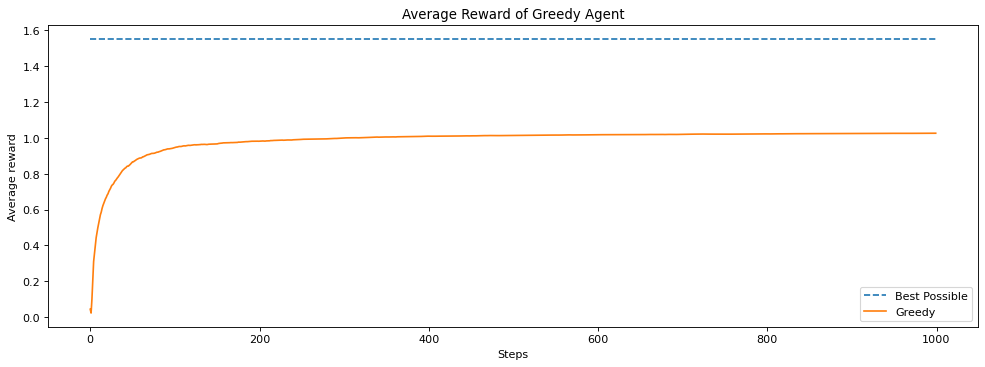

In [130]:
# ---------------
# Discussion Cell
# ---------------

num_runs = 200                    # The number of times we run the experiment
num_steps = 1000                  # The number of pulls of each arm the agent takes
env = ten_arm_env.Environment     # We set what environment we want to use to test
agent = GreedyAgent               # We choose what agent we want to use
agent_info = {"num_actions": 10}  # We pass the agent the information it needs. Here how many arms there are.
env_info = {}                     # We pass the environment the information it needs. In this case nothing.

all_averages = []

average_best = 0
for run in tqdm(range(num_runs)):           # tqdm is what creates the progress bar below
    np.random.seed(run)
    
    rl_glue = RLGlue(env, agent)          # Creates a new RLGlue experiment with the env and agent we chose above
    rl_glue.rl_init(agent_info, env_info) # We pass RLGlue what it needs to initialize the agent and environment
    rl_glue.rl_start()                    # We start the experiment

    average_best += np.max(rl_glue.environment.arms)
    
    scores = [0]
    averages = []
    
    for i in range(num_steps):
        reward, _, action, _ = rl_glue.rl_step() # The environment and agent take a step and return
                                                 # the reward, and action taken.
        scores.append(scores[-1] + reward)
        averages.append(scores[-1] / (i + 1))
    all_averages.append(averages)

plt.figure(figsize=(15, 5), dpi= 80, facecolor='w', edgecolor='k')
plt.plot([average_best / num_runs for _ in range(num_steps)], linestyle="--")
plt.plot(np.mean(all_averages, axis=0))
plt.legend(["Best Possible", "Greedy"])
plt.title("Average Reward of Greedy Agent")
plt.xlabel("Steps")
plt.ylabel("Average reward")
plt.show()
greedy_scores = np.mean(all_averages, axis=0)

How did our agent do? Is it possible for it to do better?

## Section 2: Epsilon-Greedy Agent

We learned about [another way for an agent to operate](https://www.coursera.org/learn/fundamentals-of-reinforcement-learning/lecture/tHDck/what-is-the-trade-off), where it does not always take the greedy action. Instead, sometimes it takes an exploratory action. It does this so that it can find out what the best action really is. If we always choose what we think is the current best action is, we may miss out on taking the true best action, because we haven't explored enough times to find that best action.

Implement an epsilon-greedy agent below. Hint: we are implementing the algorithm from [section 2.4](http://www.incompleteideas.net/book/RLbook2018.pdf#page=52) of the textbook. You may want to use your greedy code from above and look at [np.random.random](https://docs.scipy.org/doc/numpy/reference/generated/numpy.random.random.html), as well as [np.random.randint](https://docs.scipy.org/doc/numpy/reference/generated/numpy.random.randint.html), to help you select random actions. 

In [219]:
# -----------
# Graded Cell
# -----------
class EpsilonGreedyAgent(main_agent.Agent):
    def agent_step(self, reward, observation):
        """
        Takes one step for the agent. It takes in a reward and observation and 
        returns the action the agent chooses at that time step.
        
        Arguments:
        reward -- float, the reward the agent recieved from the environment after taking the last action.
        observation -- float, the observed state the agent is in. Do not worry about this as you will not use it
                              until future lessons
        Returns:
        current_action -- int, the action chosen by the agent at the current time step.
        """
        
        ### Useful Class Variables ###
        # self.q_values : An array with what the agent believes each of the values of the arm are.
        # self.arm_count : An array with a count of the number of times each arm has been pulled.
        # self.last_action : The action that the agent took on the previous time step
        # self.epsilon : The probability an epsilon greedy agent will explore (ranges between 0 and 1)
        #######################
       

        # Update Q values - this should be the same update as your greedy agent above
        self.arm_count[self.last_action] += 1
        step_size = 1 / self.arm_count[self.last_action]
        self.q_values[self.last_action] = self.q_values[self.last_action] + step_size * (reward - self.q_values[self.last_action])

        # Choose action using epsilon greedy
        # Randomly choose a number between 0 and 1 and see if it's less than self.epsilon
        # (hint: look at np.random.random()). If it is, set current_action to a random action.
        # otherwise choose current_action greedily as you did above.
        
        if np.random.random(1) < self.epsilon:
            current_action = np.random.choice( range(len(self.arm_count)) )
        else:
            current_action = argmax(self.q_values)
        
        self.last_action = int(current_action)
        
        return current_action

In [220]:
# --------------
# Debugging Cell
# --------------
# Feel free to make any changes to this cell to debug your code

# build a fake agent for testing and set some initial conditions
np.random.seed(0)
e_greedy_agent = EpsilonGreedyAgent()
e_greedy_agent.q_values = [0, 0.0, 0.5, 0, 0]
e_greedy_agent.arm_count = [0, 1, 0, 0, 0]
e_greedy_agent.num_actions = 5
e_greedy_agent.last_action = 1
e_greedy_agent.epsilon = 0.5

# given this random seed, we should see a greedy action (action 2) here
action = e_greedy_agent.agent_step(reward=1, observation=0)

# -----------------------------------------------
# we'll try to guess a few of the trickier places
# -----------------------------------------------

# make sure to update for the *last_action* not the current action
assert e_greedy_agent.q_values != [0, 0.5, 1.0, 0, 0], "A"

# make sure the stepsize is based on the *last_action* not the current action
assert e_greedy_agent.q_values != [0, 1, 0.5, 0, 0], "B"

# make sure the agent is using the argmax that breaks ties randomly
assert action == 2, "C"

# -----------------------------------------------

# let's see what happens for another action
np.random.seed(1)
e_greedy_agent = EpsilonGreedyAgent()
e_greedy_agent.q_values = [0, 0.5, 0.5, 0, 0]
e_greedy_agent.arm_count = [0, 1, 0, 0, 0]
e_greedy_agent.num_actions = 5
e_greedy_agent.last_action = 1
e_greedy_agent.epsilon = 0.5

# given this random seed, we should see a random action (action 4) here
action = e_greedy_agent.agent_step(reward=1, observation=0)

# The agent saw a reward of 1, so should increase the value for *last_action*
assert e_greedy_agent.q_values == [0, 0.75, 0.5, 0, 0], "D"

# the agent should have picked a random action for this particular random seed
assert action == 4, "E"


[1, 2]


In [221]:
# -----------
# Tested Cell
# -----------
# The contents of the cell will be tested by the autograder.
# If they do not pass here, they will not pass there.

np.random.seed(0)
e_greedy_agent = EpsilonGreedyAgent()
e_greedy_agent.q_values = [0, 0, 1.0, 0, 0]
e_greedy_agent.arm_count = [0, 1, 0, 0, 0]
e_greedy_agent.num_actions = 5
e_greedy_agent.last_action = 1
e_greedy_agent.epsilon = 0.5
action = e_greedy_agent.agent_step(reward=1, observation=0)

assert e_greedy_agent.q_values == [0, 0.5, 1.0, 0, 0]

# manipulate the random seed so the agent takes a random action
np.random.seed(1)
action = e_greedy_agent.agent_step(reward=0, observation=0)

assert action == 4

# check to make sure we update value for action 4
action = e_greedy_agent.agent_step(reward=1, observation=0)
assert e_greedy_agent.q_values == [0, 0.5, 0.0, 0, 1.0]

[2]
[4]


Now that we have our epsilon greedy agent created. Let's compare it against the greedy agent with epsilon of 0.1.

  0%|          | 1/200 [00:00<00:29,  6.79it/s]

[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[1]
[6]
[6]
[6]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[3]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]


  1%|          | 2/200 [00:00<00:30,  6.46it/s]


[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]

  2%|▏         | 4/200 [00:00<00:30,  6.44it/s]

[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]


  2%|▎         | 5/200 [00:00<00:29,  6.58it/s]

[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[0]
[0]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[1]
[1]
[1]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[8]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[3]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]


  3%|▎         | 6/200 [00:00<00:30,  6.31it/s]


[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]

  4%|▎         | 7/200 [00:01<00:29,  6.51it/s]

[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]


  4%|▍         | 9/200 [00:01<00:31,  6.05it/s]

[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[8]
[8]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]


  5%|▌         | 10/200 [00:01<00:29,  6.45it/s]

[1, 9]
[9]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[5]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[1]
[1]
[1]
[1]
[1]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[

  6%|▌         | 11/200 [00:01<00:30,  6.21it/s]

[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]


  6%|▌         | 12/200 [00:01<00:29,  6.40it/s]

[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]


  7%|▋         | 14/200 [00:02<00:30,  6.03it/s]

[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[1]
[1]
[1]
[1]
[1]
[7]
[7]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]


  8%|▊         | 15/200 [00:02<00:29,  6.35it/s]

[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[5]
[0]
[0]


  8%|▊         | 16/200 [00:02<00:30,  6.03it/s]

[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[9]
[9]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]


  8%|▊         | 17/200 [00:02<00:31,  5.88it/s]

[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]


  9%|▉         | 18/200 [00:02<00:29,  6.21it/s]

[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]


 10%|█         | 20/200 [00:03<00:29,  6.03it/s]

[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[6]
[7]
[7]
[7]
[6]
[6]
[6]
[6]
[7]
[7]
[7]
[7]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[5]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]


 10%|█         | 21/200 [00:03<00:28,  6.24it/s]

[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[8]
[8]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]


 11%|█         | 22/200 [00:03<00:29,  6.01it/s]

[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]


 12%|█▏        | 23/200 [00:03<00:29,  5.96it/s]

[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[8]
[8]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[0, 1, 2, 3, 4, 6, 7, 8, 9]
[0, 1, 2, 4, 6, 7, 8, 9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]

 12%|█▎        | 25/200 [00:04<00:28,  6.05it/s]

[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[0, 2, 3, 4, 5, 6, 7, 8, 9]
[0, 2, 3, 4, 5, 6, 7, 9]
[4]
[0, 2, 3, 5, 6, 7, 9]
[3]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[

 13%|█▎        | 26/200 [00:04<00:27,  6.28it/s]

[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]


 14%|█▎        | 27/200 [00:04<00:28,  6.05it/s]

[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]


 14%|█▍        | 28/200 [00:04<00:28,  6.00it/s]

[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]


 15%|█▌        | 30/200 [00:04<00:27,  6.09it/s]

[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[4]
[8]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[8]
[8]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[8]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]


 16%|█▌        | 31/200 [00:05<00:28,  6.03it/s]

[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]


 16%|█▌        | 32/200 [00:05<00:26,  6.30it/s]

[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]


 16%|█▋        | 33/200 [00:05<00:27,  6.09it/s]

[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]


 18%|█▊        | 35/200 [00:05<00:26,  6.22it/s]

[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[9]
[9]
[9]
[8]
[8]
[9]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[1]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]


 18%|█▊        | 36/200 [00:05<00:26,  6.09it/s]

[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]


 18%|█▊        | 37/200 [00:05<00:25,  6.32it/s]

[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]


 20%|█▉        | 39/200 [00:06<00:24,  6.45it/s]

[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[0, 1, 2, 3, 4, 5, 6, 8, 9]
[9]
[0, 1, 2, 3, 4, 5, 6, 8]
[6]
[3]
[3]

 20%|██        | 40/200 [00:06<00:26,  6.13it/s]

[0, 2, 3, 4, 5, 6, 7, 8, 9]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[0]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]


 20%|██        | 41/200 [00:06<00:26,  6.09it/s]

[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]


 21%|██        | 42/200 [00:06<00:25,  6.22it/s]

[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]


 22%|██▏       | 43/200 [00:06<00:25,  6.05it/s]


[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]

 22%|██▎       | 45/200 [00:07<00:24,  6.32it/s]

[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[0, 1, 2, 3, 4, 6, 7, 8, 9]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[1]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[9]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]


 23%|██▎       | 46/200 [00:07<00:25,  6.10it/s]

[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]


 24%|██▎       | 47/200 [00:07<00:25,  5.99it/s]


[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]

 24%|██▍       | 48/200 [00:07<00:24,  6.25it/s]

[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]


 25%|██▌       | 50/200 [00:08<00:23,  6.33it/s]

[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[0, 1, 2, 3, 5, 6, 7, 8, 9]
[0, 1, 2, 3, 6, 7, 8, 9]
[6]
[6]
[6]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]

 26%|██▌       | 51/200 [00:08<00:24,  6.13it/s]

[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]


 26%|██▌       | 52/200 [00:08<00:24,  5.98it/s]

[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]


 26%|██▋       | 53/200 [00:08<00:23,  6.30it/s]

[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]


 28%|██▊       | 55/200 [00:08<00:22,  6.39it/s]

[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[2]
[2]
[2]
[0, 3, 4, 5, 6, 7, 8, 9]
[0, 3, 4, 5, 6, 8, 9]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[4]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[

 28%|██▊       | 56/200 [00:09<00:23,  6.12it/s]

[1]
[1]
[6]
[6]
[6]
[6]
[6]
[7]
[6]
[6]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]


 28%|██▊       | 57/200 [00:09<00:23,  6.03it/s]

[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]


 29%|██▉       | 58/200 [00:09<00:22,  6.34it/s]

[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]


 30%|███       | 60/200 [00:09<00:21,  6.46it/s]

[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]


 30%|███       | 61/200 [00:09<00:22,  6.14it/s]


[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[5]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]

 31%|███       | 62/200 [00:10<00:22,  6.02it/s]

[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]


 32%|███▏      | 64/200 [00:10<00:21,  6.25it/s]

[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[6]
[0, 1, 2, 3, 4, 5, 7, 8, 9]
[0, 1, 2, 3, 4, 5, 7, 9]
[1, 2, 3, 4, 5, 7, 9]
[3]
[3]
[3]
[1, 2, 4, 5, 7, 9]
[1, 4, 5, 7, 9]
[1, 4, 5, 7]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[

 32%|███▎      | 65/200 [00:10<00:22,  6.10it/s]

[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]


 33%|███▎      | 66/200 [00:10<00:21,  6.28it/s]

[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]


 34%|███▎      | 67/200 [00:10<00:21,  6.19it/s]

[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]


 34%|███▍      | 68/200 [00:11<00:21,  6.01it/s]

[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[0, 1, 2, 3, 5, 6, 7, 8, 9]
[5]
[5]
[0, 1, 2, 3, 6, 7, 8, 9]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[8]
[8]
[8]
[6]
[6]
[6]
[6]
[6]
[6]
[8]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]

 35%|███▌      | 70/200 [00:11<00:21,  6.05it/s]

[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[9]
[8]
[9]
[9]
[9]
[8]
[8]
[9]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[8]
[7]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[0]
[8]
[8]
[9]
[9]
[8]
[8]
[7]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]


 36%|███▌      | 71/200 [00:11<00:20,  6.33it/s]

[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]


 36%|███▌      | 72/200 [00:11<00:20,  6.20it/s]

[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]


 37%|███▋      | 74/200 [00:11<00:19,  6.32it/s]

[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[0, 1, 2, 3, 4, 6, 7, 8, 9]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]


 38%|███▊      | 75/200 [00:12<00:20,  6.07it/s]

[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[4]
[4]
[6]
[6]
[6]
[6]
[6]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[3]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[3]
[3]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]


 38%|███▊      | 76/200 [00:12<00:20,  5.97it/s]


[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]

 38%|███▊      | 77/200 [00:12<00:19,  6.27it/s]

[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[0]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]


 40%|███▉      | 79/200 [00:12<00:20,  5.98it/s]


[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[1, 2, 3, 4, 5, 6, 7, 8, 9]
[8]
[8]
[8]
[8]
[1, 2, 3, 4, 5, 6, 7, 9]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[9]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[7]
[7]
[7]
[7]
[7]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2

 40%|████      | 80/200 [00:12<00:19,  6.28it/s]

[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[8]
[8]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[9]
[9]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[5]
[5]
[5]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[5]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]


 40%|████      | 81/200 [00:13<00:19,  6.08it/s]

[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]


 41%|████      | 82/200 [00:13<00:18,  6.38it/s]

[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]


 42%|████▏     | 84/200 [00:13<00:19,  6.05it/s]


[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[2]
[2]
[2]
[2]
[2]
[2]
[6]
[6]
[6]
[2]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]

 42%|████▎     | 85/200 [00:13<00:18,  6.31it/s]

[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]


 43%|████▎     | 86/200 [00:13<00:18,  6.15it/s]

[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]


 44%|████▍     | 88/200 [00:14<00:18,  6.21it/s]

[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[0, 1, 3, 4, 5, 6, 7, 8, 9]
[0, 1, 3, 4, 6, 7, 8, 9]
[0, 1, 3, 4, 6, 7, 9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[

 44%|████▍     | 89/200 [00:14<00:17,  6.41it/s]

[0, 1, 2, 3, 4, 5, 6, 7, 8]
[0, 1, 2, 4, 5, 6, 7, 8]
[1, 2, 4, 5, 6, 7, 8]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[

 45%|████▌     | 90/200 [00:14<00:17,  6.15it/s]

[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]


 46%|████▌     | 91/200 [00:14<00:18,  6.05it/s]

[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[6]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]


 46%|████▌     | 92/200 [00:14<00:17,  6.32it/s]

[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]


 47%|████▋     | 94/200 [00:15<00:17,  6.02it/s]

[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]


 48%|████▊     | 95/200 [00:15<00:16,  6.32it/s]

[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]


 48%|████▊     | 96/200 [00:15<00:17,  6.10it/s]

[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]


 49%|████▉     | 98/200 [00:15<00:16,  6.22it/s]

[3]
[3]
[0]
[0]
[0]
[0]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[0]
[0]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[4]
[4]
[4]
[4]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]


 50%|████▉     | 99/200 [00:16<00:16,  6.13it/s]

[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[0]
[0]
[0]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]


 50%|█████     | 101/200 [00:16<00:13,  7.14it/s]

[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]


 52%|█████▏    | 103/200 [00:16<00:15,  6.17it/s]

[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0, 1, 2, 3, 4, 5, 6, 8, 9]
[0, 1, 2, 3, 4, 5, 6, 9]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]

 52%|█████▏    | 104/200 [00:16<00:16,  5.98it/s]

[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]


 52%|█████▎    | 105/200 [00:16<00:15,  6.22it/s]

[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]


 53%|█████▎    | 106/200 [00:17<00:15,  6.06it/s]

[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]


 54%|█████▍    | 108/200 [00:17<00:14,  6.17it/s]

[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0, 1, 2, 3, 4, 5, 6, 7, 8]
[0, 1, 2, 3, 4, 5, 7, 8]
[8]
[0]
[8]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[3]
[0]
[0]
[8]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]

 55%|█████▍    | 109/200 [00:17<00:15,  6.05it/s]

[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[3]
[3]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[3]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]


 55%|█████▌    | 110/200 [00:17<00:13,  6.50it/s]

[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]


 56%|█████▌    | 112/200 [00:18<00:13,  6.34it/s]

[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]


 56%|█████▋    | 113/200 [00:18<00:14,  6.17it/s]

[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[9]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]


 57%|█████▋    | 114/200 [00:18<00:14,  5.98it/s]

[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[1]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[1]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]


 57%|█████▊    | 115/200 [00:18<00:13,  6.30it/s]

[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]


 58%|█████▊    | 117/200 [00:18<00:13,  6.07it/s]

[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[0, 1, 2, 3, 4, 6, 7, 8, 9]
[0, 1, 2, 4, 6, 7, 8, 9]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[0, 1, 4, 6, 7, 8, 9]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[

 59%|█████▉    | 118/200 [00:19<00:13,  6.28it/s]

[6]
[6]
[6]
[6]
[6]
[6]
[7]
[7]
[7]
[7]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[7]
[7]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]


 60%|█████▉    | 119/200 [00:19<00:13,  6.07it/s]

[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]


 60%|██████    | 120/200 [00:19<00:12,  6.41it/s]

[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]


 61%|██████    | 122/200 [00:19<00:13,  5.97it/s]

[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]


 62%|██████▏   | 123/200 [00:19<00:12,  6.27it/s]

[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[4]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]


 62%|██████▏   | 124/200 [00:20<00:12,  5.88it/s]

[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]


 62%|██████▎   | 125/200 [00:20<00:12,  5.82it/s]

[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]


 64%|██████▎   | 127/200 [00:20<00:12,  6.04it/s]


[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[6]
[6]
[0, 1, 2, 3, 4, 5, 7, 8, 9]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[1, 2, 3, 4, 5, 7, 9]
[1, 2, 4, 5, 7, 9]
[1, 4, 5, 7, 9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[4]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9

 64%|██████▍   | 128/200 [00:20<00:12,  5.87it/s]

[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]


 64%|██████▍   | 129/200 [00:20<00:11,  6.24it/s]

[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]


 65%|██████▌   | 130/200 [00:21<00:11,  6.14it/s]

[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]


 66%|██████▌   | 132/200 [00:21<00:10,  6.22it/s]

[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[8]
[8]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]


 66%|██████▋   | 133/200 [00:21<00:11,  6.01it/s]

[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]


 67%|██████▋   | 134/200 [00:21<00:10,  6.36it/s]

[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]


 68%|██████▊   | 135/200 [00:21<00:10,  6.16it/s]

[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[0, 

 68%|██████▊   | 137/200 [00:22<00:10,  6.14it/s]

[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[0, 2, 3, 4, 5, 6, 7, 8, 9]
[8]
[0, 2, 3, 4, 5, 6, 7, 9]
[0, 3, 4, 5, 6, 7, 9]
[0, 3, 4, 6, 7, 9]
[9]
[9]
[0, 3, 4, 6, 7]
[0, 4, 6, 7]
[0]
[4, 6, 7]
[6]
[4, 7]
[4]
[9]
[8]
[1]
[1]
[8]
[8]
[1]
[1]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]


 69%|██████▉   | 138/200 [00:22<00:10,  5.99it/s]

[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]


 70%|██████▉   | 139/200 [00:22<00:10,  5.78it/s]

[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]


 70%|███████   | 140/200 [00:22<00:09,  6.19it/s]

[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]


 71%|███████   | 142/200 [00:22<00:09,  6.31it/s]

[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[0, 1, 2, 3, 5, 6, 7, 8, 9]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[1, 2, 3, 5, 6, 7, 8, 9]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[6]
[6]
[5]
[5]
[5]
[6]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]

 72%|███████▏  | 143/200 [00:23<00:09,  6.12it/s]

[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]


 72%|███████▏  | 144/200 [00:23<00:09,  5.84it/s]

[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]


 72%|███████▎  | 145/200 [00:23<00:08,  6.23it/s]

[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]


 74%|███████▎  | 147/200 [00:23<00:08,  5.93it/s]

[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]


 74%|███████▍  | 148/200 [00:23<00:08,  6.19it/s]

[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]


 74%|███████▍  | 149/200 [00:24<00:08,  6.03it/s]


[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[2]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[7]
[7]
[7]

 75%|███████▌  | 150/200 [00:24<00:08,  6.00it/s]

[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]


 76%|███████▌  | 152/200 [00:24<00:07,  6.03it/s]

[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[8]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[8]
[8]
[8]
[8]
[8]
[8]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[4]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]


 76%|███████▋  | 153/200 [00:24<00:07,  5.95it/s]

[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]


 77%|███████▋  | 154/200 [00:24<00:07,  6.24it/s]

[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]


 78%|███████▊  | 155/200 [00:25<00:07,  6.09it/s]

[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]


 78%|███████▊  | 157/200 [00:25<00:06,  6.18it/s]

[8]
[8]
[8]
[8]
[8]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[0, 1, 2, 3, 4, 5, 6, 7, 9]
[1, 2, 3, 4, 5, 6, 7, 9]
[3]
[1, 2, 4, 5, 6, 7, 9]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[

 79%|███████▉  | 158/200 [00:25<00:06,  6.43it/s]

[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]


 80%|███████▉  | 159/200 [00:25<00:06,  6.13it/s]

[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]


 80%|████████  | 160/200 [00:25<00:06,  6.01it/s]

[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]


 81%|████████  | 162/200 [00:26<00:06,  6.10it/s]

[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[0, 1, 2, 3, 4, 5, 7, 8, 9]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[1]
[1]
[7]
[7]
[1]
[1]
[1]
[1]
[1]
[1]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[1]
[1]
[7]
[2]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]


 82%|████████▏ | 163/200 [00:26<00:06,  5.95it/s]

[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[8]
[8]
[0]
[8]
[0]
[0]
[0]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[7]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]


 82%|████████▏ | 164/200 [00:26<00:05,  6.40it/s]

[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]


 82%|████████▎ | 165/200 [00:26<00:05,  6.19it/s]

[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]


 84%|████████▎ | 167/200 [00:27<00:05,  6.22it/s]

[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[0, 1, 3, 4, 5, 6, 7, 8, 9]
[0, 1, 3, 4, 5, 6, 8, 9]
[0, 1, 3, 4, 5, 6, 9]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[

 84%|████████▍ | 168/200 [00:27<00:05,  6.02it/s]

[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[7]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]


 84%|████████▍ | 169/200 [00:27<00:04,  6.21it/s]

[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]


 85%|████████▌ | 170/200 [00:27<00:04,  6.05it/s]

[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]


 86%|████████▌ | 172/200 [00:27<00:04,  6.27it/s]

[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[0, 1, 2, 3, 4, 5, 6, 7, 9]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[9]
[9]
[9]
[9]
[9]
[7]
[7]
[7]
[7]
[7]
[7]
[7]
[2]
[2]
[2]
[2]
[7]
[7]
[7]
[7]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]


 86%|████████▋ | 173/200 [00:28<00:04,  5.96it/s]

[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[0]
[0]
[0]
[9]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[9]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]


 87%|████████▋ | 174/200 [00:28<00:04,  6.07it/s]

[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]


 88%|████████▊ | 176/200 [00:28<00:03,  6.15it/s]


[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[1]
[3]
[3]
[3]
[3]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]

 88%|████████▊ | 177/200 [00:28<00:03,  6.45it/s]

[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]


 89%|████████▉ | 178/200 [00:28<00:03,  6.22it/s]

[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[9]
[9]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]


 90%|█████████ | 180/200 [00:29<00:03,  6.67it/s]

[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[9]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[9]
[9]
[9]
[9]
[9]
[9]
[3]
[3]
[3]
[3]
[3]
[3]
[3]


 90%|█████████ | 181/200 [00:29<00:03,  6.16it/s]


[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[5]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]

 91%|█████████ | 182/200 [00:29<00:02,  6.26it/s]

[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]


 92%|█████████▏| 184/200 [00:29<00:02,  6.07it/s]

[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[4]
[4]
[4]
[4]
[4]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[4]
[4]
[4]
[4]
[4]
[4]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[2]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]


 92%|█████████▎| 185/200 [00:29<00:02,  6.29it/s]

[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]


 93%|█████████▎| 186/200 [00:30<00:02,  6.11it/s]

[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]


 94%|█████████▎| 187/200 [00:30<00:02,  6.45it/s]

[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]


 94%|█████████▍| 189/200 [00:30<00:01,  6.53it/s]

[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[5]
[5]
[3]
[5]
[5]
[3]
[3]
[3]
[3]
[3]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[8]
[8]
[8]
[8]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]
[9]


 95%|█████████▌| 190/200 [00:30<00:01,  6.19it/s]

[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[3]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]


 96%|█████████▌| 191/200 [00:30<00:01,  6.06it/s]

[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]


 96%|█████████▌| 192/200 [00:31<00:01,  6.33it/s]

[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]


 97%|█████████▋| 194/200 [00:31<00:00,  6.05it/s]

[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[0, 2, 3, 4, 5, 6, 7, 8, 9]
[0, 2, 3, 4, 5, 6, 7, 8]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]
[0]

 98%|█████████▊| 195/200 [00:31<00:00,  6.22it/s]

[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[1]


 98%|█████████▊| 197/200 [00:31<00:00,  6.24it/s]


[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]

 99%|█████████▉| 198/200 [00:32<00:00,  6.11it/s]

[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[3]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]
[8]


100%|█████████▉| 199/200 [00:32<00:00,  6.02it/s]

[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]


100%|██████████| 200/200 [00:32<00:00,  6.18it/s]


[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]
[2]


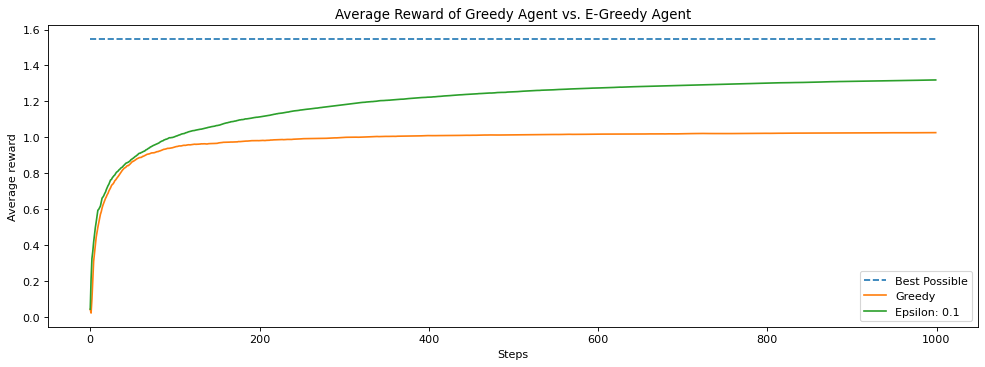

In [222]:
# ---------------
# Discussion Cell
# ---------------

# Plot Epsilon greedy results and greedy results
num_runs = 200
num_steps = 1000
epsilon = 0.1
agent = EpsilonGreedyAgent
env = ten_arm_env.Environment
agent_info = {"num_actions": 10, "epsilon": epsilon}
env_info = {}
all_averages = []

for run in tqdm(range(num_runs)):
    np.random.seed(run)
    
    rl_glue = RLGlue(env, agent)
    rl_glue.rl_init(agent_info, env_info)
    rl_glue.rl_start()

    scores = [0]
    averages = []
    for i in range(num_steps):
        reward, _, action, _ = rl_glue.rl_step() # The environment and agent take a step and return
                                                 # the reward, and action taken.
        scores.append(scores[-1] + reward)
        averages.append(scores[-1] / (i + 1))
    all_averages.append(averages)

plt.figure(figsize=(15, 5), dpi= 80, facecolor='w', edgecolor='k')
plt.plot([1.55 for _ in range(num_steps)], linestyle="--")
plt.plot(greedy_scores)
plt.title("Average Reward of Greedy Agent vs. E-Greedy Agent")
plt.plot(np.mean(all_averages, axis=0))
plt.legend(("Best Possible", "Greedy", "Epsilon: 0.1"))
plt.xlabel("Steps")
plt.ylabel("Average reward")
plt.show()

Notice how much better the epsilon-greedy agent did. Because we occasionally choose a random action we were able to find a better long term policy. By acting greedily before our value estimates are accurate, we risk settling on a suboptimal action.

## Section 2.1 Averaging Multiple Runs

Did you notice that we averaged over 200 runs? Why did we do that?

To get some insight, let's look at the results of two individual runs by the same agent.

[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[6]
[1]
[6]
[6]
[6]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[3]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]
[4]


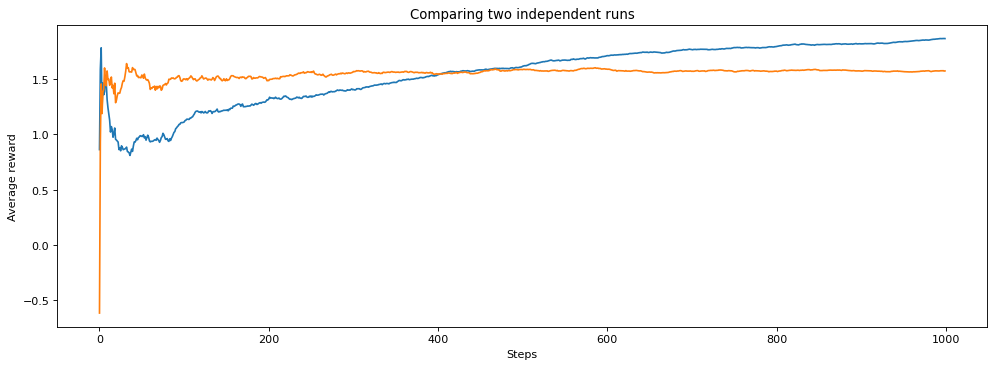

In [223]:
# ---------------
# Discussion Cell
# ---------------

# Plot runs of e-greedy agent
agent = EpsilonGreedyAgent
env = ten_arm_env.Environment
agent_info = {"num_actions": 10, "epsilon": 0.1}
env_info = {}
all_averages = []
plt.figure(figsize=(15, 5), dpi= 80, facecolor='w', edgecolor='k')
num_steps = 1000

for run in (0, 1):
    np.random.seed(run) # Here we set the seed so that we can compare two different runs
    averages = []
    rl_glue = RLGlue(env, agent)
    rl_glue.rl_init(agent_info, env_info)
    rl_glue.rl_start()

    scores = [0]
    for i in range(num_steps):
        reward, state, action, is_terminal = rl_glue.rl_step()
        scores.append(scores[-1] + reward)
        averages.append(scores[-1] / (i + 1))
    
    plt.plot(averages)

plt.title("Comparing two independent runs")
plt.xlabel("Steps")
plt.ylabel("Average reward")
plt.show()

Notice how the two runs were different? But, if this is the exact same algorithm, why does it behave differently in these two runs?

The answer is that it is due to randomness in the environment and in the agent. Depending on what action the agent randomly starts with, or when it randomly chooses to explore, it can change the results of the runs. And even if the agent chooses the same action, the reward from the environment is randomly sampled from a Gaussian. The agent could get lucky, and see larger rewards for the best action early on and so settle on the best action faster. Or, it could get unlucky and see smaller rewards for best action early on and so take longer to recognize that it is in fact the best action.

To be more concrete, let’s look at how many times an exploratory action is taken, for different seeds. 

In [225]:
# ---------------
# Discussion Cell
# ---------------
print("Random Seed 1")
np.random.seed(1)
for _ in range(15):
    if np.random.random() < 0.1:
        print("Exploratory Action")
    

print()
print()

print("Random Seed 2")
np.random.seed(2)
for _ in range(15):
    if np.random.random() < 0.1:
        print("Exploratory Action")

Random Seed 1
Exploratory Action
Exploratory Action
Exploratory Action


Random Seed 2
Exploratory Action


With the first seed, we take an exploratory action three times out of 15, but with the second, we only take an exploratory action once. This can significantly affect the performance of our agent because the amount of exploration has changed significantly.

To compare algorithms, we therefore report performance averaged across many runs. We do this to ensure that we are not simply reporting a result that is due to stochasticity, as explained [in the lectures](https://www.coursera.org/learn/fundamentals-of-reinforcement-learning/lecture/PtVBs/sequential-decision-making-with-evaluative-feedback). Rather, we want statistically significant outcomes. We will not use statistical significance tests in this course. Instead, because we have access to simulators for our experiments, we use the simpler strategy of running for a large number of runs and ensuring that the confidence intervals do not overlap. 

## Section 3: Comparing values of epsilon

Can we do better than an epsilon of 0.1? Let's try several different values for epsilon and see how they perform. We try different settings of key performance parameters to understand how the agent might perform under different conditions.

Below we run an experiment where we sweep over different values for epsilon:

100%|██████████| 200/200 [00:06<00:00, 29.03it/s]


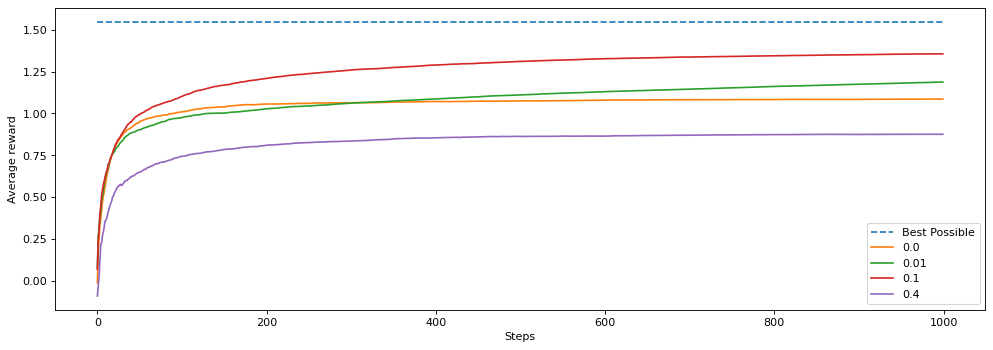

In [230]:
# ---------------
# Discussion Cell
# ---------------

# Experiment code for different e-greedy
epsilons = [0.0, 0.01, 0.1, 0.4]

plt.figure(figsize=(15, 5), dpi= 80, facecolor='w', edgecolor='k')
plt.plot([1.55 for _ in range(num_steps)], linestyle="--")

n_q_values = []
n_averages = []
n_best_actions = []

num_runs = 200

for epsilon in epsilons:
    all_averages = []
    for run in tqdm(range(num_runs)):
        agent = EpsilonGreedyAgent
        agent_info = {"num_actions": 10, "epsilon": epsilon}
        env_info = {"random_seed": run}

        rl_glue = RLGlue(env, agent)
        rl_glue.rl_init(agent_info, env_info)
        rl_glue.rl_start()
        
        best_arm = np.argmax(rl_glue.environment.arms)

        scores = [0]
        averages = []
        best_action_chosen = []
        
        for i in range(num_steps):
            reward, state, action, is_terminal = rl_glue.rl_step()
            scores.append(scores[-1] + reward)
            averages.append(scores[-1] / (i + 1))
            if action == best_arm:
                best_action_chosen.append(1)
            else:
                best_action_chosen.append(0)
            if epsilon == 0.1 and run == 0:
                n_q_values.append(np.copy(rl_glue.agent.q_values))
        if epsilon == 0.1:
            n_averages.append(averages)
            n_best_actions.append(best_action_chosen)
        all_averages.append(averages)
        
    plt.plot(np.mean(all_averages, axis=0))

plt.legend(["Best Possible"] + epsilons)
plt.xlabel("Steps")
plt.ylabel("Average reward")
plt.show()

Why did 0.1 perform better than 0.01?

If exploration helps why did 0.4 perform worse that 0.0 (the greedy agent)?

Think about these and how you would answer these questions. They are questions in the practice quiz. If you still have questions about it, retake the practice quiz.

## Section 4: The Effect of Step Size

In Section 1 of this assignment, we decayed the step size over time based on action-selection counts. The step-size was 1/N(A), where N(A) is the number of times action A was selected. This is the same as computing a sample average. We could also set the step size to be a constant value, such as 0.1. What would be the effect of doing that? And is it better to use a constant or the sample average method? 

To investigate this question, let’s start by creating a new agent that has a constant step size. This will be nearly identical to the agent created above. You will use the same code to select the epsilon-greedy action. You will change the update to have a constant step size instead of using the 1/N(A) update.

In [231]:
# -----------
# Graded Cell
# -----------
class EpsilonGreedyAgentConstantStepsize(main_agent.Agent):
    def agent_step(self, reward, observation):
        """
        Takes one step for the agent. It takes in a reward and observation and 
        returns the action the agent chooses at that time step.
        
        Arguments:
        reward -- float, the reward the agent recieved from the environment after taking the last action.
        observation -- float, the observed state the agent is in. Do not worry about this as you will not use it
                              until future lessons
        Returns:
        current_action -- int, the action chosen by the agent at the current time step.
        """
        
        ### Useful Class Variables ###
        # self.q_values : An array with what the agent believes each of the values of the arm are.
        # self.arm_count : An array with a count of the number of times each arm has been pulled.
        # self.last_action : An int of the action that the agent took on the previous time step.
        # self.step_size : A float which is the current step size for the agent.
        # self.epsilon : The probability an epsilon greedy agent will explore (ranges between 0 and 1)
        #######################
        
        # Update q_values for action taken at previous time step 
        # using self.step_size intead of using self.arm_count
        # YOUR CODE HERE
        self.q_values[self.last_action] = self.q_values[self.last_action] + self.step_size * (reward - self.q_values[self.last_action])
    
        
        # Choose action using epsilon greedy. This is the same as you implemented above.
        if np.random.random(1) < self.epsilon:
            current_action = np.random.choice(range(len(self.arm_count)))
        else:
            current_action = argmax(self.q_values)
        
        
        self.last_action = current_action
        
        return current_action

In [232]:
# --------------
# Debugging Cell
# --------------
# Feel free to make any changes to this cell to debug your code

for step_size in [0.01, 0.1, 0.5, 1.0]:
    e_greedy_agent = EpsilonGreedyAgentConstantStepsize()
    e_greedy_agent.q_values = [0, 0, 1.0, 0, 0]
    e_greedy_agent.num_actions = 5
    e_greedy_agent.last_action = 1
    e_greedy_agent.epsilon = 0.0
    e_greedy_agent.step_size = step_size
    action = e_greedy_agent.agent_step(1, 0)
    assert e_greedy_agent.q_values == [0, step_size, 1.0, 0, 0], "Check that you are updating q_values correctly using the stepsize."

In [233]:
# -----------
# Tested Cell
# -----------
# The contents of the cell will be tested by the autograder.
# If they do not pass here, they will not pass there.

np.random.seed(0)
# Check Epsilon Greedy with Different Constant Stepsizes
for step_size in [0.01, 0.1, 0.5, 1.0]:
    e_greedy_agent = EpsilonGreedyAgentConstantStepsize()
    e_greedy_agent.q_values = [0, 0, 1.0, 0, 0]
    e_greedy_agent.num_actions = 5
    e_greedy_agent.last_action = 1
    e_greedy_agent.epsilon = 0.0
    e_greedy_agent.step_size = step_size
    
    action = e_greedy_agent.agent_step(1, 0)
    
    assert e_greedy_agent.q_values == [0, step_size, 1.0, 0, 0]    

100%|██████████| 200/200 [00:06<00:00, 29.03it/s]


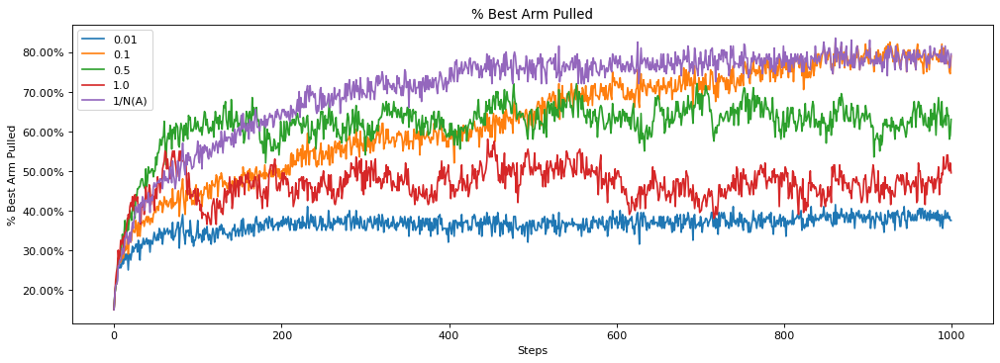

In [234]:
# ---------------
# Discussion Cell
# ---------------

# Experiment code for different step sizes
step_sizes = [0.01, 0.1, 0.5, 1.0, '1/N(A)']

epsilon = 0.1
num_steps = 1000
num_runs = 200

fig, ax = plt.subplots(figsize=(15, 5), dpi= 80, facecolor='w', edgecolor='k')

q_values = {step_size: [] for step_size in step_sizes}
true_values = {step_size: None for step_size in step_sizes}
best_actions = {step_size: [] for step_size in step_sizes}

for step_size in step_sizes:
    all_averages = []
    for run in tqdm(range(num_runs)):
        np.random.seed(run)
        agent = EpsilonGreedyAgentConstantStepsize if step_size != '1/N(A)' else EpsilonGreedyAgent
        agent_info = {"num_actions": 10, "epsilon": epsilon, "step_size": step_size, "initial_value": 0.0}
        env_info = {}

        rl_glue = RLGlue(env, agent)
        rl_glue.rl_init(agent_info, env_info)
        rl_glue.rl_start()
        
        best_arm = np.argmax(rl_glue.environment.arms)

        scores = [0]
        averages = []
        
        if run == 0:
            true_values[step_size] = np.copy(rl_glue.environment.arms)
            
        best_action_chosen = []
        for i in range(num_steps):
            reward, state, action, is_terminal = rl_glue.rl_step()
            scores.append(scores[-1] + reward)
            averages.append(scores[-1] / (i + 1))
            if action == best_arm:
                best_action_chosen.append(1)
            else:
                best_action_chosen.append(0)
            if run == 0:
                q_values[step_size].append(np.copy(rl_glue.agent.q_values))
        best_actions[step_size].append(best_action_chosen)
    ax.plot(np.mean(best_actions[step_size], axis=0))

plt.legend(step_sizes)
plt.title("% Best Arm Pulled")
plt.xlabel("Steps")
plt.ylabel("% Best Arm Pulled")
vals = ax.get_yticks()
ax.set_yticklabels(['{:,.2%}'.format(x) for x in vals])
plt.show()

Notice first that we are now plotting the amount of time that the best action is taken rather than the average reward. To better  understand the performance of an agent, it can be useful to measure specific behaviors, beyond just how much reward is accumulated. This measure indicates how close the agent’s behaviour is to optimal.

It seems as though 1/N(A) performed better than the others, in that it reaches a solution where it takes the best action most frequently. Now why might this be? Why did a step size of 0.5 start out better but end up performing worse? Why did a step size of 0.01 perform so poorly?

Let's dig into this further below. Let’s plot how well each agent tracks the true value, where each agent has a different step size method. You do not have to enter any code here, just follow along.

In [ ]:
# lock
# ---------------
# Discussion Cell
# ---------------
largest = 0
num_steps = 1000
for step_size in step_sizes:
    plt.figure(figsize=(15, 5), dpi= 80, facecolor='w', edgecolor='k')
    largest = np.argmax(true_values[step_size])
    plt.plot([true_values[step_size][largest] for _ in range(num_steps)], linestyle="--")
    plt.title("Step Size: {}".format(step_size))
    plt.plot(np.array(q_values[step_size])[:, largest])
    plt.legend(["True Expected Value", "Estimated Value"])
    plt.xlabel("Steps")
    plt.ylabel("Value")
    plt.show()

These plots help clarify the performance differences between the different step sizes. A step size of 0.01 makes such small updates that the agent’s value estimate of the best action does not get close to the actual value. Step sizes of 0.5 and 1.0 both get close to the true value quickly, but are very susceptible to stochasticity in the rewards. The updates overcorrect too much towards recent rewards, and so oscillate around the true value. This means that on many steps, the action that pulls the best arm may seem worse than it actually is.  A step size of 0.1 updates fairly quickly to the true value, and does not oscillate as widely around the true values as 0.5 and 1.0. This is one of the reasons that 0.1 performs quite well. Finally we see why 1/N(A) performed well. Early on while the step size is still reasonably high it moves quickly to the true expected value, but as it gets pulled more its step size is reduced which makes it less susceptible to the stochasticity of the rewards.

Does this mean that 1/N(A) is always the best? When might it not be? One possible setting where it might not be as effective is in non-stationary problems. You learned about non-stationarity in the lessons. Non-stationarity means that the environment may change over time. This could manifest itself as continual change over time of the environment, or a sudden change in the environment.

Let's look at how a sudden change in the reward distributions affects a step size like 1/N(A). This time we will run the environment for 2000 steps, and after 1000 steps we will randomly change the expected value of all of the arms. We compare two agents, both using epsilon-greedy with epsilon = 0.1. One uses a constant step size of 0.1, the other a step size of 1/N(A) that reduces over time. 

In [ ]:
# ---------------
# Discussion Cell
# ---------------
epsilon = 0.1
num_steps = 2000
num_runs = 200
step_size = 0.1

plt.figure(figsize=(15, 5), dpi= 80, facecolor='w', edgecolor='k')
plt.plot([1.55 for _ in range(num_steps)], linestyle="--")

for agent in [EpsilonGreedyAgent, EpsilonGreedyAgentConstantStepsize]:
    all_averages = []
    for run in tqdm(range(num_runs)):
        agent_info = {"num_actions": 10, "epsilon": epsilon, "step_size": step_size}
        np.random.seed(run)
        
        rl_glue = RLGlue(env, agent)
        rl_glue.rl_init(agent_info, env_info)
        rl_glue.rl_start()

        scores = [0]
        averages = []
        
        for i in range(num_steps):
            reward, state, action, is_terminal = rl_glue.rl_step()
            scores.append(scores[-1] + reward)
            averages.append(scores[-1] / (i + 1))
            if i == 1000:
                rl_glue.environment.arms = np.random.randn(10)
        all_averages.append(averages)
        
    plt.plot(np.mean(all_averages, axis=0))
plt.legend(["Best Possible", "1/N(A)", "0.1"])
plt.xlabel("Steps")
plt.ylabel("Average reward")
plt.show()

Now the agent with a step size of 1/N(A) performed better at the start but then performed worse when the environment changed! What happened?

Think about what the step size would be after 1000 steps. Let's say the best action gets chosen 500 times. That means the step size for that action is 1/500 or 0.002. At each step when we update the value of the action and the value is going to move only 0.002 * the error. That is a very tiny adjustment and it will take a long time for it to get to the true value.

The agent with step size 0.1, however, will always update in 1/10th of the direction of the error. This means that on average it will take ten steps for it to update its value to the sample mean.

These are the types of tradeoffs we have to think about in reinforcement learning. A larger step size moves us more quickly toward the true value, but can make our estimated values oscillate around the expected value. A step size that reduces over time can converge to close to the expected value, without oscillating. On the other hand, such a decaying stepsize is not able to adapt to changes in the environment. Nonstationarity---and the related concept of partial observability---is a common feature of reinforcement learning problems and when learning online.  

## Section 5: Conclusion

Great work! You have:
- Implemented your first agent
- Learned about the effect of epsilon, an exploration parameter, on the performance of an agent
- Learned about the effect of step size on the performance of the agent
- Learned about a good experiment practice of averaging across multiple runs